The goal of this notebook is to analyze the difference between air temperature via satellital images and in-situ measuring devices

In [1]:
from functions import *

2024-11-29 15:19:31.664490: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-11-29 15:19:31.684590: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-11-29 15:19:31.690849: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-11-29 15:19:31.706697: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-11-29 15:19:32.875059: W tensorflow/compiler/tf2

In [2]:
import numpy as np
import rasterio
import matplotlib.pyplot as plt
import os
import rasterio
import glob
from skimage.transform import resize
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
import pandas as pd
import geopandas as gpd
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
import pyproj
from geopandas.tools import sjoin
from shapely.geometry import Point,box
import requests
from scipy.stats import ks_2samp
from sklearn.preprocessing import OneHotEncoder
import time
from datetime import datetime
from collections import Counter
import matplotlib.patches as patches
import seaborn as sns
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from rasterio.transform import from_bounds
from rasterio.features import rasterize
from pyproj import Transformer
import contextily as ctx

#### Load data

In [5]:
W=128
inputs = ['lst','ndvi','altitude', 'slope','direction']
split = 'random'
filter_alt = False

if W==128:
    data_folder = '../data/preprocessed_test/'
else:
    data_folder = '../data/preprocessed_test/64x64/'

data = load_all_data(
    source_folder='../data/external/shp/river_cells_oficial',
    source_path=data_folder,
    data_paths= inputs,
    filter_altitude=filter_alt,
    W=W,
    time_split=True if split=='time' else False)

lst : (1378, 128, 128, 3)
ndvi : (1378, 128, 128)
altitude: (1378, 128, 128)
slope: (1378, 128, 128)
direction: (1378, 128, 128)


In [6]:
total_data, total_times, data_targets, labels = data

#### Load rivers

In [6]:
import os
import fiona
import geopandas as gpd
from shapely.geometry import shape
import matplotlib.pyplot as plt
from shapely.ops import unary_union

river_cells = {}
output_directory = '../data/external/shp/river_cells_oficial'
a=0

for i,riv in enumerate(os.listdir(output_directory)):
    # Check if the file is a shapefile
    try:
        if riv.endswith('.shp'):
            a+=1
            print(f"Processing file: {riv}")
            river = gpd.read_file(os.path.join(output_directory, riv))
            river = river.to_crs("EPSG:4326")
            river_cells[riv.split('station_')[-1].split('.')[0]] = river
            print('Added', riv.split('station_')[-1].split('.')[0])

    except Exception as e:
        print(f"Error processing file: {riv}",e)
        pass

Processing file: station_cell_37.shp
Added cell_37
Processing file: station_cell_8.shp
Added cell_8
Processing file: station_cell_33.shp
Added cell_33
Processing file: station_cell_9.shp
Added cell_9
Processing file: station_cell_42.shp
Added cell_42
Processing file: station_cell_78.shp
Added cell_78
Processing file: station_cell_6.shp
Added cell_6
Processing file: station_cell_46.shp
Added cell_46
Processing file: station_cell_31.shp
Added cell_31
Processing file: station_cell_59.shp
Added cell_59
Processing file: station_cell_63.shp
Added cell_63
Processing file: station_cell_11.shp
Added cell_11
Processing file: station_cell_36.shp
Added cell_36
Processing file: station_cell_65.shp
Added cell_65
Processing file: station_cell_56.shp
Added cell_56
Processing file: station_cell_12.shp
Added cell_12
Processing file: station_cell_72.shp
Added cell_72
Processing file: station_cell_24.shp
Added cell_24
Processing file: station_cell_38.shp
Added cell_38
Processing file: station_cell_80.shp


## Data stats

In [6]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import re

# Sample data (simulated) since real data wasn't provided
data = {
    "label": labels[0:len(total_times['lst'])],
    "fecha": total_times['lst']
}
df = pd.DataFrame(data)
df['cell_num'] = df['label'].apply(lambda x: int(re.search(r'\d+', x).group()))

def categorize_season(date_str):
    month = int(date_str.split("-")[1])  # Extract month as integer
    if month in [12, 1, 2]:
        return "Winter"
    elif month in [6, 7, 8]:
        return "Summer"
    else:
        return "Spring-Autumn"

# Apply season categorization
df['season'] = df['fecha'].apply(categorize_season)

# Count frequency of labels and seasons
label_counts = df['label'].value_counts()
season_counts = df['season'].value_counts()

# Calculate top 20 most frequent cell numbers
cell_counts = df['cell_num'].value_counts().head(20)

# Plot for top 20 cell numbers
plt.figure(figsize=(10, 6))
cell_counts.plot(kind='bar', color="skyblue", edgecolor="black")
plt.title("Top 20 Cell Frequency")
plt.xlabel("Cell Numbers", fontsize=14)
plt.ylabel("Frequency", fontsize=14)
plt.xticks(rotation=45, ha="right")
plt.tight_layout()
plt.savefig("../plots/top_20_cell_frequency_low_alt.png")  # Save as PNG
plt.close()  # Close the plot to avoid overlap

# Plot for season frequency
plt.figure(figsize=(6, 6))
season_counts.plot(kind='bar', color="salmon", edgecolor="black")
plt.title("Frequency by Season")
plt.xlabel("Seasons", fontsize=14)
plt.ylabel("Frequency", fontsize=14)
plt.xticks(rotation=45, ha="right")
plt.tight_layout()
plt.savefig("../plots/season_frequency_low_alt.png")  # Save as PNG
plt.close()  # Close the plot


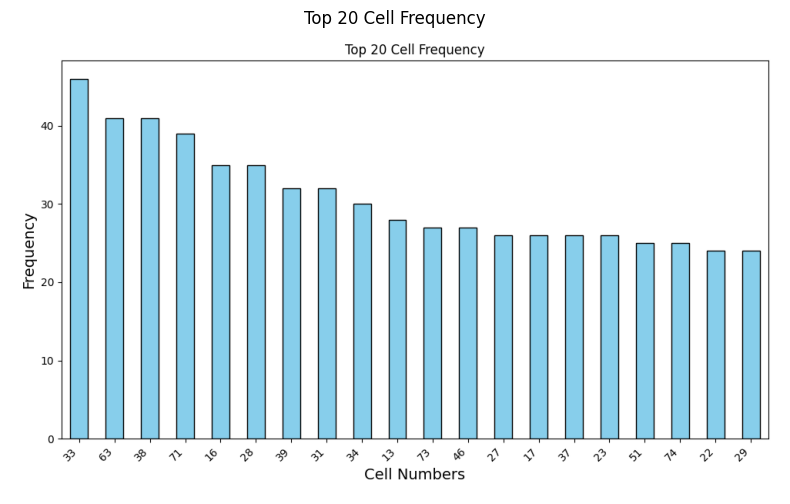

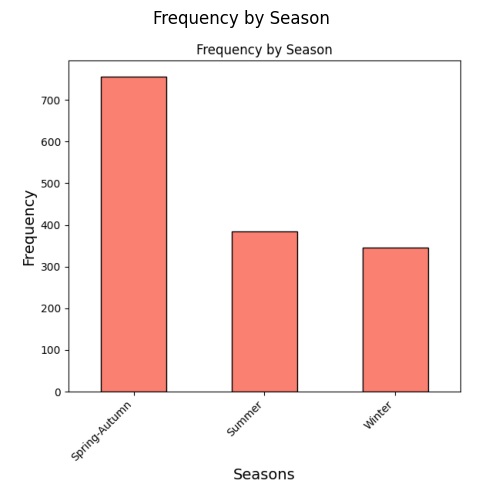

In [7]:
img1 = plt.imread("../plots/top_20_cell_frequency_low_alt.png")
plt.figure(figsize=(10, 6))
plt.imshow(img1)
plt.axis('off')  # Hide axis for a cleaner look
plt.title("Top 20 Cell Frequency")
plt.show()

# Load and display the season frequency chart
img2 = plt.imread("../plots/season_frequency_low_alt.png")
plt.figure(figsize=(6, 6))
plt.imshow(img2)
plt.axis('off')  # Hide axis for a cleaner look
plt.title("Frequency by Season")
plt.show()

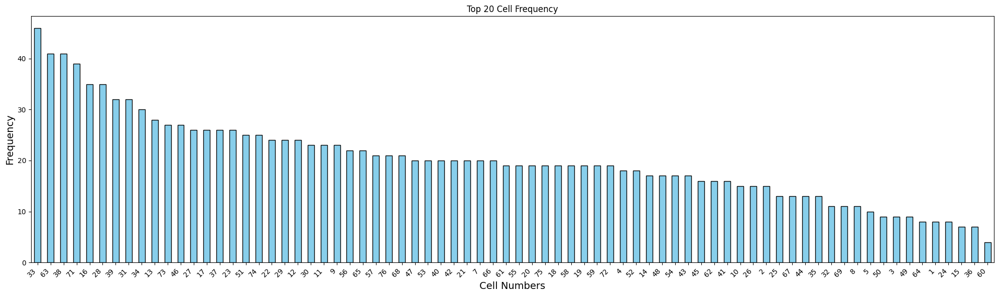

In [8]:
cell_counts = df['cell_num'].value_counts()

# Plot for top 20 cell numbers
plt.figure(figsize=(20, 6))
cell_counts.plot(kind='bar', color="skyblue", edgecolor="black")
plt.title("Top 20 Cell Frequency")
plt.xlabel("Cell Numbers", fontsize=14)
plt.ylabel("Frequency", fontsize=14)
plt.xticks(rotation=45, ha="right")
plt.tight_layout()


#### Frequency heatmap

In [20]:
def get_lat_lon(labels):
    file_path = '../data/raw/wt/cell_coordinates_oficial.csv'
    lat_lon = pd.read_csv(file_path)
    lats=[]
    lons=[]
    for label in labels:
        num_cell = int(label.split('_')[-1])
        lat = lat_lon[lat_lon.Cell==num_cell].Latitude.values[0]
        lon = lat_lon[lat_lon.Cell==num_cell].Longitude.values[0]
        lats.append(lat)
        lons.append(lon)
    lats = np.array(lats)
    lons = np.array(lons)
    return lats, lons

In [21]:
len(labels)

1487

In [22]:
lat, lon = get_lat_lon(labels)
merged_df = pd.DataFrame(data={'lat':list(lat),'lon':list(lon),'labels':labels})
merged_df

,lat,lon,labels
0,2501212,1115123.0,cell_67
1,2501212,1115123.0,cell_67
2,2501212,1115123.0,cell_67
3,2501212,1115123.0,cell_67
4,2501212,1115123.0,cell_67
...,...,...,...
1482,2749036,1244216.0,cell_24
1483,2749036,1244216.0,cell_24
1484,2749036,1244216.0,cell_24
1485,2749036,1244216.0,cell_24


In [23]:
frequency_df = merged_df.groupby(['lat', 'lon']).size().reset_index(name='frequency')

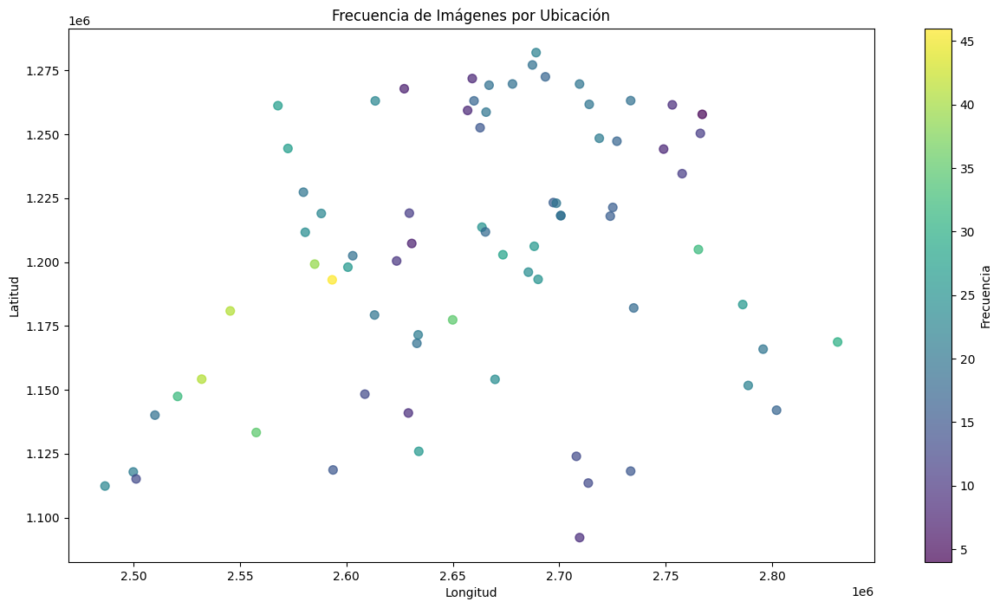

In [24]:
plt.figure(figsize=(15, 8))
plt.scatter(frequency_df['lat'], frequency_df['lon'], c=frequency_df['frequency'], cmap='viridis', s=50, alpha=0.7)
plt.colorbar(label="Frecuencia")
plt.title("Frecuencia de Imágenes por Ubicación")
plt.xlabel("Longitud")
plt.ylabel("Latitud")
plt.show()


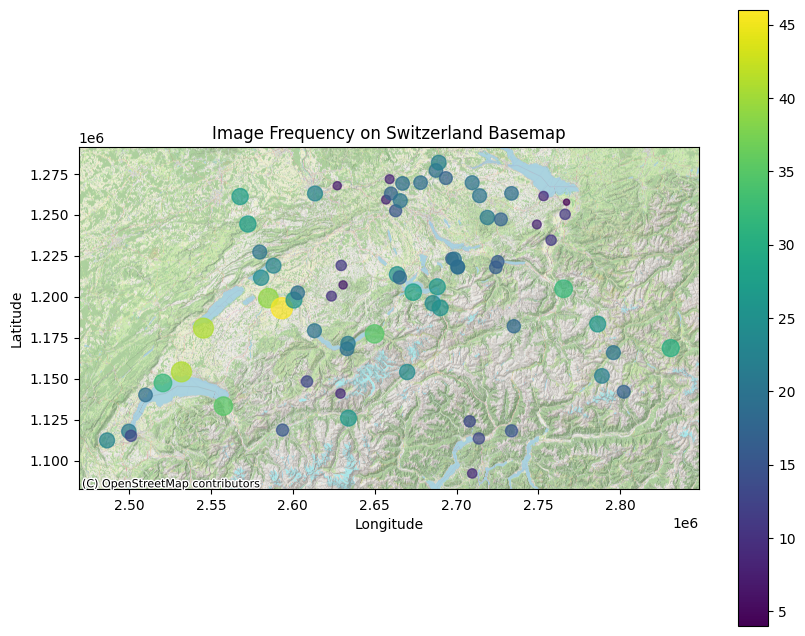

In [27]:
import geopandas as gpd
import contextily as ctx
import matplotlib.pyplot as plt

# Create the GeoDataFrame in EPSG:2056
gdf = gpd.GeoDataFrame(
    frequency_df, 
    geometry=gpd.points_from_xy(frequency_df.lat, frequency_df.lon), 
    crs="EPSG:2056"
)

# Convert to EPSG:4326 to use with contextily
gdf = gdf.to_crs(epsg=2056)

# Define an appropriate zoom level (e.g., zoom=12 or zoom=13 for regional detail)
zoom_level = 12

# Create the plot
fig, ax = plt.subplots(figsize=(10, 8))
gdf.plot(
    ax=ax,
    column='frequency',       # Use 'frequency' column for color mapping
    cmap='viridis',           # Color map for frequencies
    markersize=gdf['frequency'] * 5,  # Adjust marker size based on frequency
    legend=True,
    alpha=0.7
)

# Add the basemap with a fixed zoom level
ctx.add_basemap(ax, crs="EPSG:2056", source=ctx.providers.OpenStreetMap.CH, zoom=zoom_level)

# Add title and labels
ax.set_title("Image Frequency on Switzerland Basemap")
ax.set_xlabel("Longitude")
ax.set_ylabel("Latitude")

plt.show()


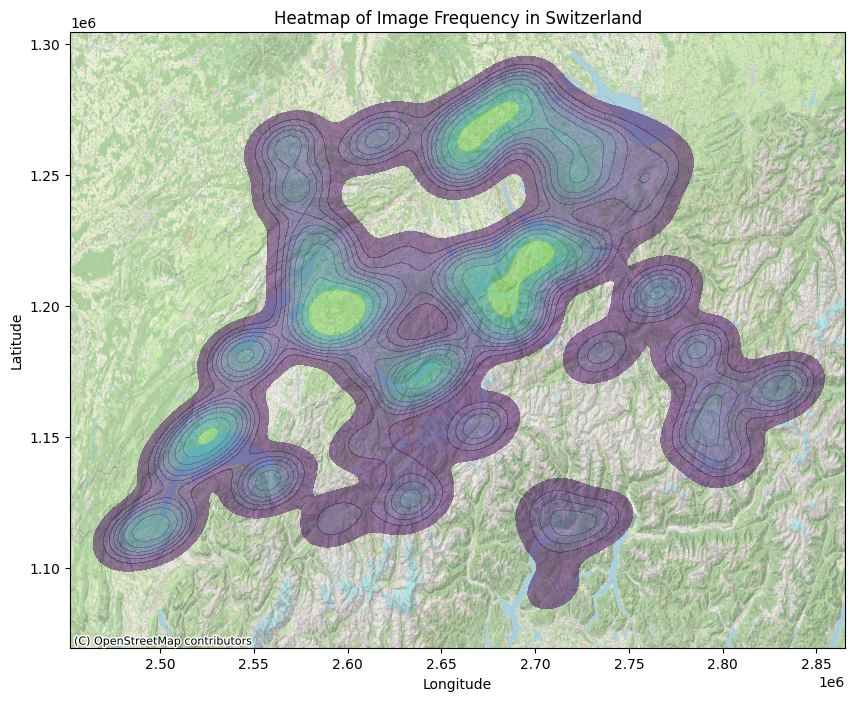

In [19]:
'''plt.figure(figsize=(10, 8))
sns.kdeplot(
    data=frequency_df,
    x='lat',
    y='lon',
    weights='frequency',
    cmap='viridis',
    fill=True,
    alpha=0.5,
    bw_adjust=0.3  # Reduce el bandwidth para mayor detalle
)
ctx.add_basemap(ax, crs="EPSG:2056", source=ctx.providers.OpenStreetMap.CH, zoom=zoom_level)

plt.title("Heatmap de Frecuencia de Imágenes en Suiza")
plt.xlabel("Longitud")
plt.ylabel("Latitud")
plt.show()'''
import geopandas as gpd
import contextily as ctx
import matplotlib.pyplot as plt
import seaborn as sns

# Convert coordinates to EPSG:4326 (latitude and longitude)
gdf = gpd.GeoDataFrame(
    frequency_df,
    geometry=gpd.points_from_xy(frequency_df.lat, frequency_df.lon),
    crs="EPSG:2056"
)
#gdf = gdf.to_crs(epsg=4326)

# Extract lat/lon and frequency for the KDE plot
frequency_df['lon'] = gdf.geometry.x
frequency_df['lat'] = gdf.geometry.y

# Create the plot
fig, ax = plt.subplots(figsize=(10, 8))

# KDE plot with frequency weights
sns.kdeplot(
    data=frequency_df,
    x='lon',
    y='lat',
    weights='frequency',
    cmap='viridis',
    fill=True,
    alpha=0.5,
    bw_adjust=0.3,  # Adjust bandwidth for more detail
    ax=ax
)

# Add the OpenStreetMap basemap with appropriate zoom level
ctx.add_basemap(ax, crs="EPSG:2056", source=ctx.providers.OpenStreetMap.CH, zoom=12)

# Add labels and title
ax.set_title("Heatmap of Image Frequency in Switzerland")
ax.set_xlabel("Longitude")
ax.set_ylabel("Latitude")

plt.show()



### Water temperature evolution

In [65]:
len(data_targets)

968

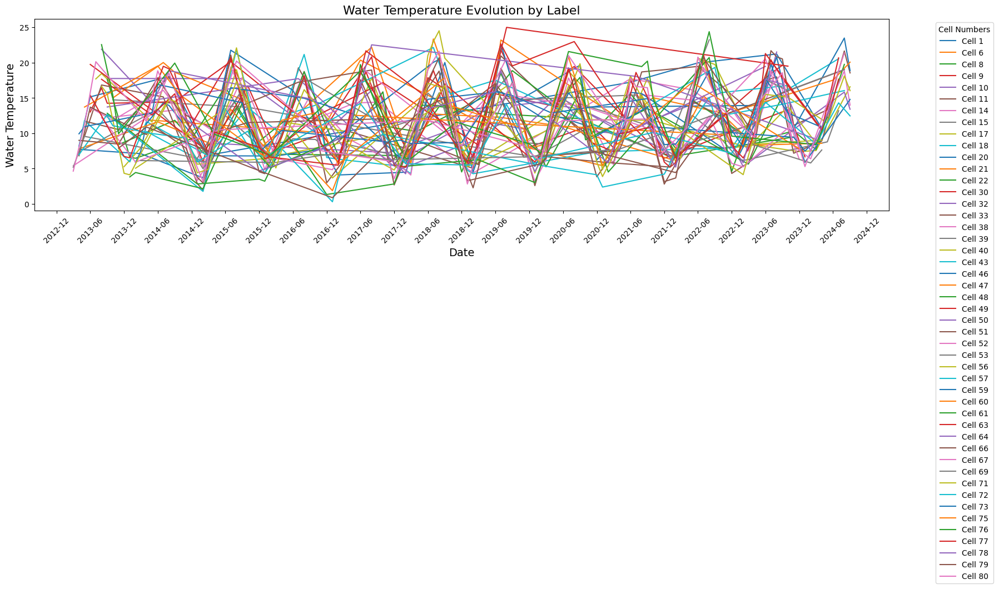

In [67]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import re
import matplotlib.dates as mdates

# Assuming your data includes temperature information alongside labels and dates
data = {
    "label": labels[0:len(total_times['lst'])],
    "fecha": total_times['lst'],
    "temperature": data_targets  # Add your list of water temperatures here
}
df = pd.DataFrame(data)
df['cell_num'] = df['label'].apply(lambda x: int(re.search(r'\d+', x).group()))

# Convert 'fecha' to datetime format
df['fecha'] = pd.to_datetime(df['fecha'], format="%Y-%m")

# Sort by label and date for proper plotting
df = df.sort_values(by=['cell_num', 'fecha'])

# Set the figure size to make the x-axis wider
plt.figure(figsize=(18, 8))

# Plot temperature evolution by label without resampling or interpolation
for cell_num, group in df.groupby('cell_num'):
    plt.plot(group['fecha'], group['temperature'], label=f'Cell {cell_num}')

# Set axis labels and title
plt.xlabel("Date", fontsize=18)
plt.ylabel("Water Temperature", fontsize=18)
plt.title("Water Temperature Evolution by Label", fontsize=16)

# Rotate x-axis labels to make dates readable
plt.xticks(rotation=45)

# Set x-axis to display dates every 6 months
plt.gca().xaxis.set_major_locator(mdates.MonthLocator(interval=6))
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter("%Y-%m"))

# Place the legend outside the plot for clarity
plt.legend(title="Cell Numbers", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()


### Variables Descriptive Analysis

In [134]:
for inp in inputs:  
    all_images = total_data[inp]  
    global_min = np.min(all_images)
    global_max = np.max(all_images)
    print(inp, global_min, global_max)
    

lst 0.0 255.0
ndvi -0.70130223 0.8880241
altitude -26.13751345141327 3429.550469263389
slope 0.2590800243037176 83.32514605484154
direction 0.9999999933474127 293.92089341053713


### LST evolution

In [12]:
lst_folder = '../data/preprocessed/ndvi'
W=128
cells_data={}
cells_times = {}
imgs_paths = [os.path.join(lst_folder,file) for file in os.listdir(lst_folder)]
list_rgb = [False] * len(imgs_paths)
data_ndvi, times_ndvi = load_data(imgs_paths, W, list_rgb)

In [13]:
lst_folder = '../data/preprocessed/lst'
W=128
cells_data={}
cells_times = {}
imgs_paths = [os.path.join(lst_folder,file) for file in os.listdir(lst_folder)]
list_rgb = [True] * len(imgs_paths)
data, times = load_data(imgs_paths, W, list_rgb)

In [33]:
discharge = get_discharge(labels, total_times['lst'])
lat, lon = get_lat_lon(labels)

In [10]:
img=data['../data/preprocessed/ndvi/cell_67'][0]
min_value = np.min(img)
max_value = np.max(img)

print(f"Range of values in the fourth channel: Min = {min_value}, Max = {max_value}")

Range of values in the fourth channel: Min = -0.4289381206035614, Max = 0.8689582347869873


In [31]:
def map_season(date):
    month = pd.to_datetime(date).month
    if month in [12, 1, 2]:
        return 'Winter'
    elif month in [3, 4, 5, 9, 10, 11]:
        return 'Spring-Autumn'
    elif month in [6, 7, 8]:
        return 'Summer'

mean_lst_values = []
mean_ndvi_values = []
labelss = [] 
for i,(k, imgs) in enumerate(data.items()):
    dates = []
    keyy = [key for key in data_ndvi.keys() if key.split('/')[-1] == k.split('/')[-1]]
    ndvi_cell = data_ndvi[keyy[0]]

    if len(imgs)>0:
        for j,img in enumerate(imgs):
            labelss.append(k.split('/')[-1])
            date = times[i][j]
            dates.append(date)
            
            mean_lst = np.mean(img)
            mean_lst_values.append(mean_lst)
            
            mean_ndvi = np.mean(ndvi_cell[j])
            mean_ndvi_values.append(mean_ndvi)

In [29]:
seasonal_data

,cell,season,mean_lst
0,cell_1,Spring-Autumn,36.436795
1,cell_1,Summer,35.524252
2,cell_10,Spring-Autumn,59.851349
3,cell_10,Summer,66.715098
4,cell_10,Winter,47.910858
...,...,...,...
213,cell_8,Summer,41.710425
214,cell_8,Winter,54.316178
215,cell_9,Spring-Autumn,53.961383
216,cell_9,Summer,35.329575


In [61]:
df = pd.DataFrame({
    'cell': labels,
    'date': total_times['lst'],
    'mean_lst': mean_lst_values,
    'mean_ndvi': mean_ndvi_values,
    'discharge': discharge,
    'lat': lat,
    'lon': lon
})

df['season'] = df['date'].apply(map_season)

seasonal_data = df.groupby(["cell", "season"])["mean_lst"].mean().reset_index()


In [50]:
a=gpd.read_file('../data/external/shp/ne_110m_admin_0_countries_lakes/ne_110m_admin_0_countries_lakes.shp')
a.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

<Axes: >

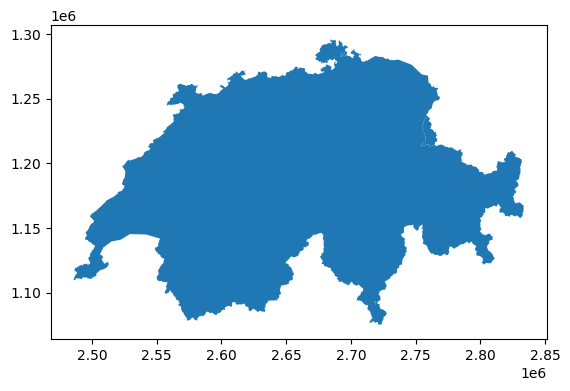

In [70]:
gpd.read_file('../data/external/shp/swiss_boundaries/swissBOUNDARIES3D_1_5_TLM_LANDESGEBIET.shp').plot()

         cell     date   mean_lst  mean_ndvi  discharge      lat        lon  \
0     cell_67  2013-08  80.465027   0.490384     87.216  2501212  1115123.0   
1     cell_67  2014-02  77.947497   0.270340     61.759  2501212  1115123.0   
2     cell_67  2015-05  63.592197   0.494099    192.179  2501212  1115123.0   
3     cell_67  2018-06  49.770430   0.438841     95.339  2501212  1115123.0   
4     cell_67  2020-03  43.846766   0.442441     96.676  2501212  1115123.0   
...       ...      ...        ...        ...        ...      ...        ...   
1482  cell_24  2017-06  25.677506   0.729083      3.643  2749036  1244216.0   
1483  cell_24  2021-04  62.599424   0.011613      2.128  2749036  1244216.0   
1484  cell_24  2021-05  61.741469   0.735135      6.727  2749036  1244216.0   
1485  cell_24  2021-12  15.344934   0.117413      0.465  2749036  1244216.0   
1486  cell_24  2024-09  41.186844   0.711481      2.784  2749036  1244216.0   

             season                 geometry  
0   

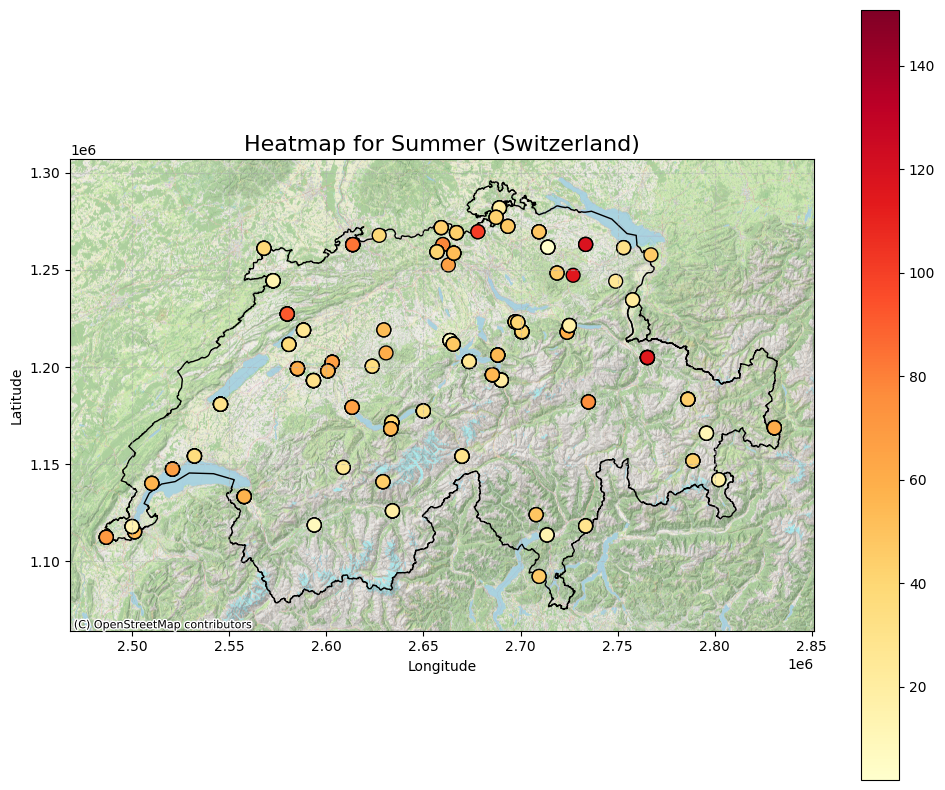

In [71]:
#transformer = Transformer.from_crs("EPSG:2056", "EPSG:4326", always_xy=True)
#df[['lon', 'lat']] = df.apply(lambda row: transformer.transform(row['lat'], row['lon']), axis=1, result_type="expand")

switzerland = gpd.read_file('../data/external/shp/swiss_boundaries/swissBOUNDARIES3D_1_5_TLM_LANDESGEBIET.shp')
#if "NAME" in switzerland.columns:
#    switzerland = switzerland[switzerland["NAME"] == "Switzerland"]

switzerland = switzerland.to_crs("EPSG:2056")

gdf_points = gpd.GeoDataFrame(
    df, geometry=gpd.points_from_xy(df['lat'], df['lon']), crs="EPSG:2056"
)

gdf_points = gdf_points.to_crs(epsg=2056)
print(gdf_points)
# Filtrar datos por estación
season_filter = "Summer"
gdf_filtered = gdf_points[gdf_points['season'] == season_filter]
zoom_level = 12
# Crear el mapa
fig, ax = plt.subplots(figsize=(12, 10))
switzerland.plot(ax=ax, color='none', edgecolor='black')  # Dibujar mapa de Suiza
gdf_filtered.plot(ax=ax, column='mean_lst', cmap='YlOrRd', markersize=100, edgecolor='black', legend=True)
ctx.add_basemap(ax, crs="EPSG:2056", source=ctx.providers.OpenStreetMap.CH, zoom=zoom_level)

# Personalizar el gráfico
plt.title(f"Heatmap for {season_filter} (Switzerland)", fontsize=16)
plt.xlabel("Longitude")
plt.ylabel("Latitude")
plt.grid(True, linestyle='--', alpha=0.5)
plt.savefig('../plots/lst_heatmap_summer.png')
plt.show()

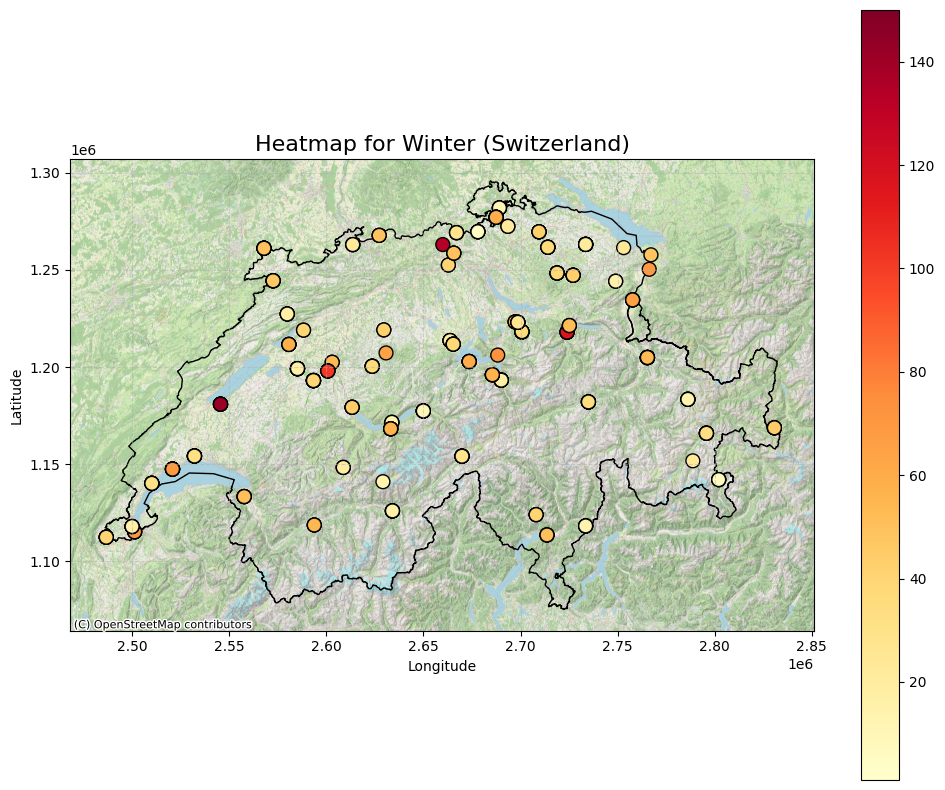

In [72]:
season_filter = "Winter"
gdf_filtered = gdf_points[gdf_points['season'] == season_filter]
zoom_level = 12
# Crear el mapa
fig, ax = plt.subplots(figsize=(12, 10))
switzerland.plot(ax=ax, color='none', edgecolor='black')  # Dibujar mapa de Suiza
gdf_filtered.plot(ax=ax, column='mean_lst', cmap='YlOrRd', markersize=100, edgecolor='black', legend=True)
ctx.add_basemap(ax, crs="EPSG:2056", source=ctx.providers.OpenStreetMap.CH, zoom=zoom_level)

# Personalizar el gráfico
plt.title(f"Heatmap for {season_filter} (Switzerland)", fontsize=16)
plt.xlabel("Longitude")
plt.ylabel("Latitude")
plt.grid(True, linestyle='--', alpha=0.5)
plt.savefig('../plots/lst_heatmap_winter.png')
plt.show()

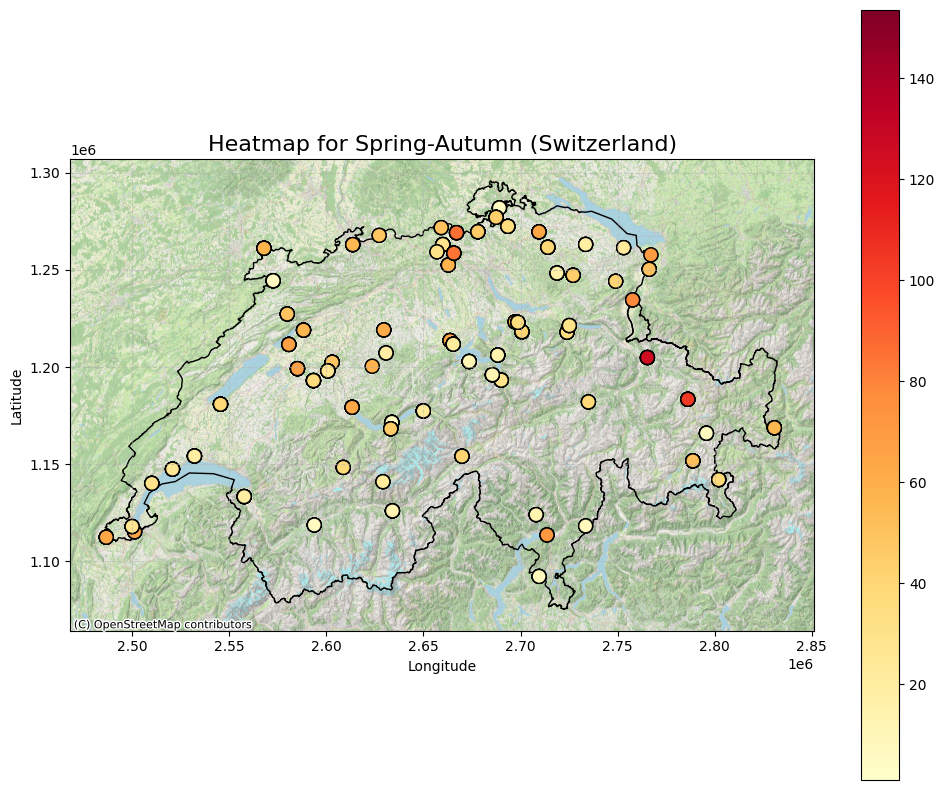

In [73]:
season_filter = "Spring-Autumn"
gdf_filtered = gdf_points[gdf_points['season'] == season_filter]
zoom_level = 12
# Crear el mapa
fig, ax = plt.subplots(figsize=(12, 10))
switzerland.plot(ax=ax, color='none', edgecolor='black')  # Dibujar mapa de Suiza
gdf_filtered.plot(ax=ax, column='mean_lst', cmap='YlOrRd', markersize=100, edgecolor='black', legend=True)
ctx.add_basemap(ax, crs="EPSG:2056", source=ctx.providers.OpenStreetMap.CH, zoom=zoom_level)

# Personalizar el gráfico
plt.title(f"Heatmap for {season_filter} (Switzerland)", fontsize=16)
plt.xlabel("Longitude")
plt.ylabel("Latitude")
plt.grid(True, linestyle='--', alpha=0.5)
plt.savefig('../plots/lst_heatmap_aut_spring.png')
plt.show()

In [74]:
max_lst_row = df.loc[df['mean_lst'].idxmax()]

# Fila con la media más baja de LST
min_lst_row = df.loc[df['mean_lst'].idxmin()]

# Mostrar los resultados
print("Fila con la media más alta de LST:")
print(max_lst_row)

print("\nFila con la media más baja de LST:")
print(min_lst_row)

Fila con la media más alta de LST:
cell               cell_52
date               2015-09
mean_lst        153.520846
mean_ndvi         0.511553
discharge           40.275
lat                2665335
lon              1211792.0
season       Spring-Autumn
Name: 1046, dtype: object

Fila con la media más baja de LST:
cell           cell_33
date           2021-12
mean_lst      1.015098
mean_ndvi     0.676375
discharge        0.741
lat            2593339
lon          1193042.0
season          Winter
Name: 635, dtype: object


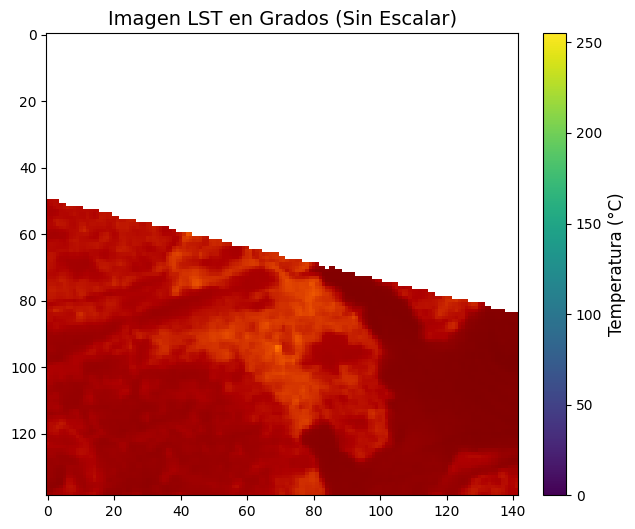

{'driver': 'GTiff', 'dtype': 'uint8', 'nodata': None, 'width': 142, 'height': 139, 'count': 3, 'crs': CRS.from_epsg(4326), 'transform': Affine(0.001305375080970748, 0.0, 8.205998956540387,
       0.0, -0.0009063485523095918, 47.11719475456272)}
Cantidad de bandas: 3
Banda 1: Min=125, Max=255, Media=209.59919951362852
Banda 2: Min=0, Max=255, Media=127.99630155030904
Banda 3: Min=0, Max=255, Media=122.9524267909616


In [128]:
im, m = load_raster('../data/raw/lst/cell_52/image_2015-09.tiff', True)

fig, ax = plt.subplots(figsize=(8, 6))
cax = ax.imshow(im, cmap='viridis')  # Usamos un colormap continuo para representar los valores
ax.set_title("Imagen LST en Grados (Sin Escalar)", fontsize=14)

# Crear la barra de colores
cbar = plt.colorbar(cax, ax=ax, fraction=0.046, pad=0.04)
cbar.set_label('Temperatura (°C)', fontsize=12)  # Etiqueta en grados

plt.show()
print(m.meta)
with rasterio.open('../data/raw/lst/cell_52/image_2015-09.tiff') as src:
    print(f"Cantidad de bandas: {src.count}")
    for i in range(1, src.count + 1):
        band = src.read(i)
        print(f"Banda {i}: Min={band.min()}, Max={band.max()}, Media={band.mean()}")

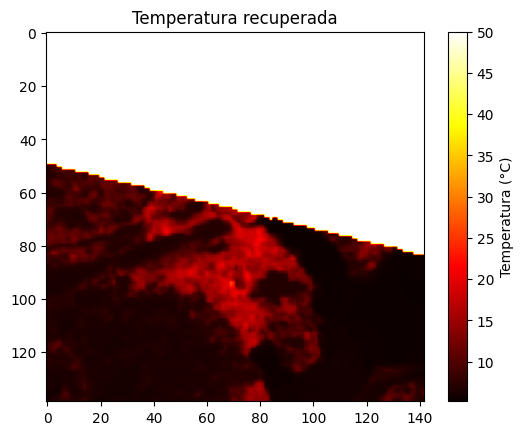

In [132]:
from skimage.color import rgb2gray
minC = 0  # Temperatura mínima (°C)
maxC = 50  
with rasterio.open('../data/raw/lst/cell_52/image_2015-09.tiff') as src:
    rgb = np.dstack([src.read(i) for i in range(1, 4)])  # Combinar las 3 bandas (RGB)

# Convertir a escala de grises como aproximación del gradiente
gray = rgb2gray(rgb)  # Devuelve valores en [0, 1]

# Revertir el gradiente a temperatura
temperature = gray * (maxC - minC) + minC

# Mostrar el resultado
import matplotlib.pyplot as plt
plt.imshow(temperature, cmap='hot')
plt.colorbar(label='Temperatura (°C)')
plt.title('Temperatura recuperada')
plt.show()

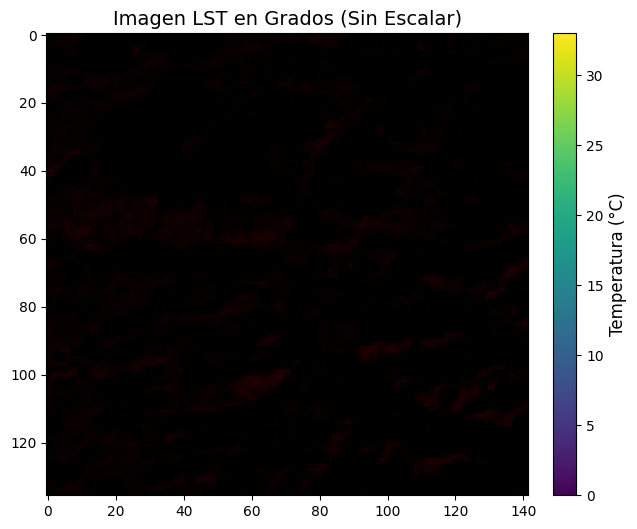

{'driver': 'GTiff', 'dtype': 'uint8', 'nodata': None, 'width': 142, 'height': 136, 'count': 3, 'crs': CRS.from_epsg(4326), 'transform': Affine(0.0012878371327625098, 0.0, 7.259702439241475,
       0.0, -0.0009215557783129945, 46.951099436808974)}
Cantidad de bandas: 3
Banda 1: Min=0, Max=33, Media=3.045049710024855
Banda 2: Min=0, Max=0, Media=0.0
Banda 3: Min=0, Max=0, Media=0.0


In [130]:
im, m = load_raster('../data/raw/lst/cell_33/image_2021-12.tiff', True)

fig, ax = plt.subplots(figsize=(8, 6))
cax = ax.imshow(im, cmap='viridis')  # Usamos un colormap continuo para representar los valores
ax.set_title("Imagen LST en Grados (Sin Escalar)", fontsize=14)

# Crear la barra de colores
cbar = plt.colorbar(cax, ax=ax, fraction=0.046, pad=0.04)
cbar.set_label('Temperatura (°C)', fontsize=12)  # Etiqueta en grados

plt.show()
print(m.meta)
with rasterio.open('../data/raw/lst/cell_33/image_2021-12.tiff') as src:
    print(f"Cantidad de bandas: {src.count}")
    for i in range(1, src.count + 1):
        band = src.read(i)
        print(f"Banda {i}: Min={band.min()}, Max={band.max()}, Media={band.mean()}")

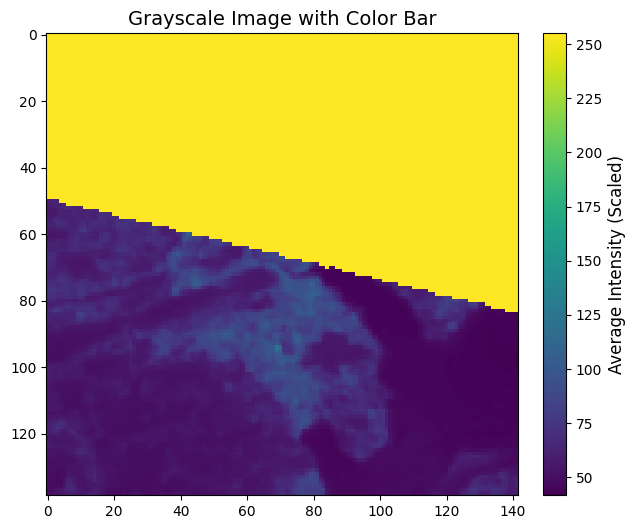

Before filtering:
Original image - Min: 0, Max: 255
Grayscale image - Min: 41.666666666666664, Max: 255.0

After filtering:
Original image (valid pixels) - Min: 0, Max: 255
Grayscale image (valid pixels) - Min: 41.666666666666664, Max: 123.0
Mean temperature of valid pixels: 59.02 °C
Unique valid pixel values: [  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  81  82  86  88  95 103 114 125 126 127
 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144 145
 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162 163
 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180 181
 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 197 198 199
 200 201 202 203 204 205 206 20

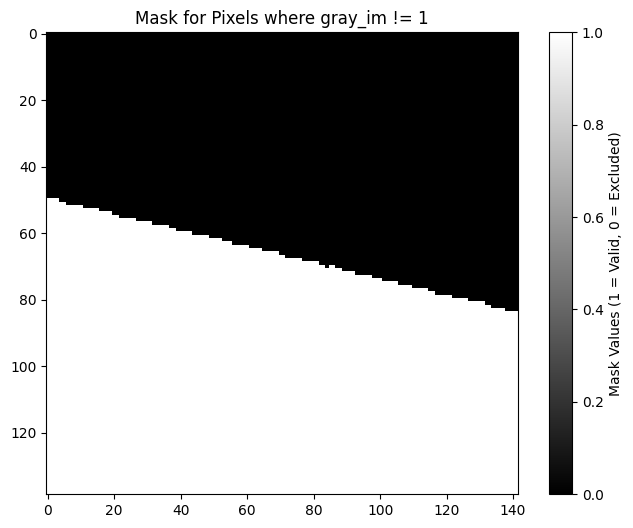

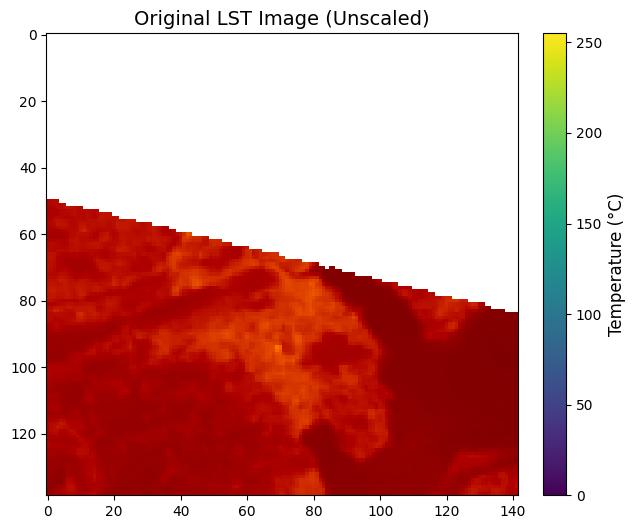

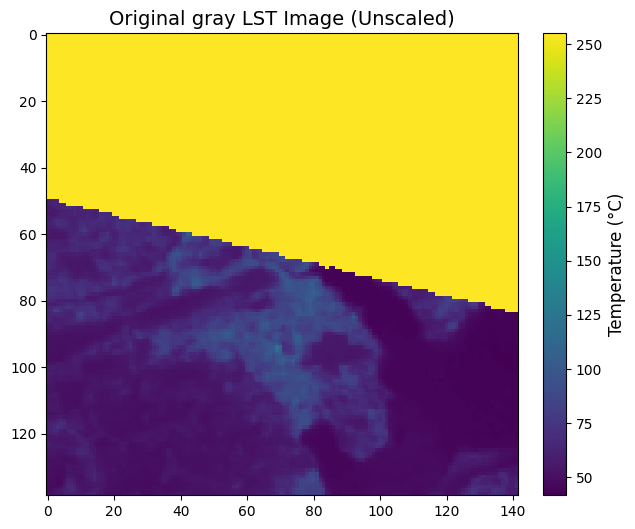

Overall mean temperature of the image: 153.52 °C
------------------


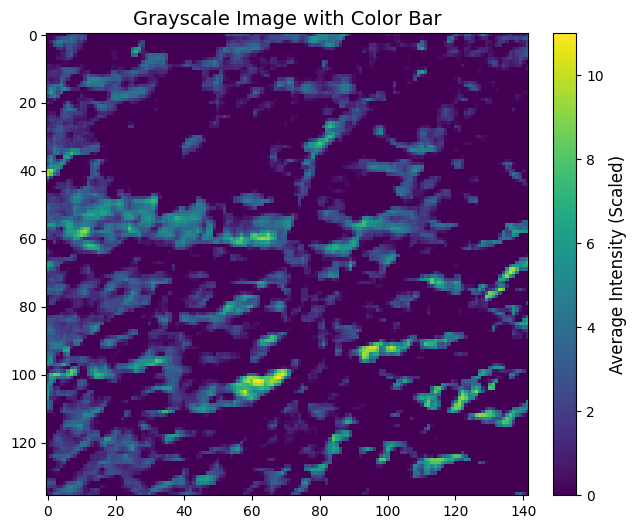

Before filtering:
Original image - Min: 0, Max: 33
Grayscale image - Min: 0.0, Max: 11.0

After filtering:
Original image (valid pixels) - Min: 0, Max: 33
Grayscale image (valid pixels) - Min: 0.0, Max: 11.0
Mean temperature of valid pixels: 59.02 °C
Unique valid pixel values: [  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  81  82  86  88  95 103 114 125 126 127
 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144 145
 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162 163
 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180 181
 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 197 198 199
 200 201 202 203 204 205 206 207 208 209 210 211 212 213 214 215 

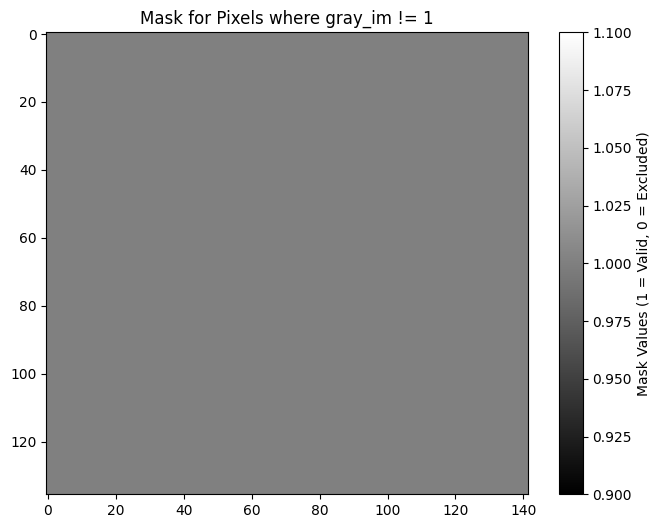

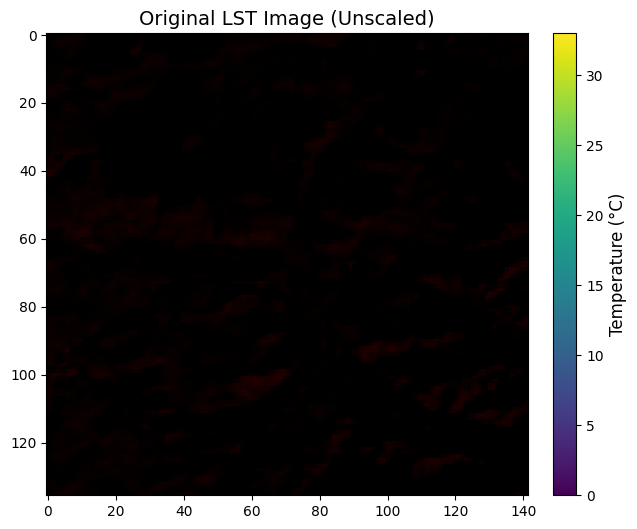

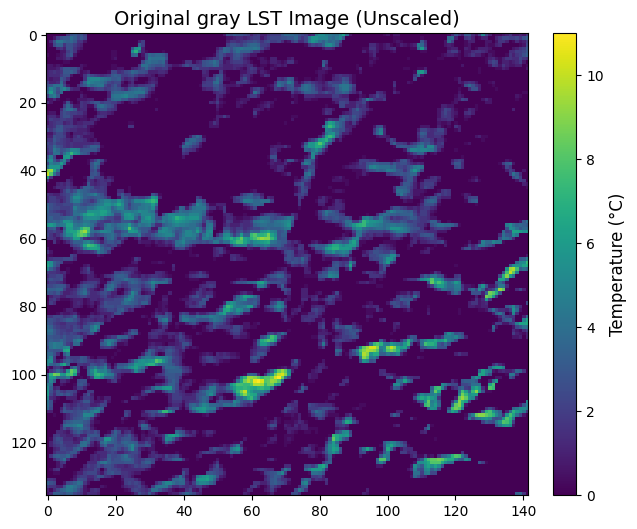

Overall mean temperature of the image: 1.02 °C


In [121]:
import numpy as np
import matplotlib.pyplot as plt

# Function to process and visualize an image
def process_and_visualize_image(image_path):
    # Load the image
    im, m = load_raster(image_path, True)

    # Scale the image
    scaled_im = im
    #np.clip(im * (6 / 255), 0, 1)
    # Convert to grayscale (average of RGB channels)
    gray_im = scaled_im.mean(axis=-1)

    # Visualize the grayscale image with a color bar
    fig, ax = plt.subplots(figsize=(8, 6))
    cax = ax.imshow(gray_im, cmap='viridis')
    ax.set_title("Grayscale Image with Color Bar", fontsize=14)
    cbar = plt.colorbar(cax, ax=ax, fraction=0.046, pad=0.04)
    cbar.set_label('Average Intensity (Scaled)', fontsize=12)
    plt.show()

    # Print min and max values before filtering
    print("Before filtering:")
    print(f"Original image - Min: {np.min(im)}, Max: {np.max(im)}")
    print(f"Grayscale image - Min: {np.min(gray_im)}, Max: {np.max(gray_im)}")

    # Create a mask and filter valid values
    mask = (gray_im != 255)  # Mask where gray_im is not 1
    valid_pixels_original = im[mask]  # Filter original image
    valid_pixels_gray = gray_im[mask]  # Filter grayscale image

    # Print min and max values after filtering
    print("\nAfter filtering:")
    print(f"Original image (valid pixels) - Min: {np.min(valid_pixels_original)}, Max: {np.max(valid_pixels_original)}")
    print(f"Grayscale image (valid pixels) - Min: {np.min(valid_pixels_gray)}, Max: {np.max(valid_pixels_gray)}")

    mean_valid_temperature = np.mean(valid_values)

    # Print statistics
    print(f"Mean temperature of valid pixels: {mean_valid_temperature:.2f} °C")
    print(f"Unique valid pixel values: {np.unique(valid_values)}")
    print(f"Mean of valid pixels (grayscale): {np.mean(gray_im[mask]):.2f}")
    print(f"Unique values in the original image: {np.unique(im)}")

    # Visualize the mask
    plt.figure(figsize=(8, 6))
    plt.imshow(mask, cmap="gray")
    plt.title("Mask for Pixels where gray_im != 1")
    plt.colorbar(label="Mask Values (1 = Valid, 0 = Excluded)")
    plt.show()

    # Visualize the original image with a color bar
    fig, ax = plt.subplots(figsize=(8, 6))
    cax = ax.imshow(im, cmap='viridis')
    ax.set_title("Original LST Image (Unscaled)", fontsize=14)
    cbar = plt.colorbar(cax, ax=ax, fraction=0.046, pad=0.04)
    cbar.set_label('Temperature (°C)', fontsize=12)
    plt.show()

    fig, ax = plt.subplots(figsize=(8, 6))
    cax = ax.imshow(im.mean(axis=-1), cmap='viridis')
    ax.set_title("Original gray LST Image (Unscaled)", fontsize=14)
    cbar = plt.colorbar(cax, ax=ax, fraction=0.046, pad=0.04)
    cbar.set_label('Temperature (°C)', fontsize=12)
    plt.show()

    # Print more statistics
    mean_temperature = np.nanmean(im)
    print(f"Overall mean temperature of the image: {mean_temperature:.2f} °C")

# Process and visualize the first image
process_and_visualize_image('../data/preprocessed/lst/cell_52/image_2015-09.tiff')
print('------------------')
# Process and visualize the second image
process_and_visualize_image('../data/preprocessed/lst/cell_33/image_2021-12.tiff')


In [117]:
img1, m = load_raster('../data/preprocessed/lst/cell_52/image_2015-09.tiff', True)
img2, m = load_raster('../data/preprocessed/lst/cell_33/image_2021-12.tiff', True)

gray_im = img1.mean(axis=-1)  # Promedio de los canales RGB

mask = (gray_im != 255)
valid_values = img1[mask]

combined_min = min(np.min(valid_values), np.min(img2))  # Mínimo entre las dos imágenes
combined_max = max(np.max(valid_values), np.max(img2))

print(combined_min,combined_max)

normalized_img1 = normalize_min_max(img1, combined_min, combined_max)
normalized_img2 = normalize_min_max(img2, combined_min, combined_max)

0 255


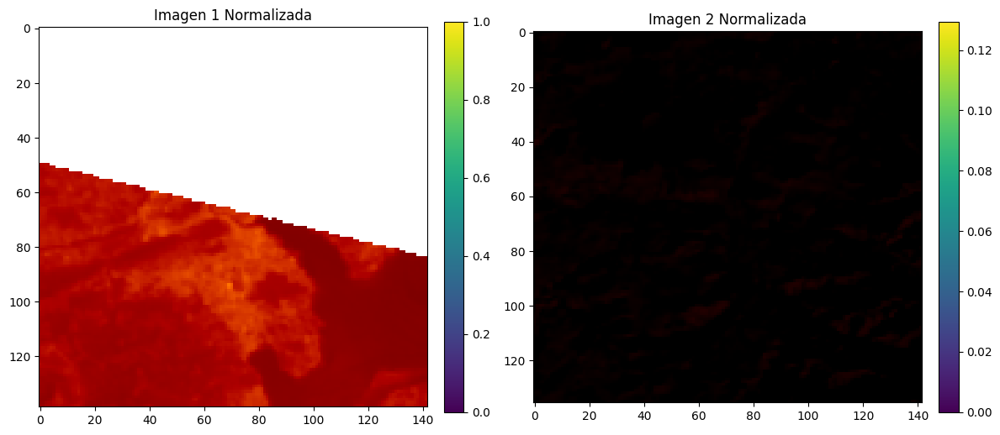

In [118]:
# Crear subplots
fig, ax = plt.subplots(1, 2, figsize=(12, 6))

# Normalizar y graficar la primera imagen
cax1 = ax[0].imshow(normalized_img1, cmap="viridis")
cbar1 = plt.colorbar(cax1, ax=ax[0], fraction=0.046, pad=0.04)
ax[0].set_title("Imagen 1 Normalizada")

# Normalizar y graficar la segunda imagen
cax2 = ax[1].imshow(normalized_img2, cmap="viridis")
cbar2 = plt.colorbar(cax2, ax=ax[1], fraction=0.046, pad=0.04)
ax[1].set_title("Imagen 2 Normalizada")

# Mostrar todos los gráficos juntos
plt.tight_layout()
plt.show()


['2013-08', '2014-02', '2015-05', '2018-06', '2020-03', '2020-06', '2021-09', '2022-03', '2022-08', '2022-12', '2023-02', '2023-10', '2023-12']


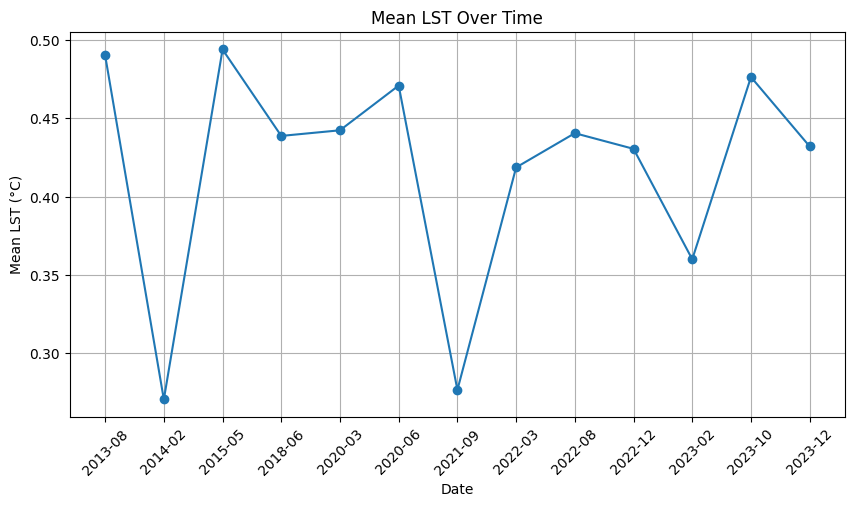

['2013-07', '2014-01', '2015-07', '2015-12', '2016-08', '2018-04', '2019-02', '2019-06', '2021-02', '2022-04', '2022-05', '2022-11', '2024-01', '2024-02', '2024-06']


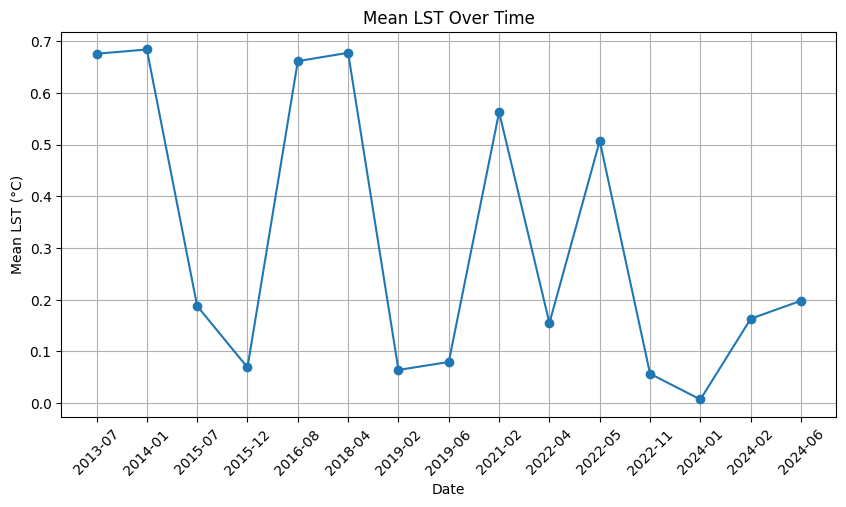

['2013-12', '2014-06', '2015-05', '2015-06', '2016-06', '2017-01', '2017-08', '2017-09', '2017-11', '2017-12', '2018-01', '2018-08', '2018-12', '2019-01', '2019-03', '2019-07', '2020-03', '2020-07', '2020-10', '2021-01', '2021-08', '2021-12', '2022-09', '2022-12', '2023-01', '2023-02', '2023-04', '2023-05', '2023-12', '2024-01', '2024-08', '2024-09']


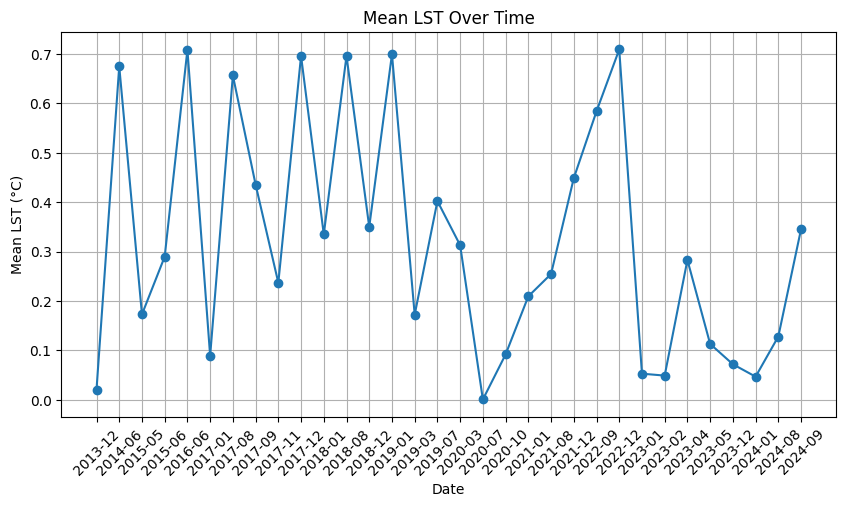

['2013-07', '2014-01', '2014-02', '2016-08', '2016-10', '2017-02', '2019-01', '2019-04', '2019-08', '2020-01', '2022-01', '2022-11', '2022-12', '2023-05', '2023-07', '2023-09', '2023-10', '2024-06', '2024-08']


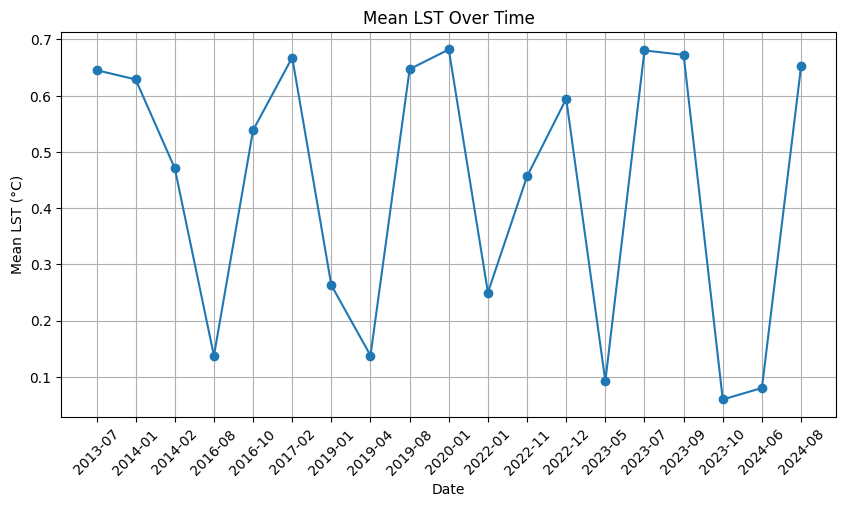

['2014-04', '2015-08', '2015-11', '2015-12', '2016-05', '2016-07', '2017-04', '2017-07', '2018-01', '2018-08', '2018-11', '2019-04', '2019-06', '2019-08', '2019-09', '2019-12', '2020-06', '2020-12', '2022-10', '2023-07', '2023-12', '2024-01', '2024-02', '2024-07']


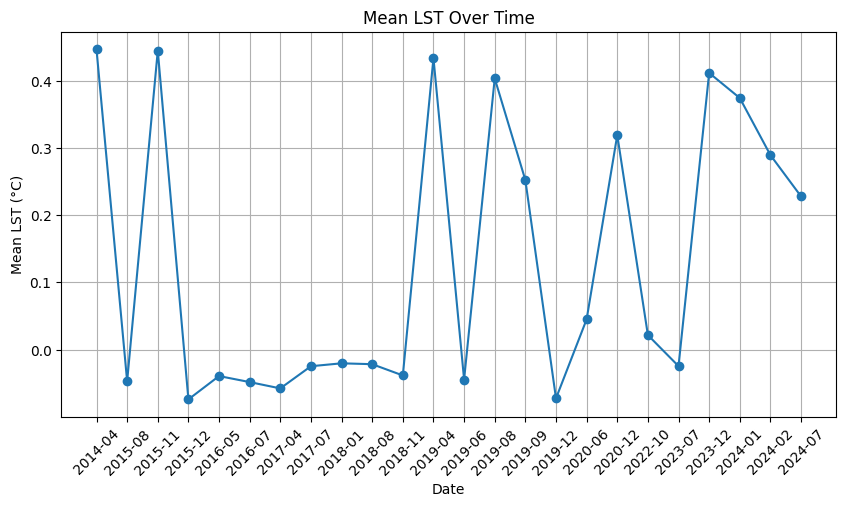

['2013-08', '2013-09', '2013-12', '2014-01', '2014-08', '2014-09', '2014-10', '2014-12', '2015-01', '2015-03', '2015-05', '2015-08', '2016-03', '2016-05', '2016-07', '2016-08', '2017-04', '2017-12', '2018-05', '2018-09', '2018-11', '2018-12', '2019-06', '2019-07', '2019-08', '2020-01', '2020-07', '2020-11', '2020-12', '2021-01', '2021-05', '2021-08', '2021-10', '2023-02', '2023-06', '2023-10', '2024-05', '2024-08', '2024-09']


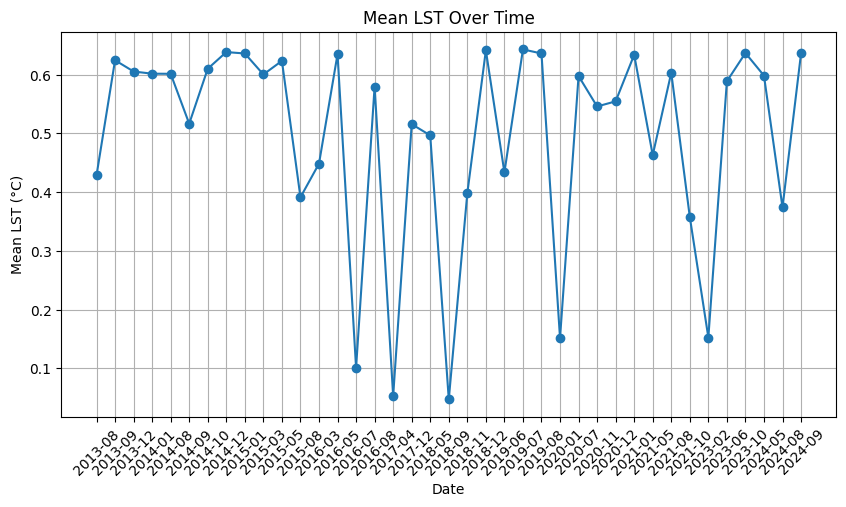

['2013-06', '2015-03', '2015-10', '2016-03', '2016-11', '2017-10', '2019-03', '2019-08', '2023-10']


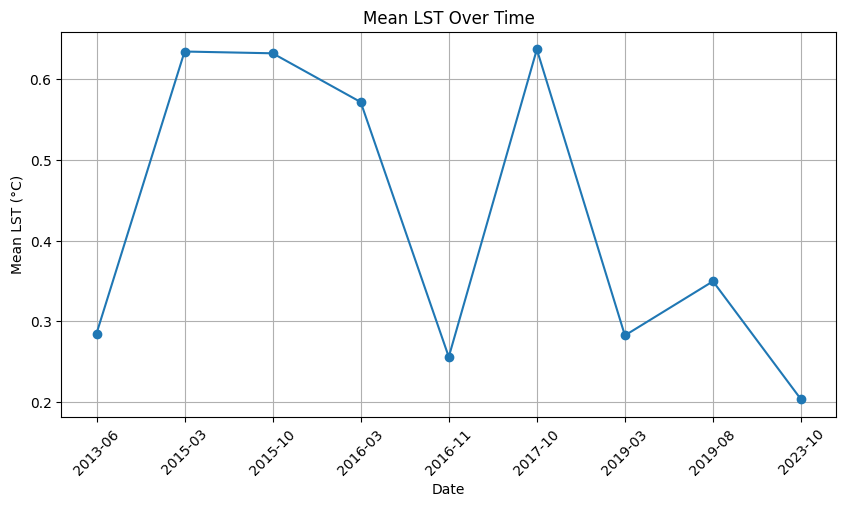

['2013-04', '2013-05', '2014-01', '2014-04', '2015-03', '2015-10', '2016-04', '2016-05', '2016-10', '2018-07', '2018-10', '2019-06', '2021-04', '2021-05', '2022-09', '2022-10', '2023-10']


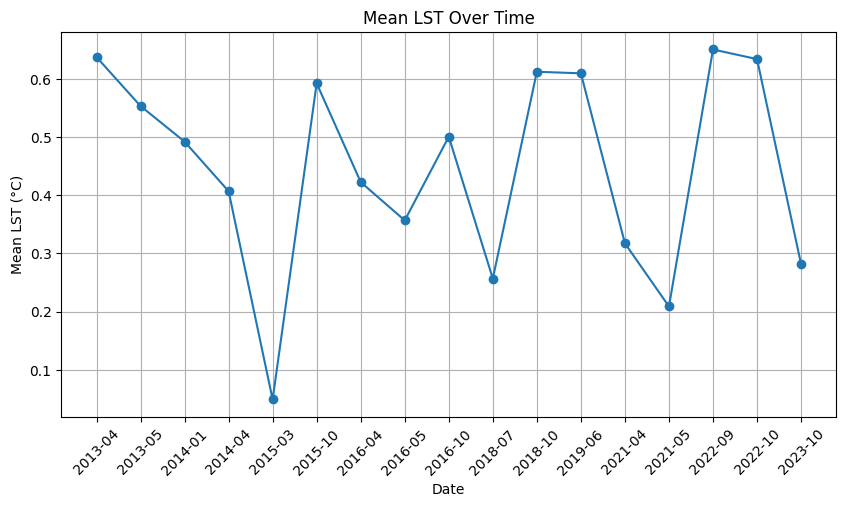

['2013-09', '2015-09', '2016-11', '2017-09', '2018-01', '2018-11', '2019-01', '2019-05', '2019-11', '2020-05', '2020-11', '2021-04', '2022-10', '2023-04', '2023-08']


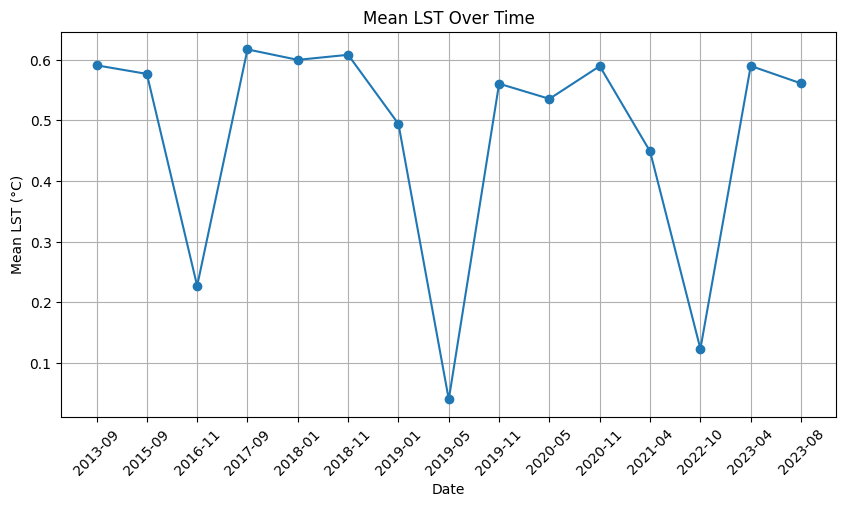

['2013-03', '2013-04', '2014-07', '2015-04', '2015-05', '2015-06', '2015-12', '2016-04', '2016-08', '2017-03', '2017-05', '2017-09', '2017-10', '2019-04', '2019-10', '2020-01', '2020-07', '2021-01', '2021-03', '2021-11', '2022-01', '2022-11', '2023-09', '2024-01', '2024-02', '2024-06', '2024-07', '2024-08']


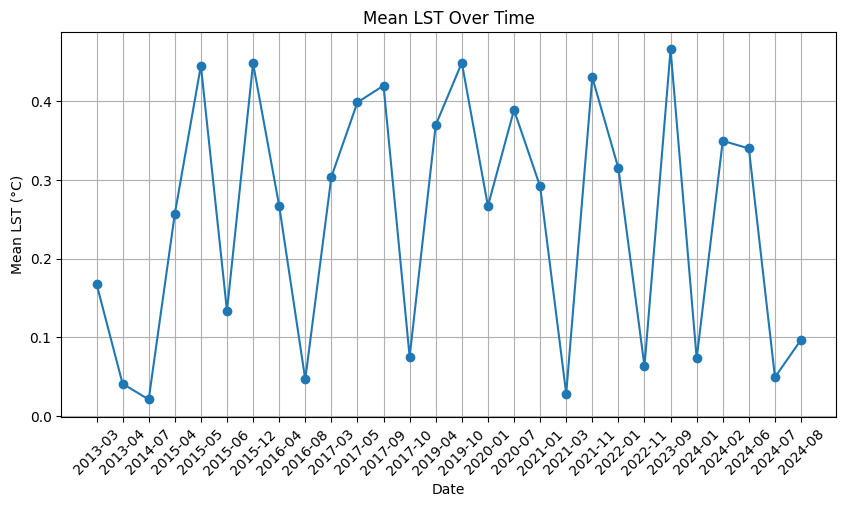

['2013-09', '2013-12', '2014-03', '2014-05', '2015-01', '2016-04', '2016-06', '2017-06', '2018-04', '2019-05', '2019-08', '2020-04', '2020-09', '2022-12', '2024-06', '2024-08']


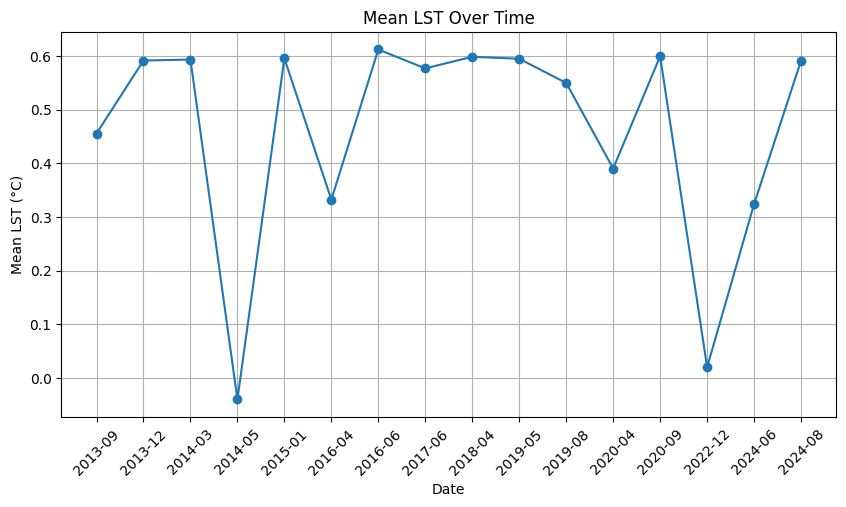

['2013-09', '2013-10', '2014-07', '2014-09', '2015-10', '2015-12', '2017-08', '2018-03', '2018-07', '2018-10', '2018-12', '2019-02', '2019-03', '2019-05', '2019-07', '2021-05', '2021-10', '2022-11', '2024-06', '2024-09']


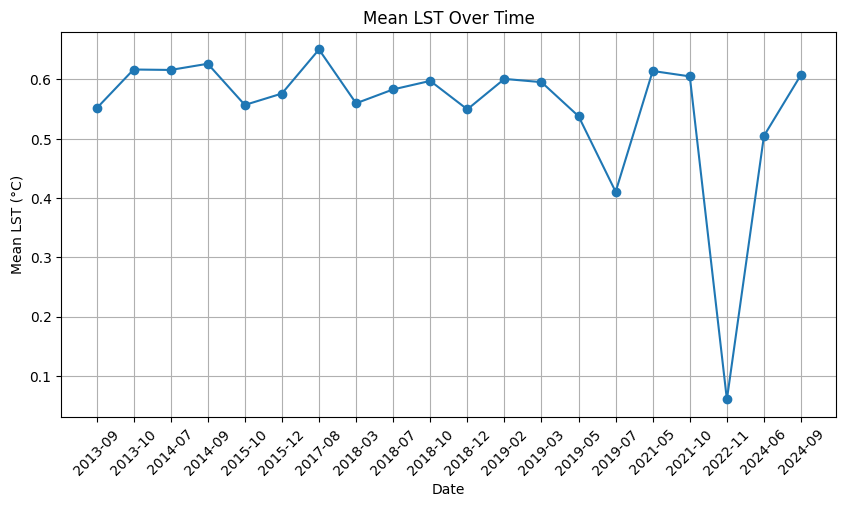

['2013-05', '2013-11', '2014-08', '2014-11', '2016-03', '2016-07', '2016-10', '2016-12', '2017-04', '2019-02', '2019-07', '2021-03', '2021-08', '2022-06', '2023-05', '2023-07', '2023-08', '2023-09', '2023-11', '2024-05', '2024-06', '2024-08', '2024-09']


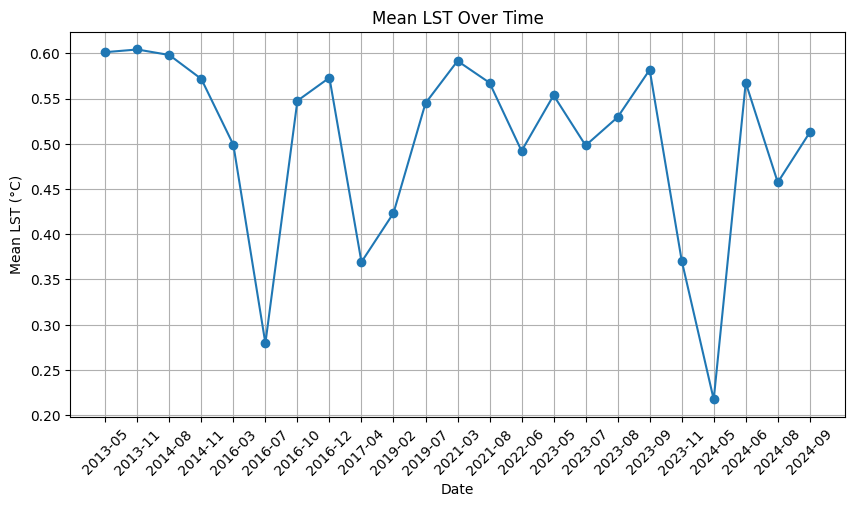

['2013-05', '2013-08', '2014-03', '2014-10', '2016-12', '2017-05', '2017-06', '2017-09', '2017-10', '2019-03', '2021-07', '2022-06', '2022-09', '2023-04', '2023-06', '2023-08', '2023-09', '2024-03', '2024-05']


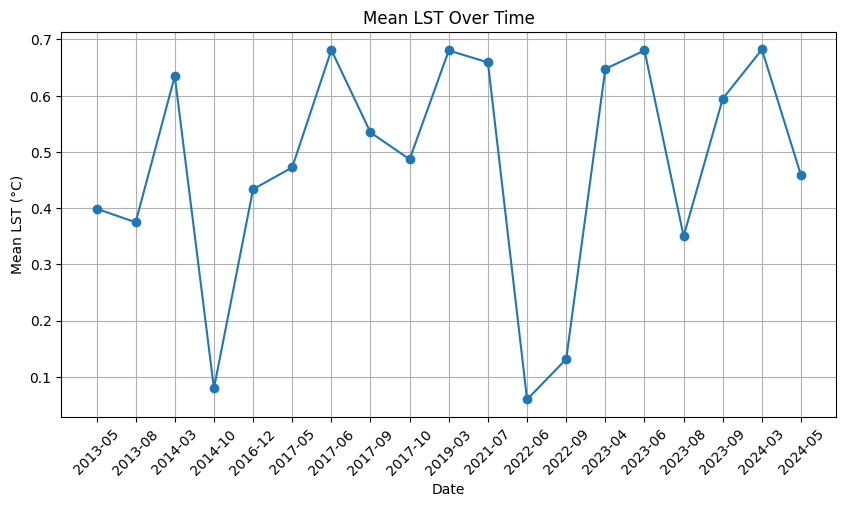

['2014-02', '2015-05', '2015-08', '2015-12', '2016-02', '2016-05', '2017-01', '2018-05', '2018-06', '2018-07', '2018-08', '2018-09', '2020-02', '2020-09', '2021-01', '2021-06', '2021-11', '2022-03', '2022-06', '2022-09', '2023-04', '2024-04']


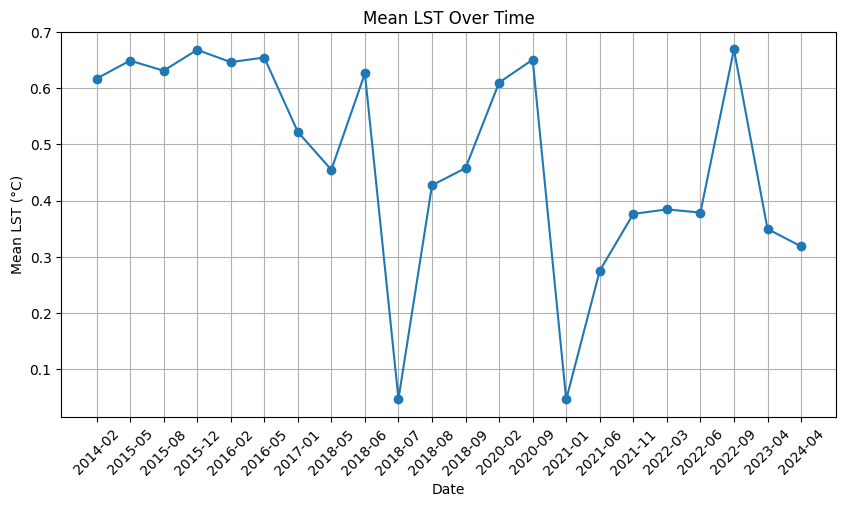

['2013-11', '2014-04', '2014-06', '2014-10', '2014-11', '2015-07', '2016-01', '2016-02', '2016-07', '2016-08', '2016-10', '2017-04', '2018-02', '2018-03', '2019-11', '2020-01', '2020-02', '2020-06', '2021-08', '2022-06', '2022-07', '2022-11', '2023-01', '2024-02', '2024-08']


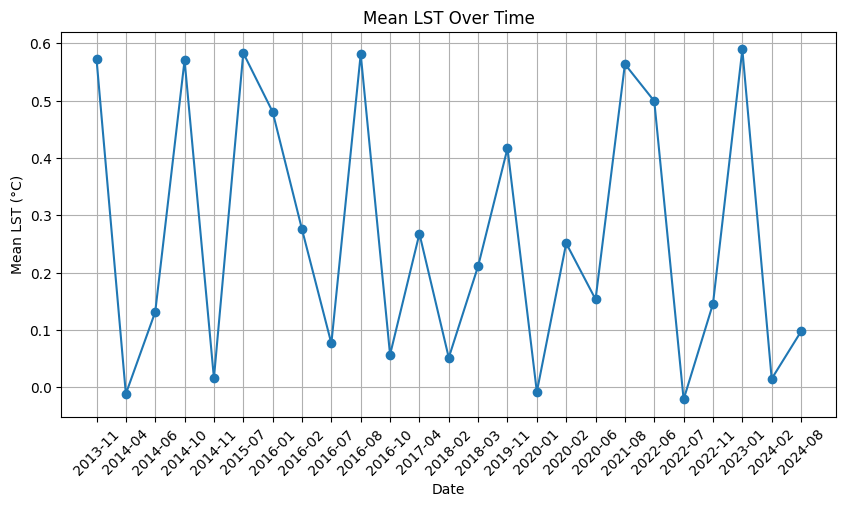

['2013-07', '2013-09', '2013-11', '2013-12', '2014-02', '2014-08', '2015-04', '2016-03', '2016-07', '2016-11', '2017-07', '2018-04', '2018-07', '2018-10', '2019-02', '2019-05', '2020-10', '2021-01', '2021-04', '2021-08', '2022-10', '2023-02', '2023-05', '2023-10', '2024-01', '2024-02']


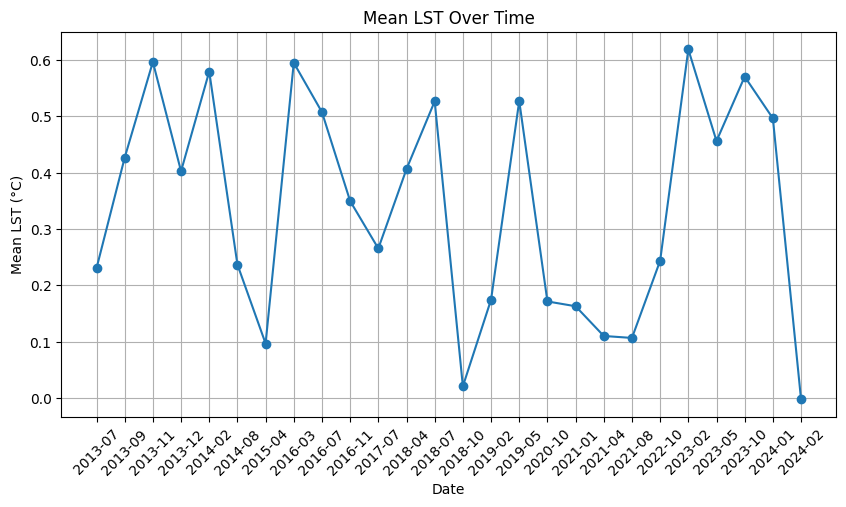

['2013-03', '2014-07', '2014-09', '2015-05', '2015-11', '2016-02', '2016-12', '2017-01', '2017-04', '2018-03', '2018-06', '2020-02', '2020-12', '2023-04', '2023-09', '2024-07']


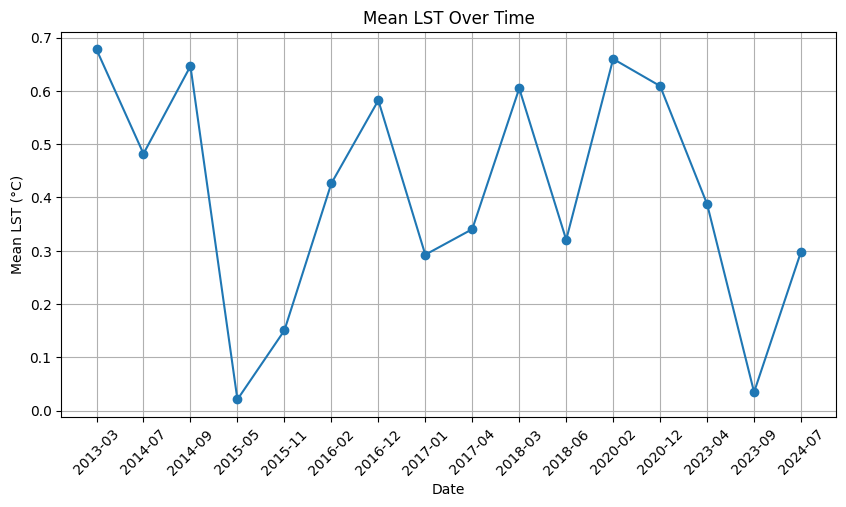

['2013-09', '2013-10', '2014-05', '2014-11', '2015-01', '2015-10', '2015-12', '2016-01', '2017-06', '2018-02', '2019-02', '2019-08', '2020-01', '2021-10', '2022-12', '2023-06', '2024-03', '2024-07', '2024-09']


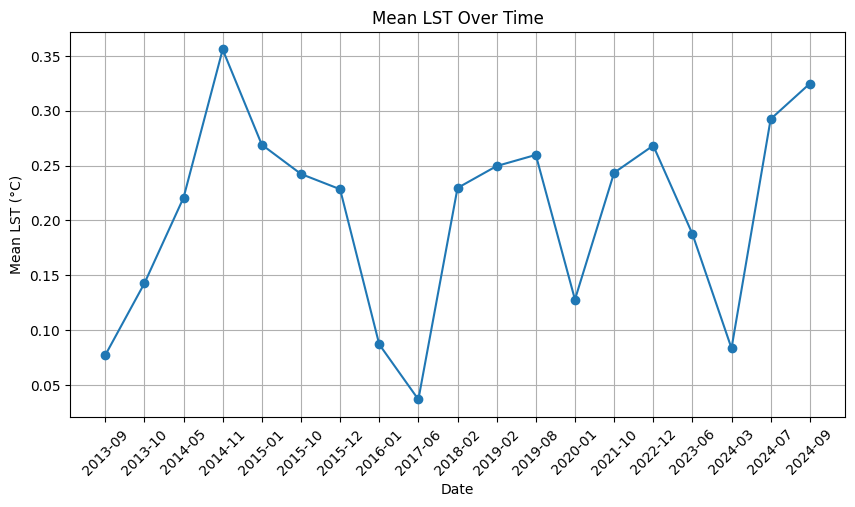

['2013-03', '2015-03', '2016-06', '2016-09', '2017-05', '2017-09', '2018-05', '2018-08', '2018-11', '2019-04', '2019-05', '2019-06', '2019-11', '2020-02', '2021-03', '2021-07', '2021-09', '2022-09', '2022-10', '2023-04', '2023-09', '2024-03']


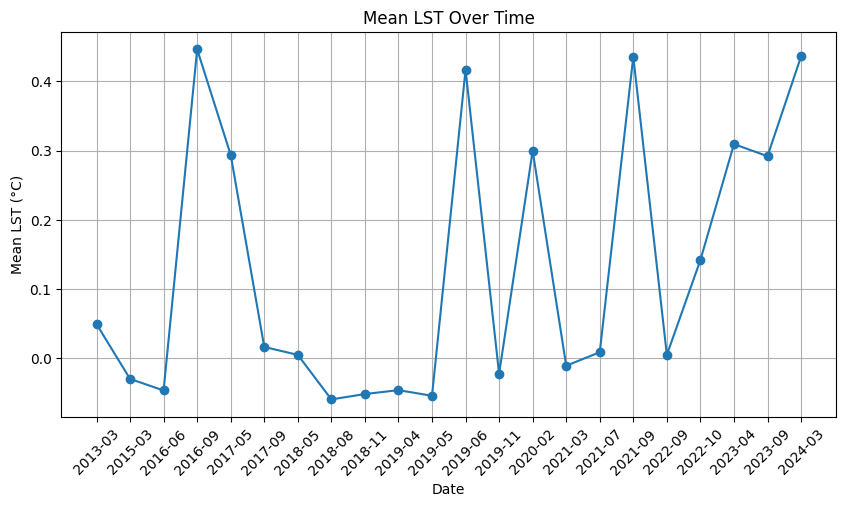

['2013-11', '2014-09', '2015-02', '2015-08', '2016-01', '2018-02', '2018-08', '2019-08', '2020-09', '2022-01', '2023-11']


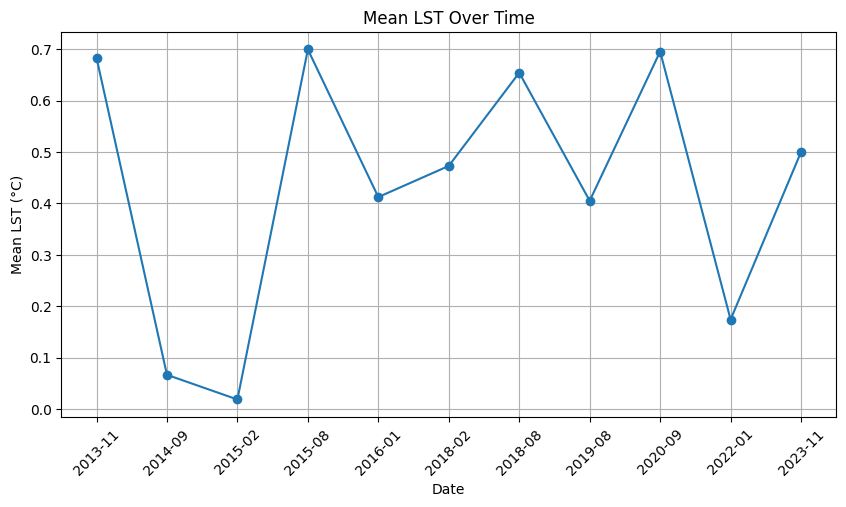

['2013-03', '2013-05', '2013-07', '2014-04', '2014-06', '2014-07', '2014-11', '2015-02', '2015-03', '2015-04', '2015-05', '2015-08', '2016-10', '2016-11', '2017-11', '2017-12', '2018-04', '2018-05', '2018-06', '2018-08', '2019-01', '2019-04', '2019-09', '2019-11', '2020-02', '2020-04', '2020-06', '2020-07', '2021-04', '2021-05', '2021-06', '2021-07', '2021-09', '2021-11', '2022-04', '2022-06', '2022-10', '2023-04', '2023-05', '2023-09', '2023-10', '2024-01', '2024-06', '2024-08']


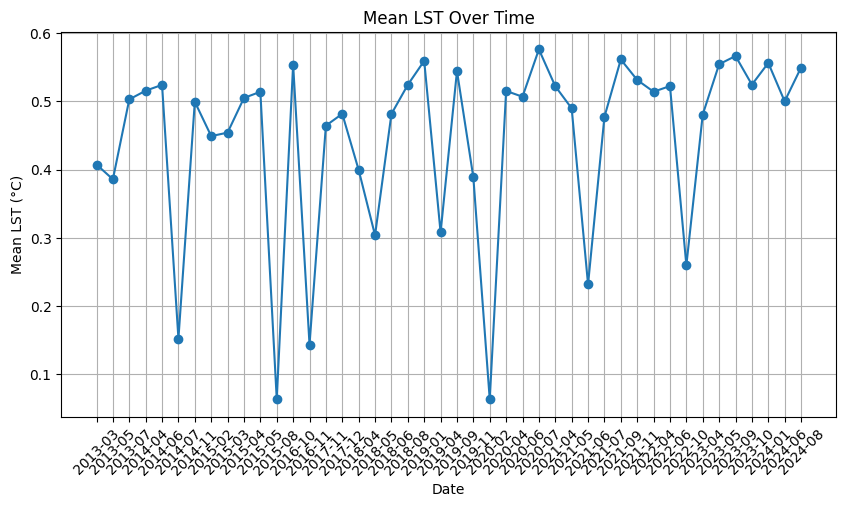

['2013-04', '2013-05', '2013-10', '2013-12', '2015-03', '2015-07', '2016-09', '2017-01', '2017-03', '2018-03', '2018-10', '2019-06', '2020-02', '2020-08', '2020-11', '2021-06', '2021-11', '2022-07', '2022-10', '2023-06', '2024-05']


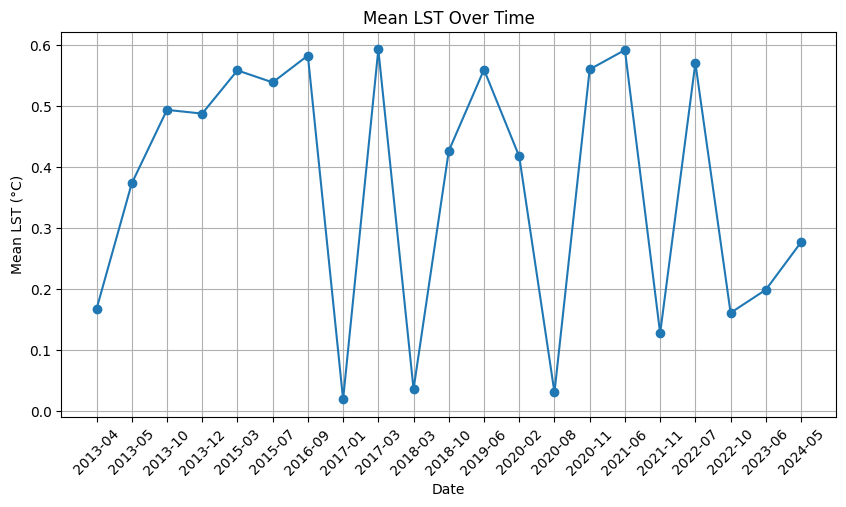

['2014-09', '2014-11', '2015-02', '2015-07', '2016-02', '2016-03', '2016-11', '2017-08', '2017-09', '2018-03', '2018-06', '2018-10', '2019-02', '2019-07', '2019-09', '2019-12', '2020-11', '2021-03', '2021-06', '2021-12', '2022-02', '2023-07', '2023-09']


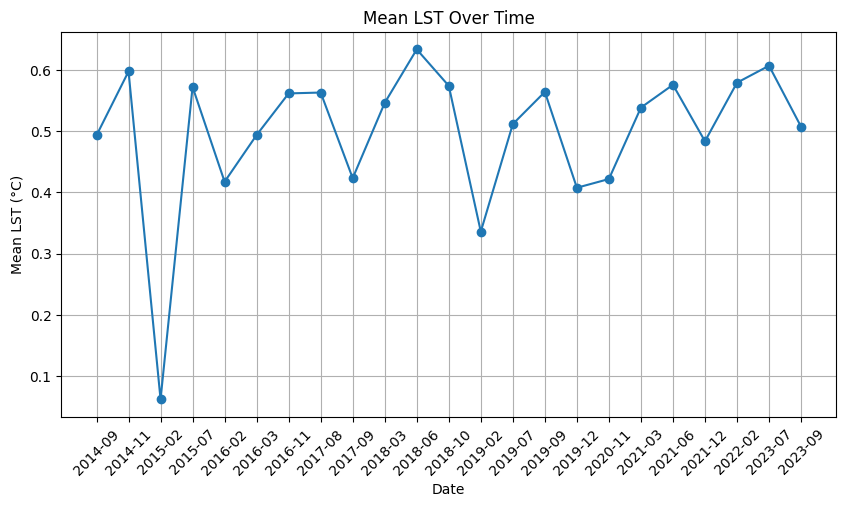

['2014-04', '2015-03', '2015-04', '2015-08', '2016-01', '2016-08', '2016-10', '2016-12', '2017-03', '2018-01', '2018-03', '2018-05', '2018-12', '2019-01', '2019-02', '2020-12', '2022-12', '2023-05', '2024-07']


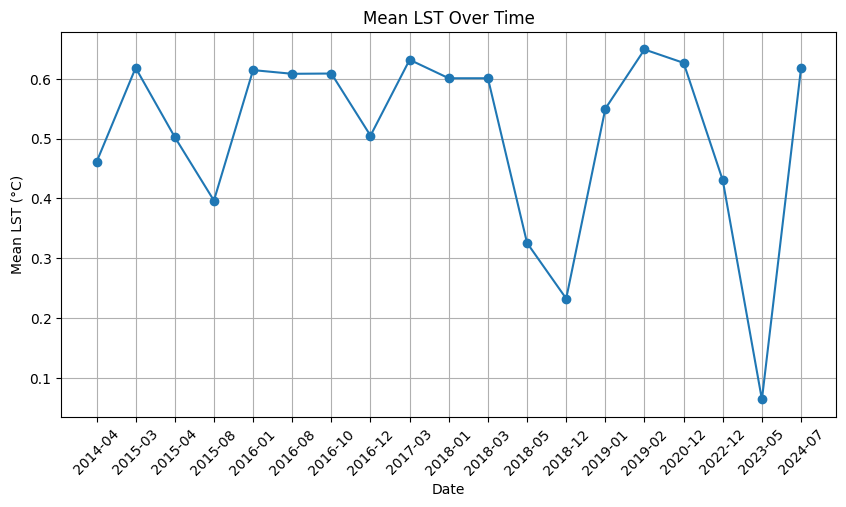

['2014-03', '2016-03', '2016-11', '2017-03', '2017-11', '2019-11', '2021-04', '2022-09', '2023-04', '2024-02', '2024-04']


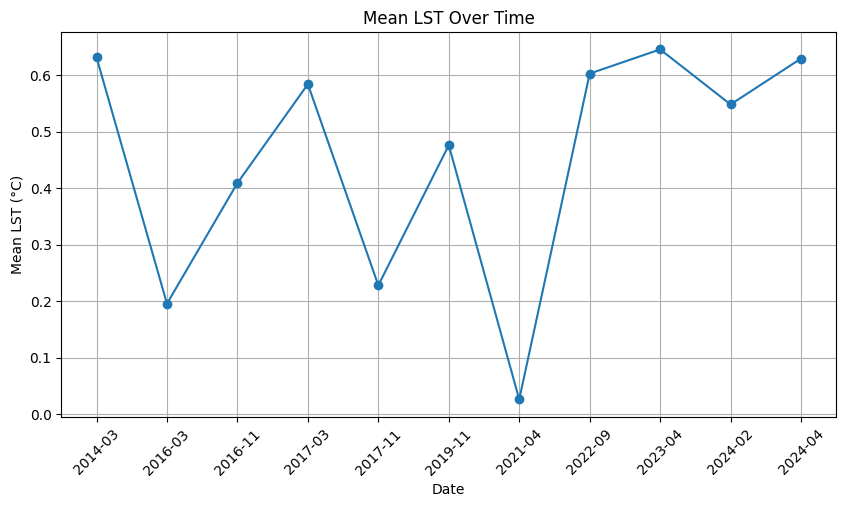

['2013-07', '2014-09', '2015-05', '2015-12', '2019-08', '2020-10', '2021-06', '2022-07', '2024-05']


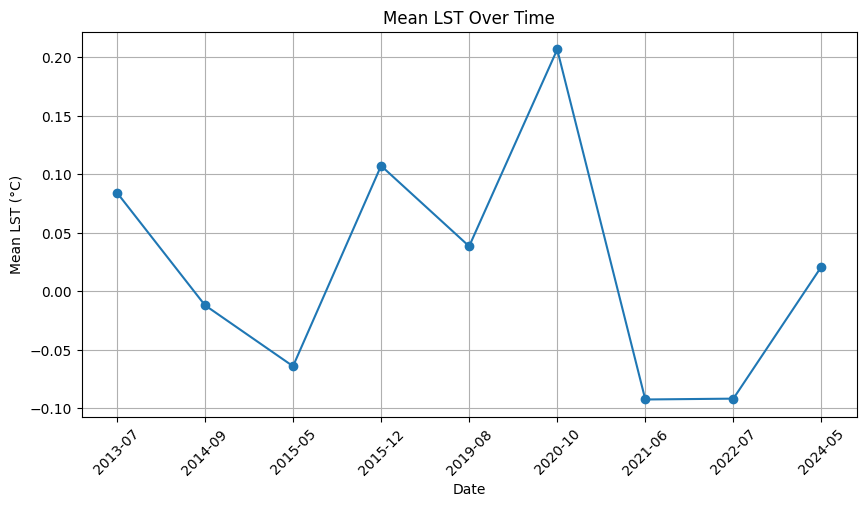

['2014-02', '2014-03', '2014-04', '2014-07', '2014-08', '2015-03', '2016-03', '2016-11', '2018-07', '2018-08', '2018-10', '2019-06', '2020-01', '2020-02', '2020-04', '2020-10', '2020-12', '2021-04', '2021-05', '2021-06', '2021-08', '2023-01', '2023-05', '2023-07', '2023-10', '2024-01', '2024-09']


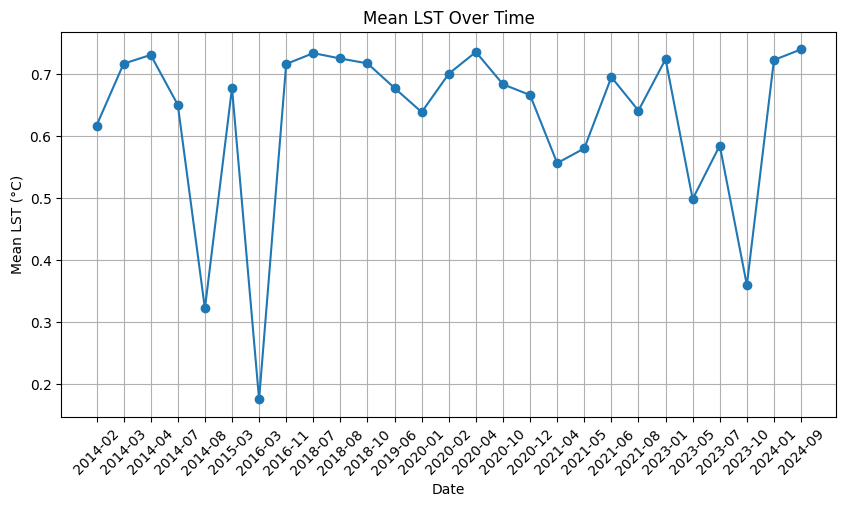

['2014-04', '2014-05', '2014-07', '2015-04', '2015-05', '2015-07', '2015-11', '2016-08', '2017-04', '2018-04', '2018-06', '2018-07', '2018-09', '2019-04', '2019-11', '2020-04', '2020-06', '2020-08', '2020-10', '2021-01', '2021-03', '2021-04', '2022-10', '2023-03', '2023-05', '2024-06']


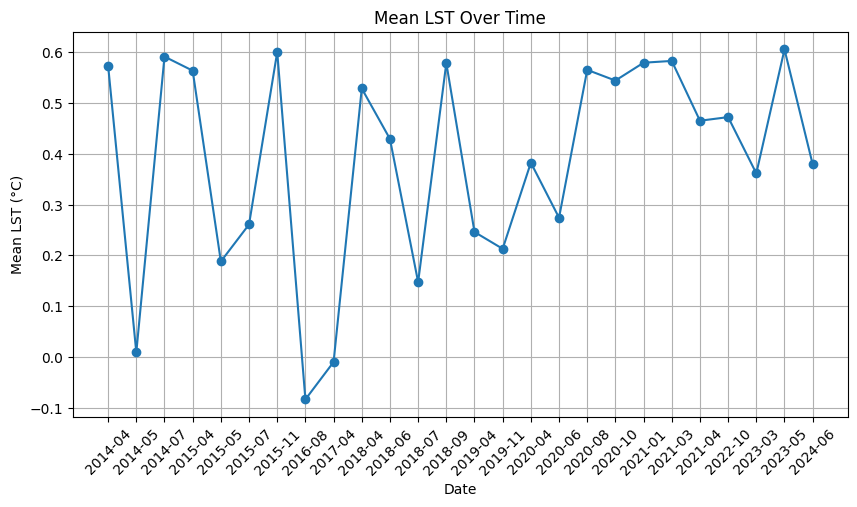

['2013-04', '2013-05', '2013-11', '2014-01', '2014-06', '2014-07', '2015-03', '2015-06', '2015-11', '2015-12', '2016-03', '2016-05', '2016-08', '2017-01', '2017-02', '2018-01', '2018-06', '2018-07', '2019-01', '2019-03', '2019-04', '2019-09', '2020-05', '2020-08', '2021-03', '2021-06', '2021-08', '2022-03', '2022-05', '2022-07', '2022-09', '2023-03', '2023-09', '2024-04', '2024-06']


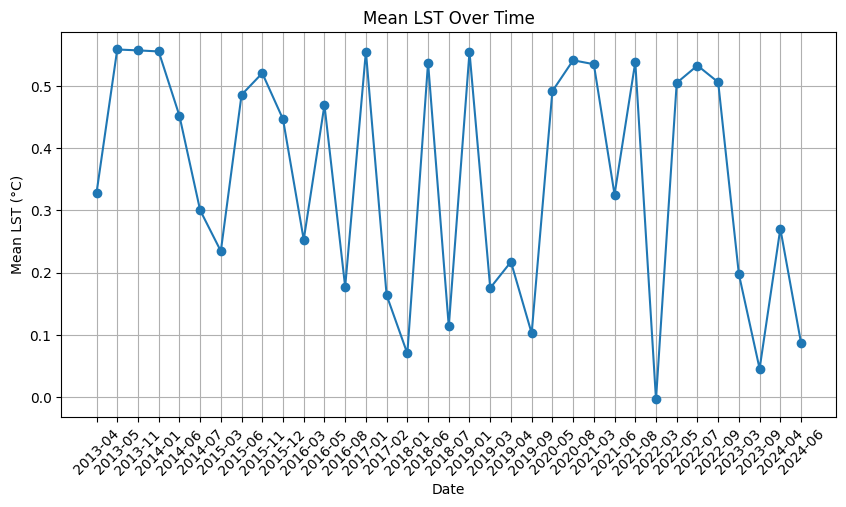

['2013-05', '2013-08', '2014-07', '2015-01', '2015-02', '2015-03', '2015-09', '2015-10', '2015-12', '2016-01', '2016-05', '2016-08', '2016-12', '2017-03', '2017-06', '2017-10', '2017-12', '2018-01', '2018-06', '2018-08', '2018-10', '2019-02', '2019-04', '2019-07', '2019-08', '2019-10', '2020-01', '2020-04', '2020-05', '2020-10', '2020-11', '2020-12', '2021-05', '2021-08', '2021-12', '2022-04', '2022-11', '2022-12', '2023-03', '2023-04', '2023-06', '2023-08', '2023-11', '2024-04', '2024-05', '2024-06']


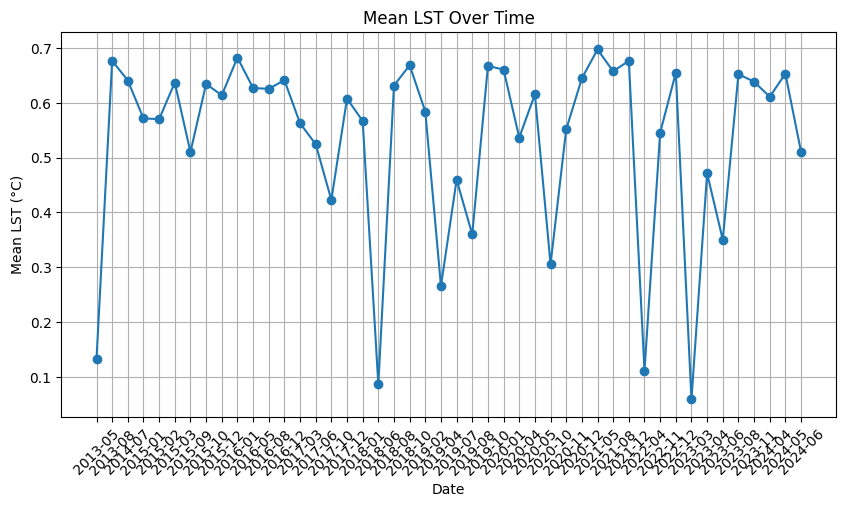

['2014-08', '2015-04', '2015-05', '2015-10', '2016-03', '2016-04', '2016-07', '2016-12', '2017-01', '2018-04', '2019-01', '2019-07', '2019-12', '2020-11', '2021-04', '2022-05', '2023-09']


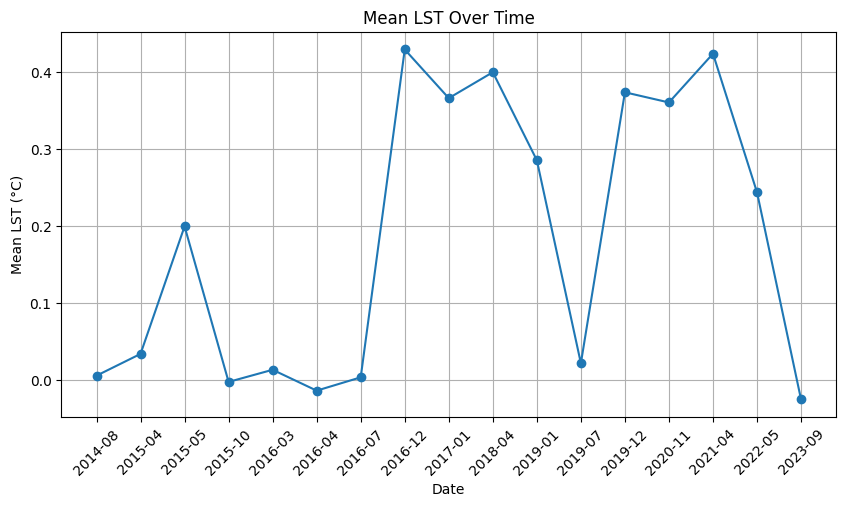

['2013-08', '2013-10', '2013-11', '2014-09', '2015-04', '2016-02', '2017-06', '2018-02', '2018-03', '2018-11', '2019-12', '2020-02', '2020-07', '2021-08', '2021-09', '2021-10', '2022-02', '2022-08', '2022-12', '2024-03', '2024-05']


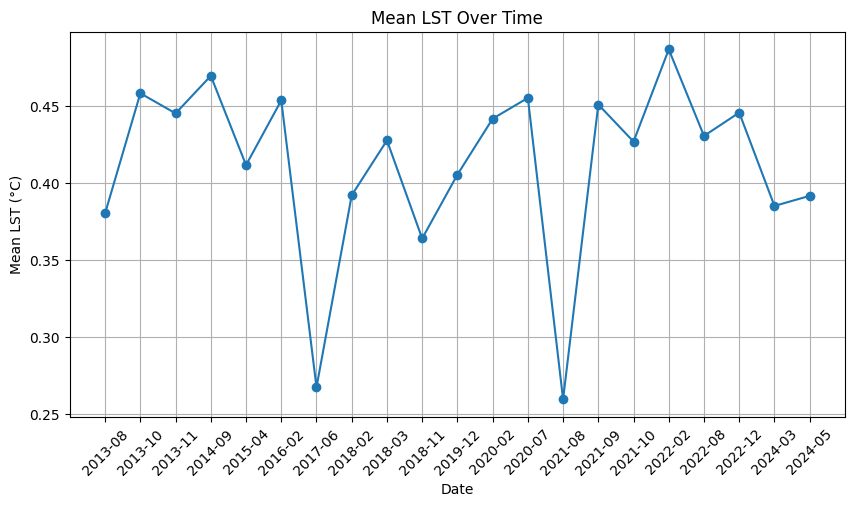

['2013-04', '2014-03', '2015-02', '2015-07', '2016-06', '2017-02', '2018-02', '2018-09', '2019-02', '2019-05', '2019-07', '2019-10', '2020-09', '2020-10', '2023-05', '2023-08', '2023-11', '2024-08', '2024-09']


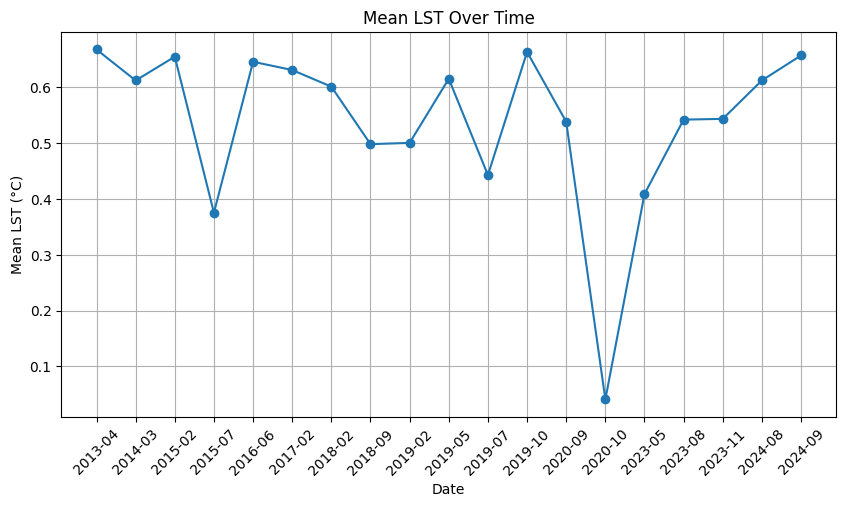

['2013-09', '2014-01', '2014-02', '2014-12', '2015-06', '2015-12', '2016-05', '2016-08', '2017-02', '2017-10', '2017-11', '2018-04', '2019-06', '2019-09', '2020-05', '2020-09', '2020-11', '2021-06', '2022-03', '2022-05', '2023-04', '2023-11', '2024-03', '2024-08']


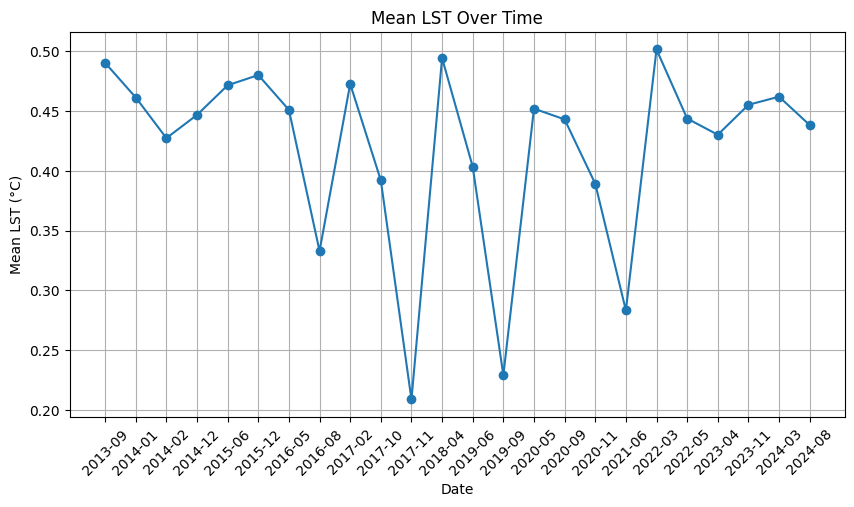

['2015-05', '2015-07', '2016-08', '2017-05', '2018-02', '2018-03', '2018-04', '2018-06', '2019-07', '2020-04', '2020-06', '2020-07', '2020-09', '2020-11', '2021-09', '2021-10', '2023-11', '2024-01', '2024-03']


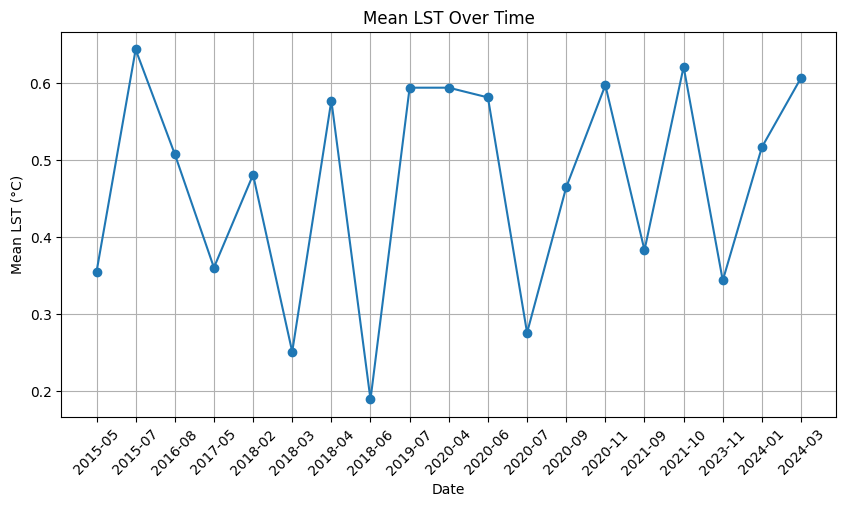

['2013-06', '2013-10', '2014-07', '2014-09', '2014-10', '2014-12', '2015-01', '2015-03', '2015-04', '2015-05', '2015-06', '2015-07', '2015-08', '2016-02', '2016-09', '2017-04', '2018-01', '2018-03', '2018-05', '2018-10', '2019-06', '2019-08', '2019-12', '2020-01', '2020-03', '2020-07', '2021-03', '2021-05', '2021-08', '2022-05', '2022-07', '2023-04', '2023-05', '2023-07', '2023-09', '2023-10', '2023-11', '2024-02', '2024-06', '2024-08', '2024-09']


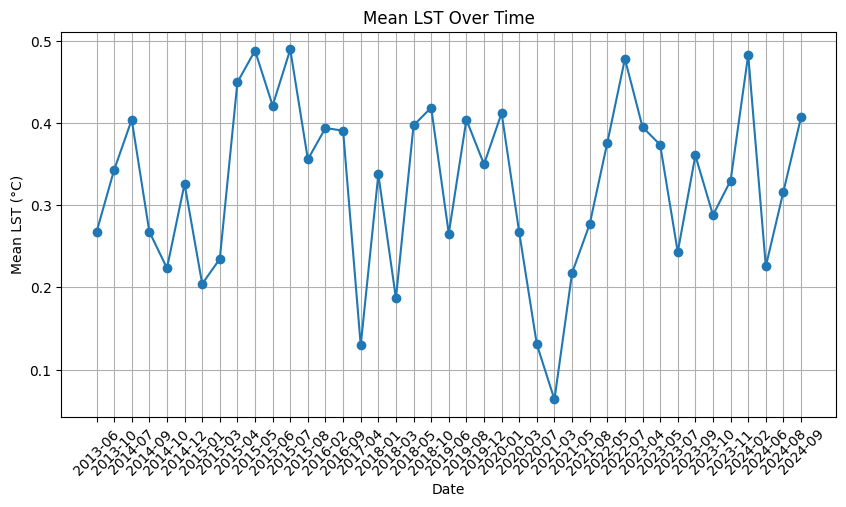

['2013-05', '2014-12', '2015-12', '2016-06', '2016-10', '2016-11', '2017-06', '2017-10', '2017-12', '2018-05', '2020-01', '2020-03', '2020-05', '2020-12', '2021-10', '2021-11', '2022-09', '2023-08', '2024-03', '2024-04']


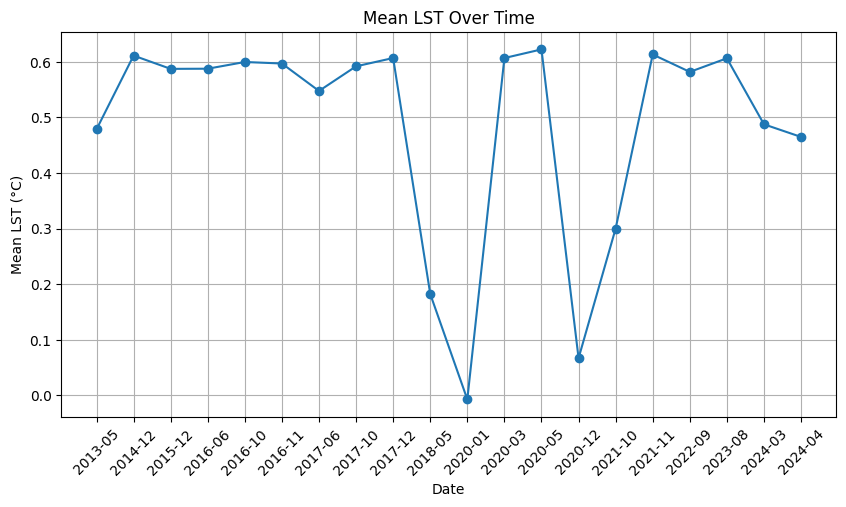

['2013-05', '2014-06', '2014-10', '2016-01', '2016-04', '2016-10', '2017-02', '2018-09', '2018-10', '2019-11', '2019-12', '2020-03', '2020-04', '2020-05', '2020-07', '2021-01', '2021-03', '2022-05', '2023-12']


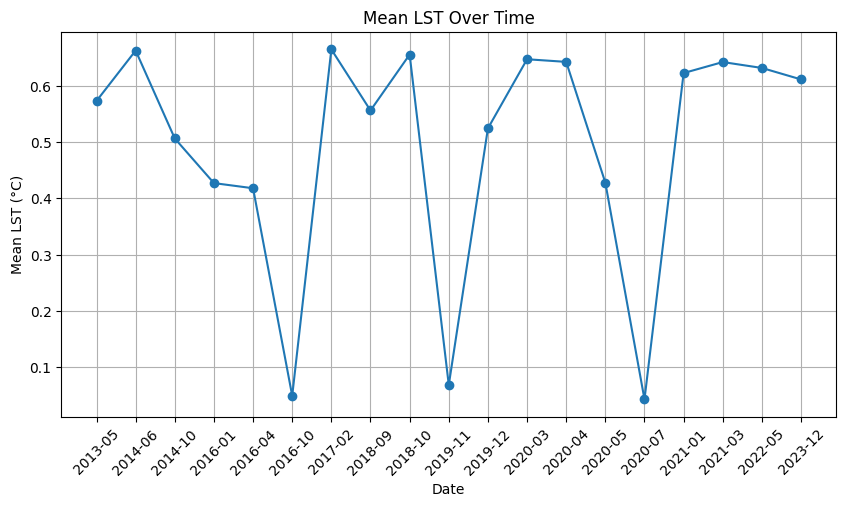

['2013-08', '2014-01', '2014-10', '2015-04', '2016-03', '2016-07', '2016-09', '2017-02', '2017-04', '2017-08', '2017-09', '2018-01', '2018-05', '2018-12', '2019-01', '2019-08', '2019-09', '2020-09', '2020-11', '2021-06', '2021-07', '2021-12', '2023-06', '2024-06']


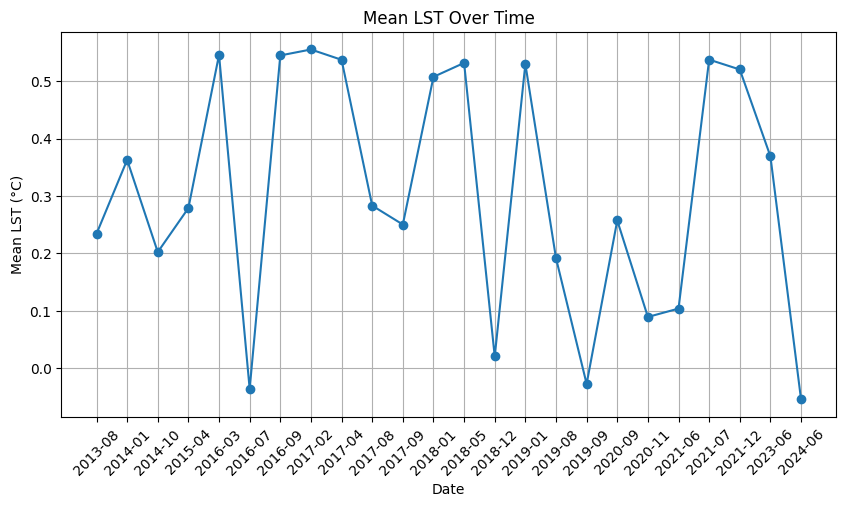

['2013-09', '2015-01', '2015-12', '2016-01', '2016-05', '2016-12', '2017-12', '2018-05', '2018-09', '2018-12', '2019-07', '2020-03', '2020-09', '2020-10', '2021-09', '2023-03', '2023-09']


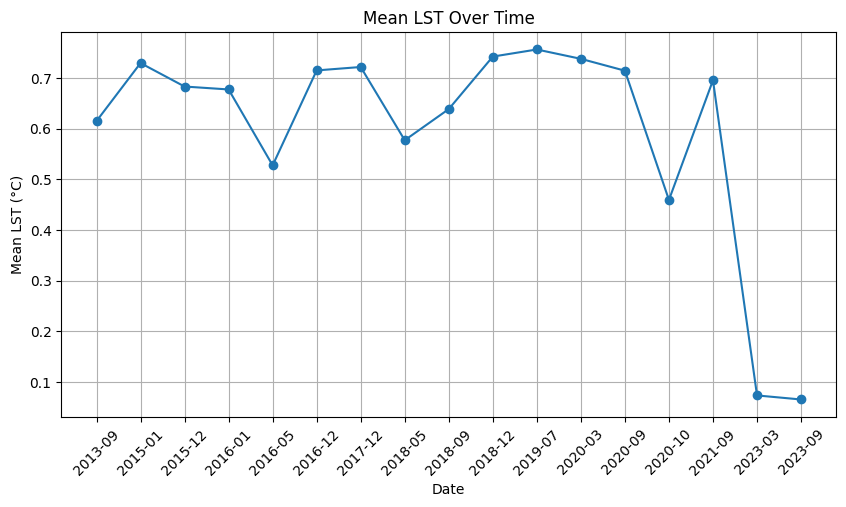

['2013-06', '2014-02', '2015-03', '2015-10', '2016-08', '2017-09', '2017-10', '2018-10', '2019-06', '2019-09', '2019-12', '2021-01', '2021-02', '2021-12', '2022-01', '2023-03', '2023-05', '2023-07', '2024-02', '2024-05']


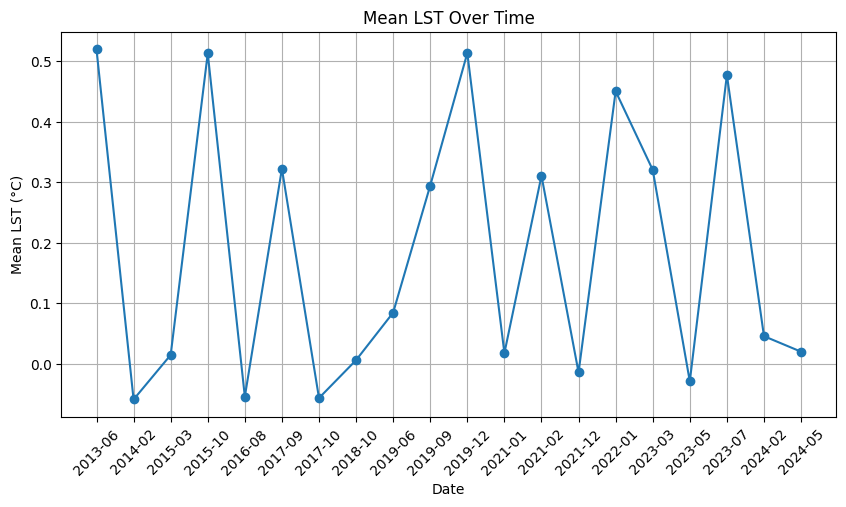

['2013-10', '2014-10', '2015-04', '2015-09', '2016-01', '2016-08', '2016-10', '2017-05', '2017-09', '2019-02', '2019-11', '2021-06', '2022-05', '2022-10', '2023-03', '2023-08', '2023-09']


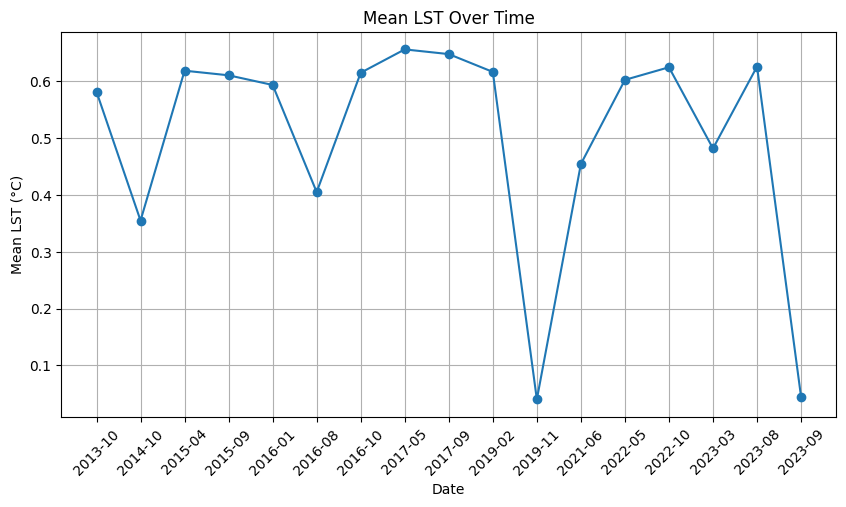

['2013-06', '2013-12', '2014-01', '2014-07', '2014-08', '2015-03', '2015-04', '2015-12', '2016-02', '2017-02', '2017-07', '2018-05', '2019-01', '2019-07', '2019-09', '2020-08', '2021-05', '2021-07', '2022-02', '2022-11', '2022-12', '2023-02', '2023-03', '2023-04', '2023-05', '2023-06', '2024-04', '2024-07']


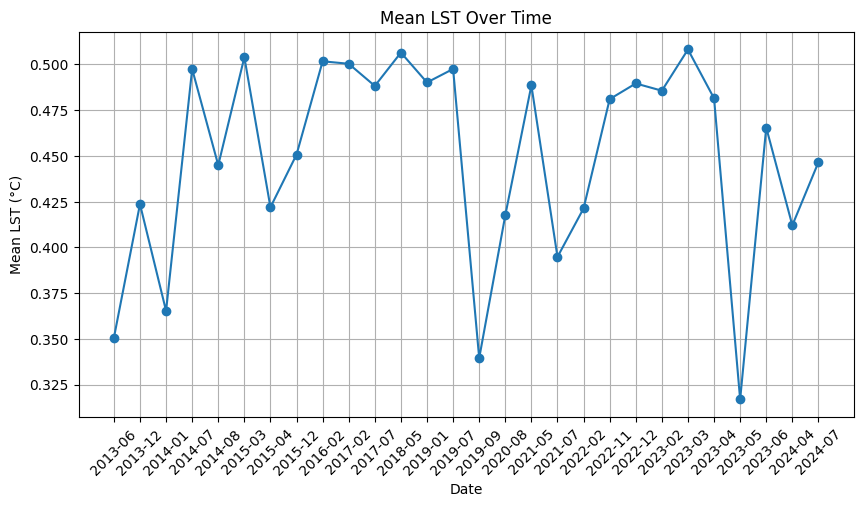

['2013-04', '2013-05', '2014-05', '2014-06', '2015-09', '2015-10', '2015-12', '2016-02', '2016-04', '2017-11', '2018-01', '2018-03', '2018-12', '2019-06', '2019-09', '2020-04', '2021-09', '2021-12', '2022-02', '2022-04', '2022-05', '2022-08', '2022-10', '2023-02', '2023-06', '2023-10', '2024-04']


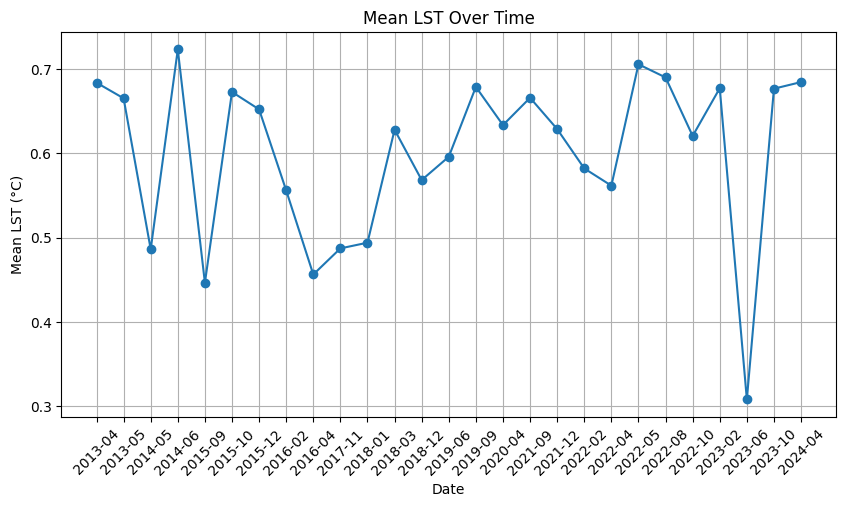

['2013-04', '2013-06', '2014-04', '2014-05', '2014-11', '2015-01', '2015-02', '2015-03', '2015-07', '2015-09', '2016-07', '2017-08', '2017-09', '2017-11', '2018-04', '2019-03', '2019-06', '2019-11', '2021-04', '2021-08', '2021-12', '2022-02', '2022-05', '2022-10', '2024-08']


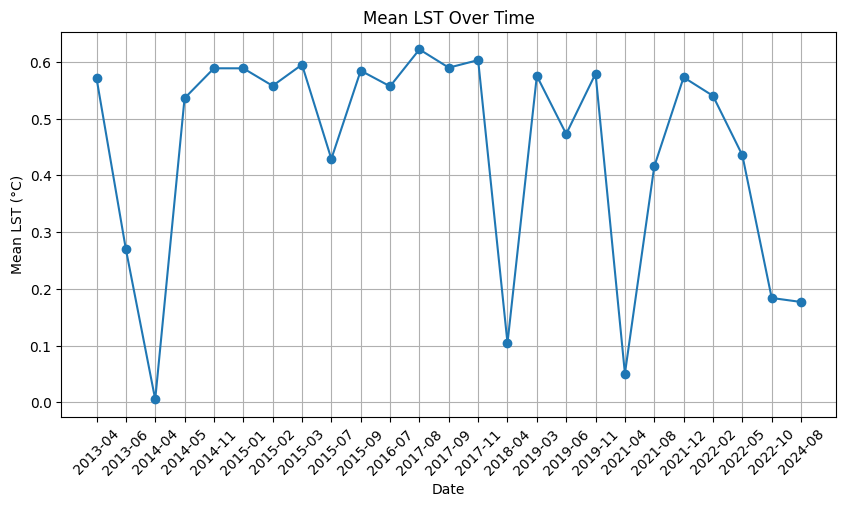

['2013-07', '2014-05', '2014-06', '2014-07', '2015-01', '2015-03', '2015-06', '2015-08', '2015-10', '2016-09', '2016-11', '2017-02', '2017-08', '2018-02', '2019-07', '2020-08', '2021-01', '2022-04', '2022-09', '2023-04', '2023-05', '2023-12', '2024-09']


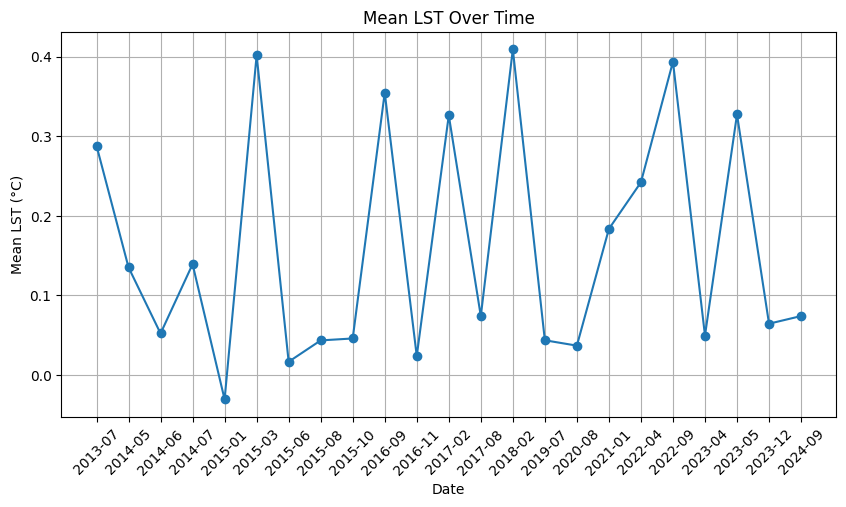

['2013-07', '2013-08', '2014-05', '2014-07', '2015-03', '2015-08', '2015-11', '2016-01', '2017-11', '2018-03', '2018-05', '2018-10', '2018-11', '2019-02', '2020-04', '2020-07', '2021-05', '2021-09', '2022-02', '2022-05', '2022-07', '2022-12', '2023-04', '2023-12', '2024-03', '2024-09']


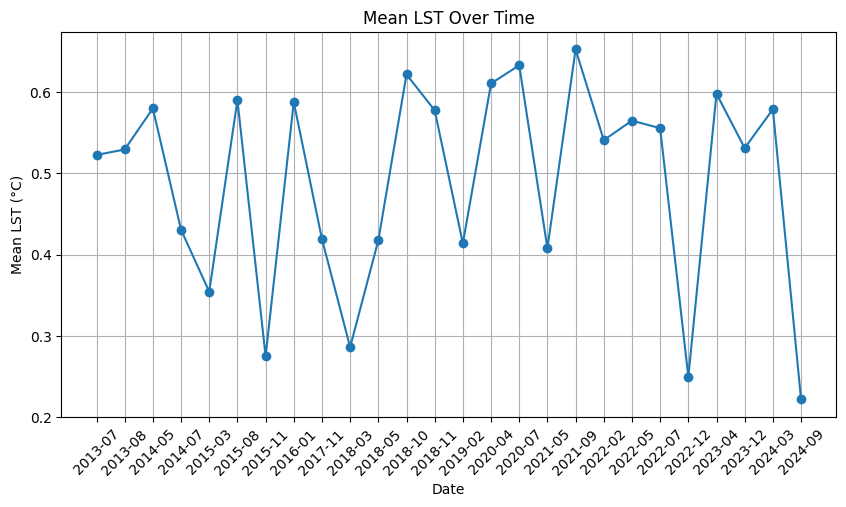

['2014-04', '2016-11', '2017-06', '2019-12', '2021-01']


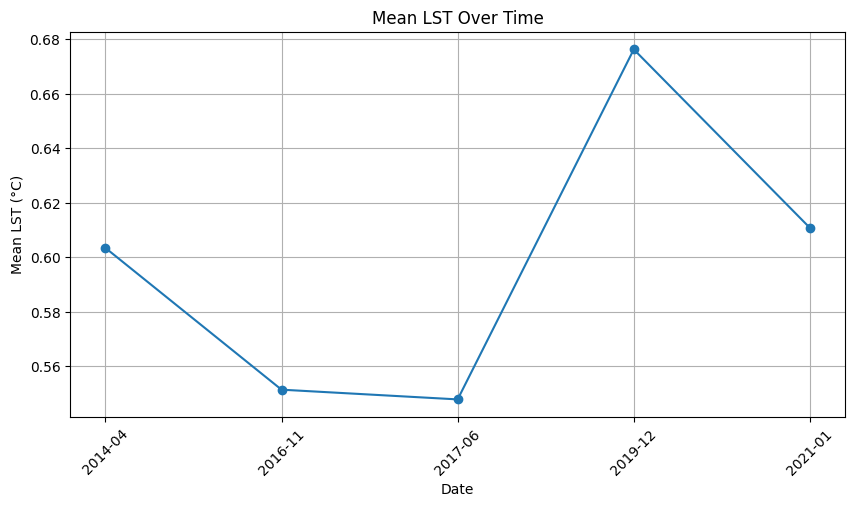

['2013-11', '2014-01', '2014-05', '2014-07', '2014-08', '2014-10', '2017-06', '2018-07', '2018-10', '2019-08', '2021-01', '2022-09', '2023-02', '2023-07', '2023-09', '2024-04']


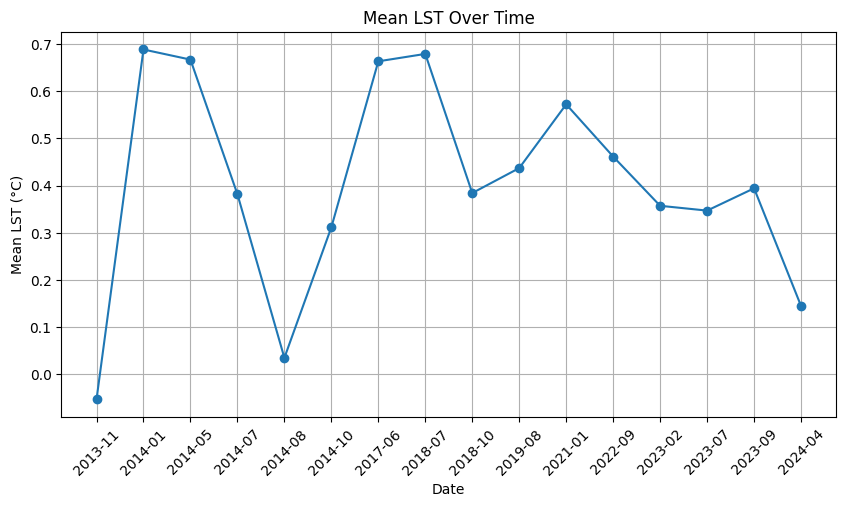

['2014-10', '2015-12', '2016-11', '2017-04', '2017-06', '2017-11', '2018-02', '2018-05', '2019-06', '2019-07', '2019-09', '2019-11', '2020-01', '2020-02', '2020-04', '2021-02', '2021-06', '2022-02', '2022-05', '2022-10', '2022-11', '2023-02', '2023-06', '2023-09', '2024-02', '2024-06']


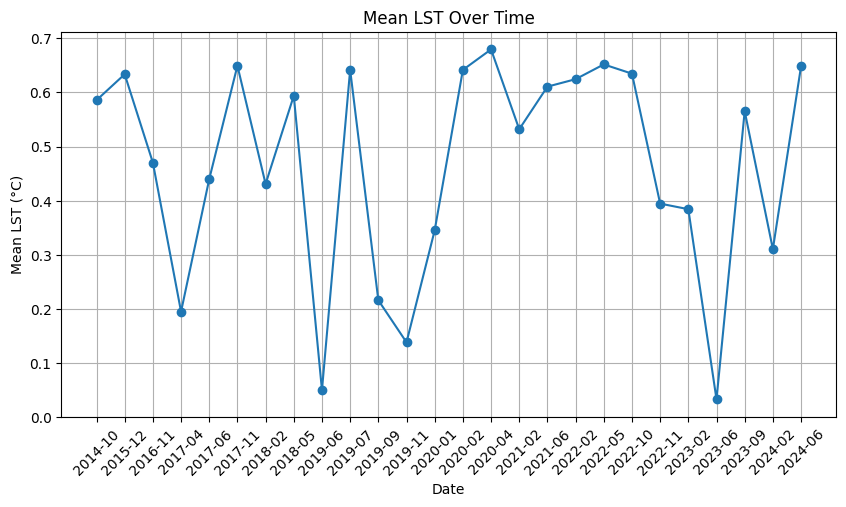

['2013-04', '2013-06', '2014-08', '2015-03', '2021-06', '2022-06', '2023-08', '2024-04']


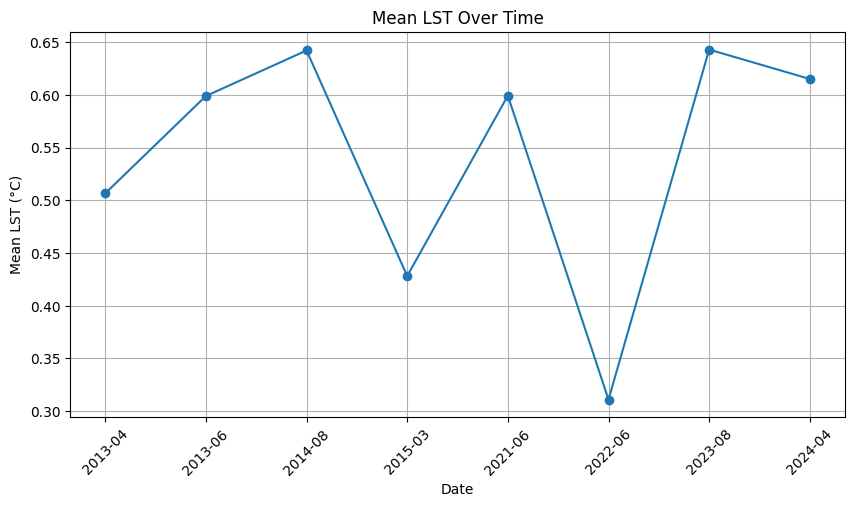

['2013-06', '2013-08', '2013-09', '2014-09', '2015-07', '2016-06', '2016-10', '2017-02', '2017-07', '2017-09', '2018-03', '2018-04', '2018-05', '2018-07', '2019-01', '2019-05', '2019-06', '2020-05', '2020-07', '2020-08', '2021-12', '2023-10', '2024-01']


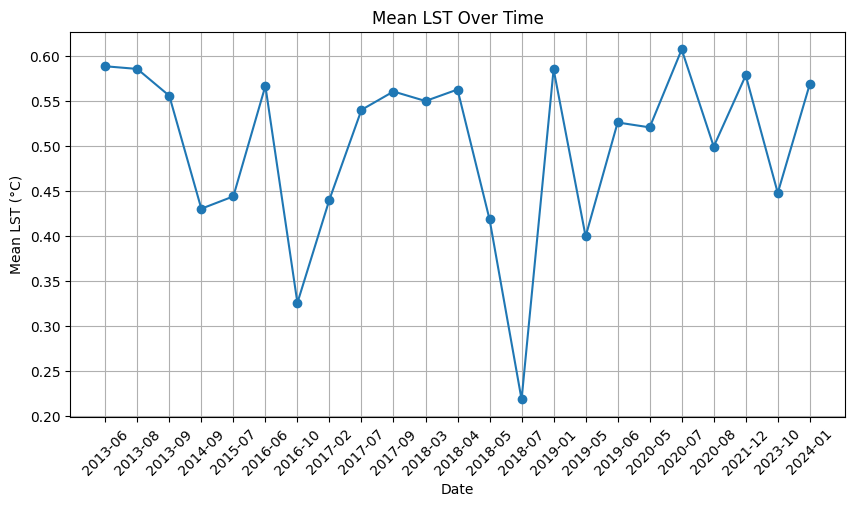

['2017-05', '2022-11', '2023-01', '2023-06']


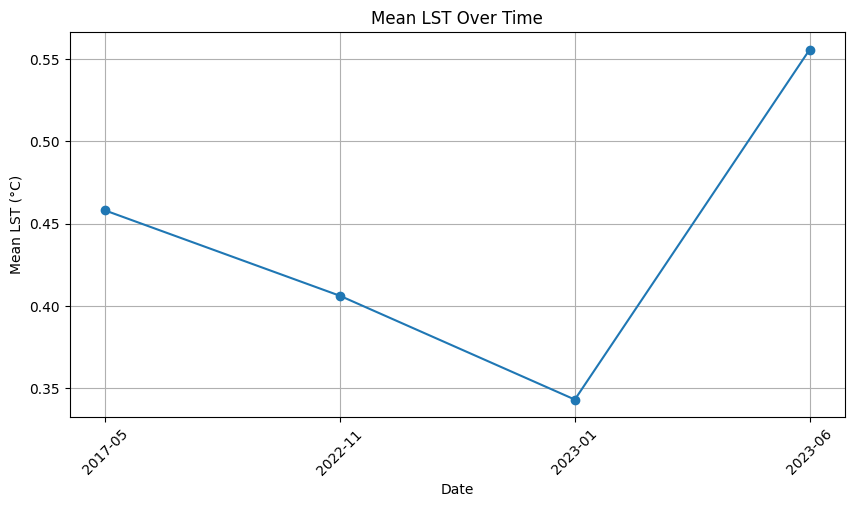

['2013-11', '2014-04', '2016-01', '2017-01', '2018-05', '2018-09', '2018-12', '2019-01', '2020-02', '2020-03', '2020-04', '2020-08', '2020-11', '2022-02', '2022-10']


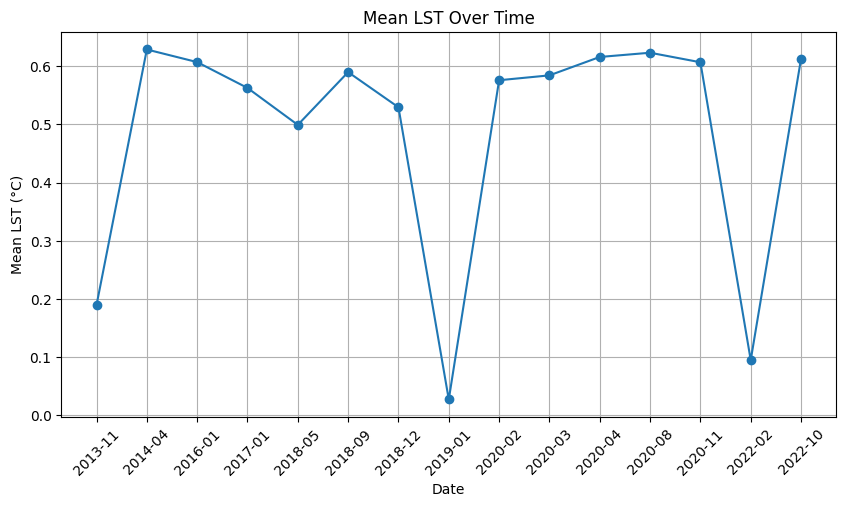

['2013-10', '2015-10', '2018-12', '2020-01', '2020-11', '2021-12', '2022-08']


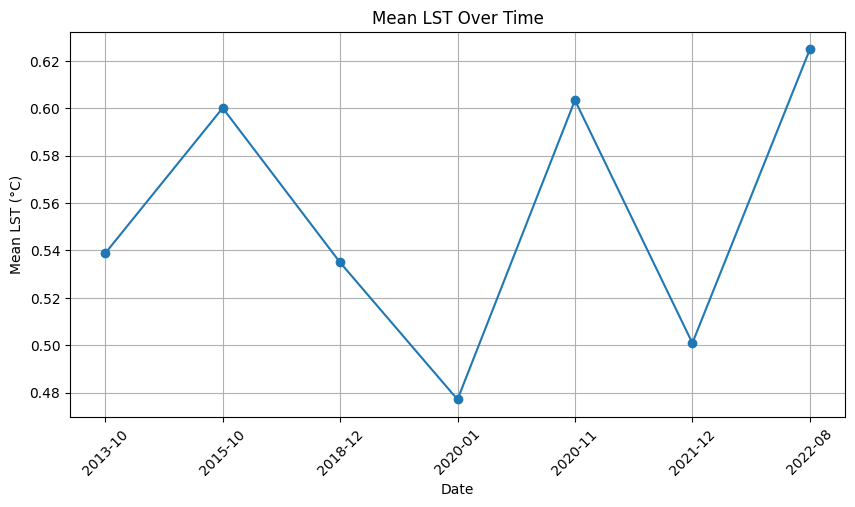

['2013-03', '2014-05', '2014-08', '2015-02', '2015-04', '2015-09', '2016-03', '2017-01', '2017-03', '2017-06', '2018-12', '2019-08', '2019-10', '2020-10', '2021-11', '2022-03', '2023-06', '2023-12']


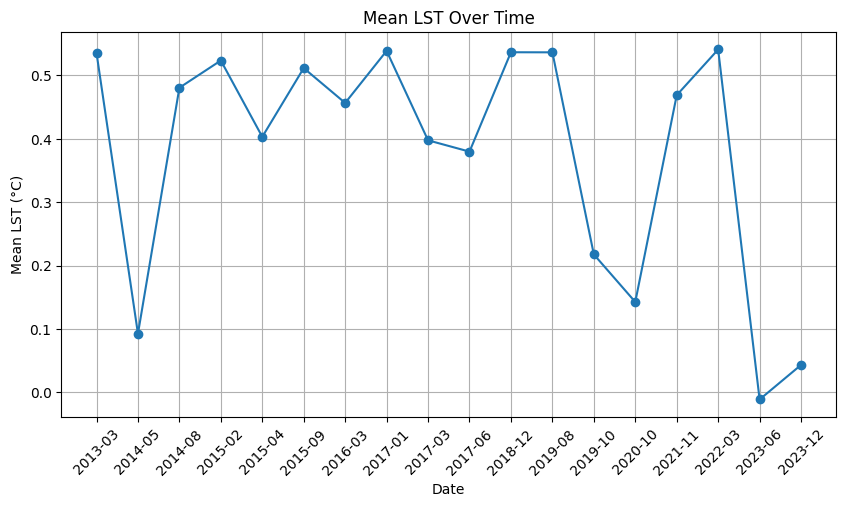

['2013-03', '2013-05', '2015-01', '2015-09', '2015-12', '2016-02', '2016-08', '2017-11', '2018-05', '2018-06', '2019-04', '2019-09', '2019-10', '2021-07', '2022-01', '2022-04', '2023-05', '2023-06', '2023-10', '2024-08']


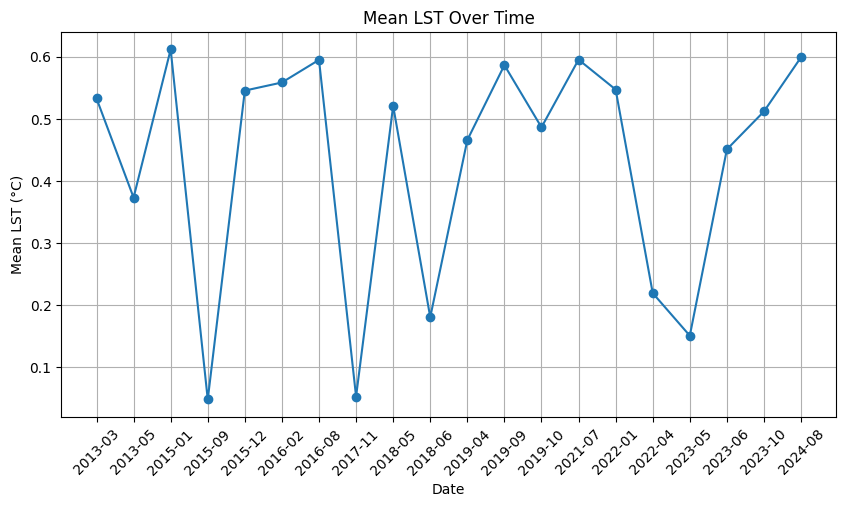

['2014-04', '2014-09', '2014-11', '2015-12', '2016-02', '2016-03', '2017-09', '2018-06', '2019-04', '2019-06', '2020-05', '2021-08', '2022-12', '2023-06', '2024-09']


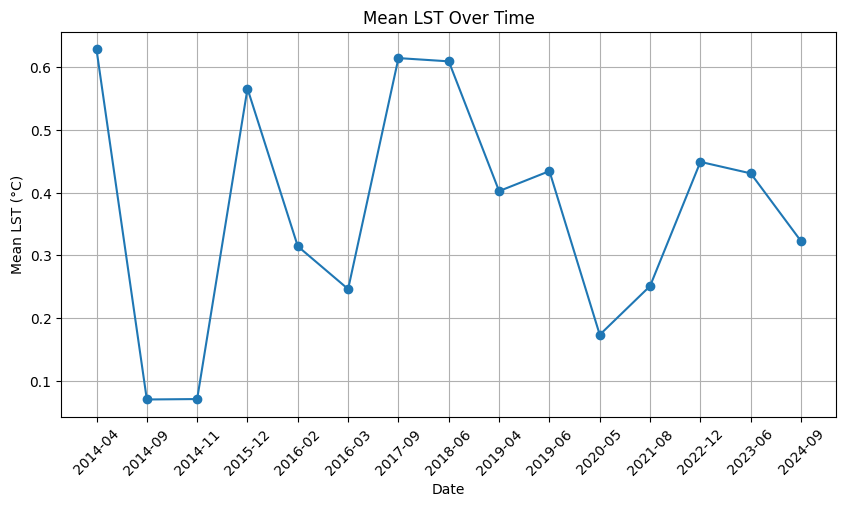

['2014-01', '2014-02', '2015-02', '2015-09', '2015-11', '2016-02', '2017-04', '2017-05', '2017-06', '2018-01', '2019-03', '2020-01', '2020-02', '2020-09', '2021-02', '2022-08', '2022-11', '2022-12', '2023-07']


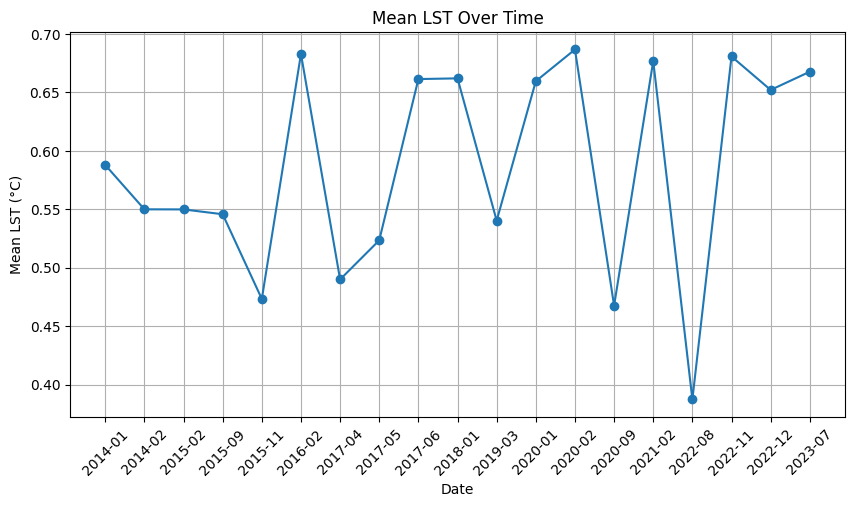

['2013-03', '2013-08', '2014-02', '2014-04', '2014-11', '2016-07', '2018-12', '2019-06', '2020-10', '2021-01', '2021-09', '2022-07', '2024-02']


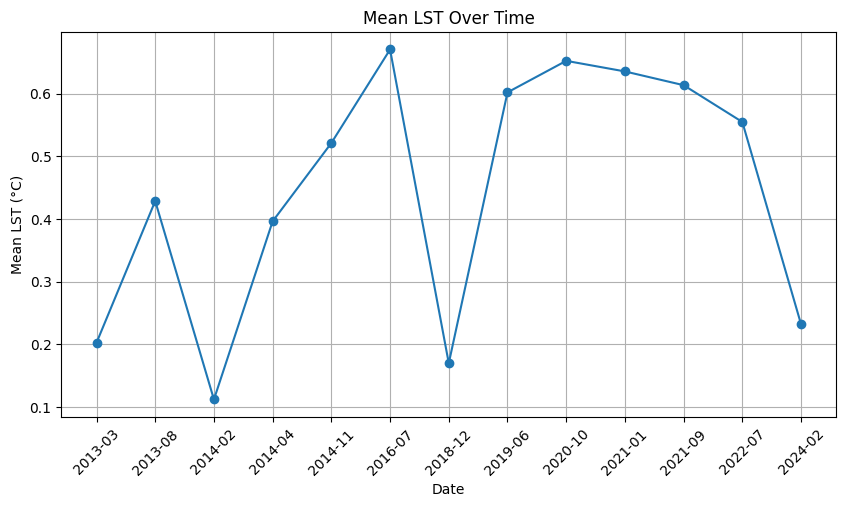

['2013-12', '2014-03', '2014-08', '2015-01', '2016-02', '2016-05', '2017-04', '2017-08', '2018-01', '2018-05', '2018-06', '2018-09', '2019-01', '2020-05', '2020-06', '2020-10', '2021-10', '2023-03', '2023-10', '2024-03']


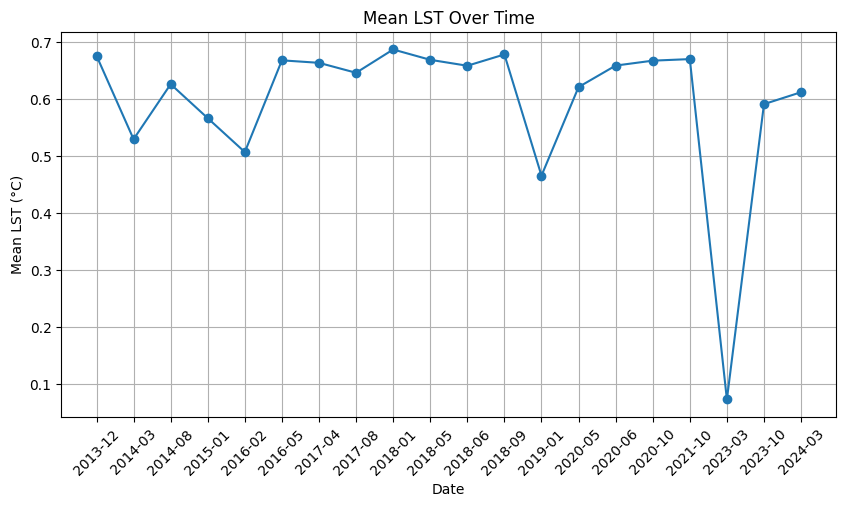

['2013-04', '2013-11', '2014-06', '2015-03', '2015-04', '2015-10', '2017-10', '2017-12', '2018-01', '2018-05', '2018-08', '2018-10', '2019-06', '2019-10', '2020-02', '2021-02', '2022-01', '2022-04', '2022-07', '2023-04']


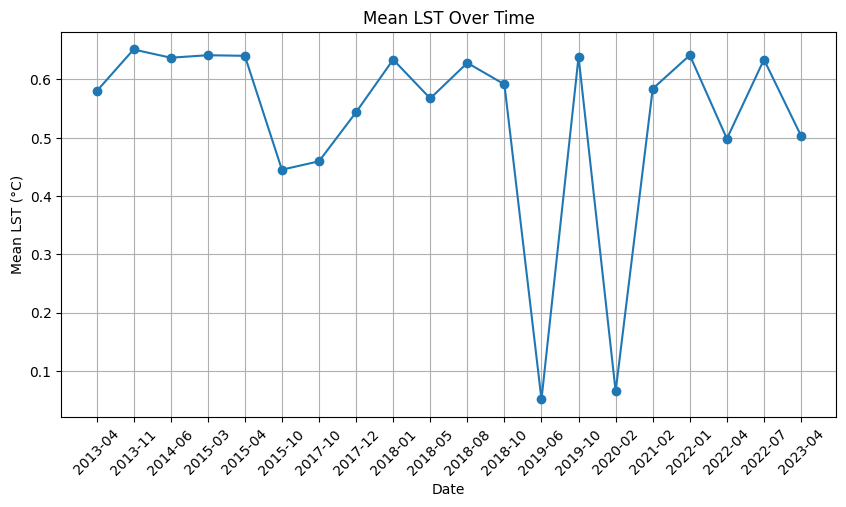

['2013-06', '2014-09', '2016-11', '2017-08', '2018-01', '2018-09', '2019-08', '2019-10', '2020-01', '2020-05', '2021-12', '2023-04', '2023-10']


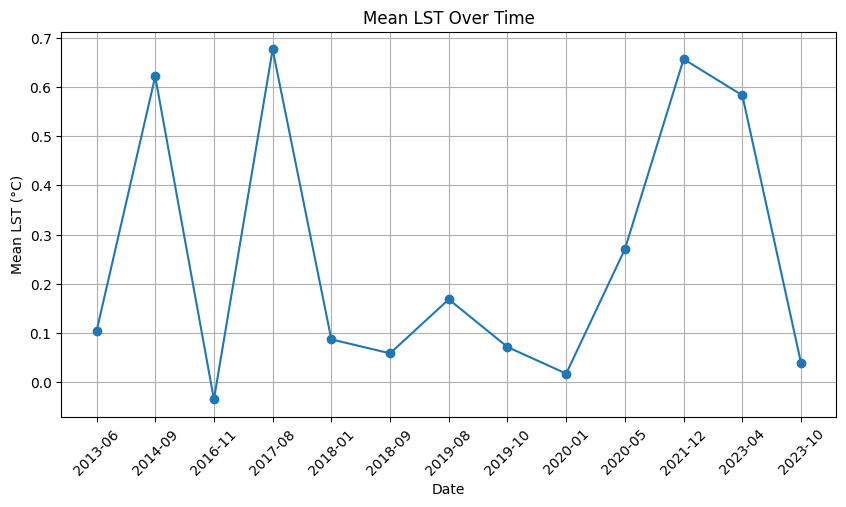

['2015-02', '2015-04', '2017-11', '2018-10', '2019-08', '2020-09', '2022-03', '2022-09', '2023-02', '2024-08', '2024-09']


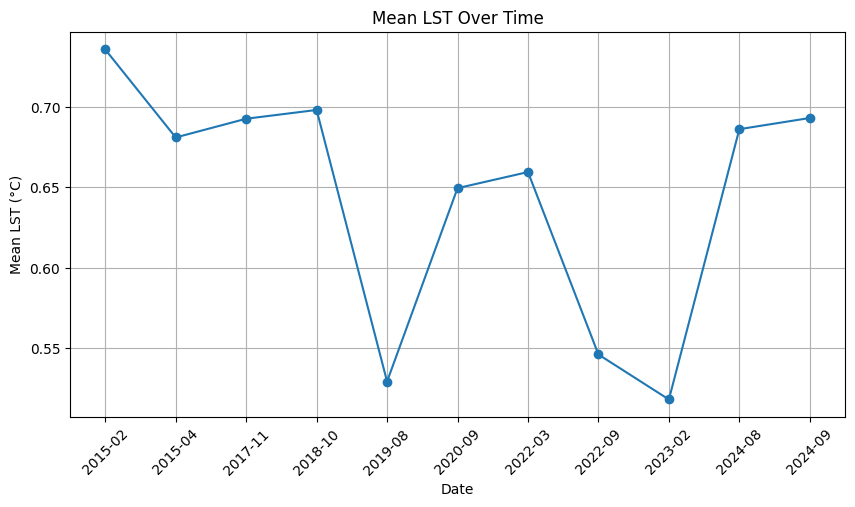

['2013-08', '2014-05', '2014-08', '2016-10', '2017-03', '2017-08', '2021-07', '2024-03']


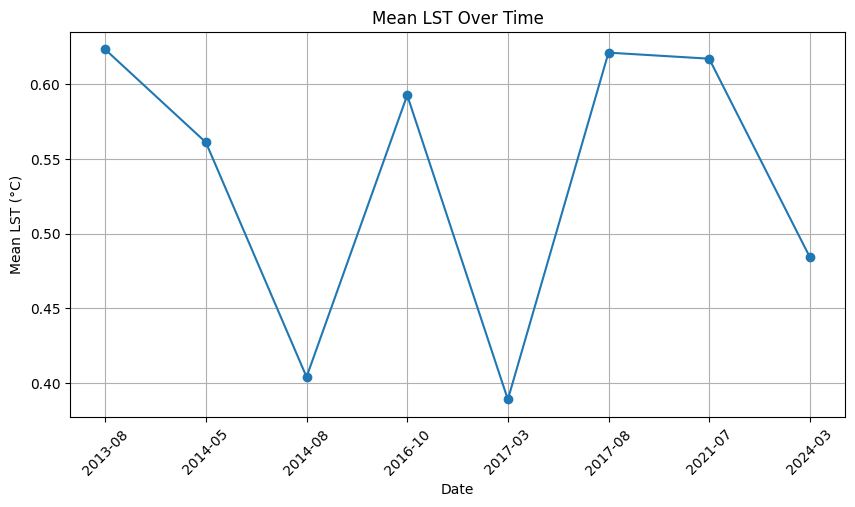

['2013-04', '2014-06', '2015-04', '2015-05', '2015-07', '2016-02', '2016-05', '2017-01', '2017-05', '2017-08', '2018-02', '2018-04', '2018-07', '2019-07', '2020-06', '2021-04', '2022-01', '2022-07', '2023-04', '2024-04']


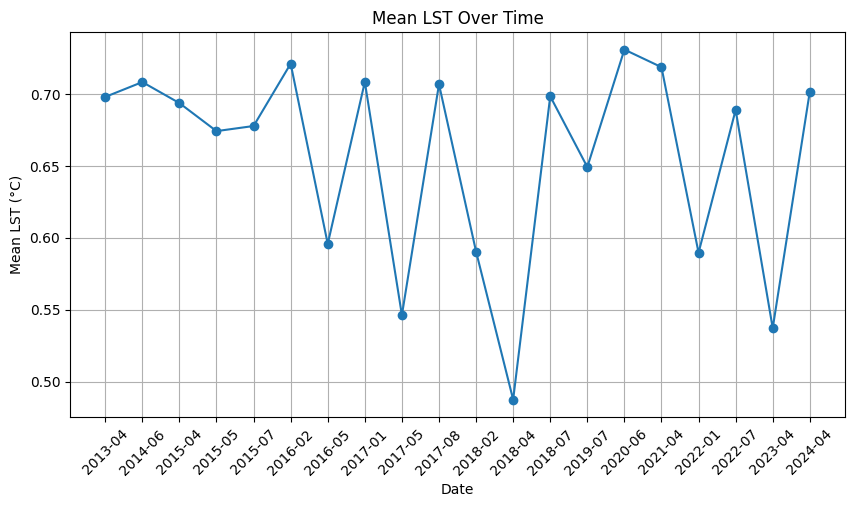

['2013-05', '2015-03', '2015-07', '2016-01', '2016-12', '2018-02', '2018-12', '2019-07', '2019-08', '2023-01']


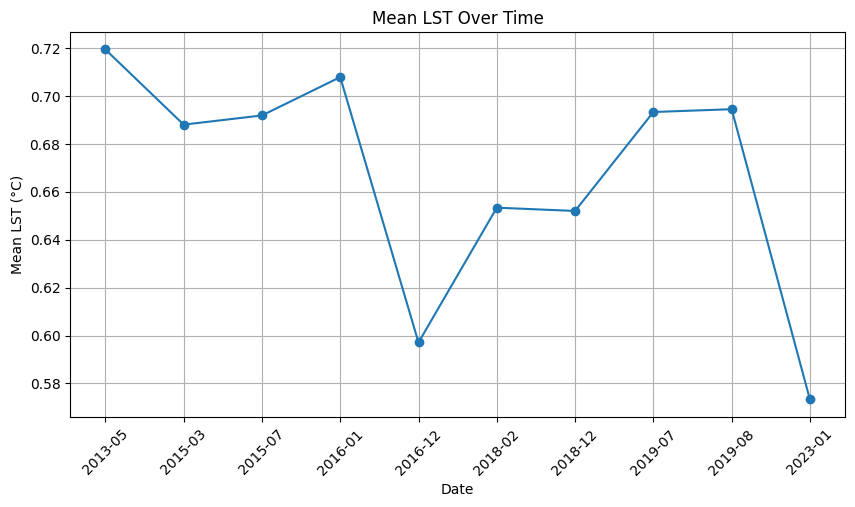

['2013-05', '2014-06', '2014-10', '2015-02', '2015-04', '2015-06', '2016-02', '2016-06', '2016-10', '2017-02', '2017-04', '2017-11', '2018-02', '2018-08', '2018-11', '2018-12', '2019-01', '2019-03', '2019-06', '2019-08', '2019-10', '2020-04', '2020-09', '2021-08', '2021-12', '2022-01', '2022-05', '2022-10', '2023-01', '2023-02', '2024-05', '2024-07']


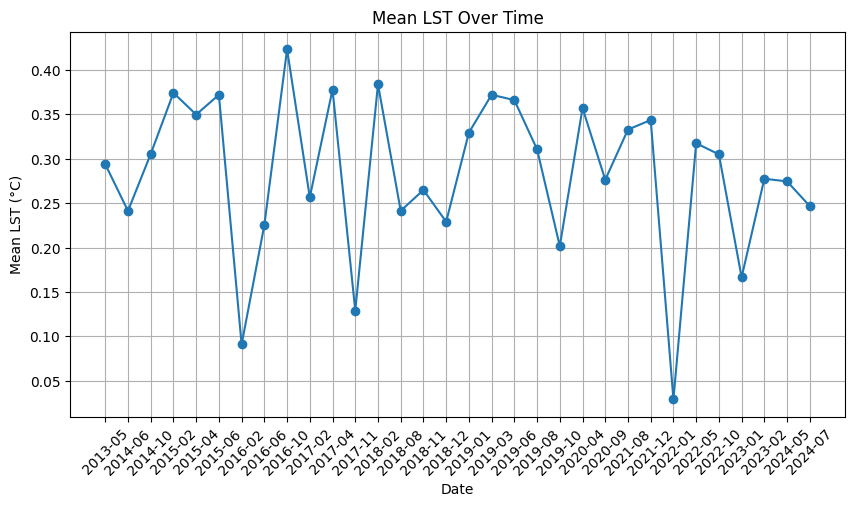

['2013-03', '2013-08', '2013-12', '2014-02', '2014-05', '2015-05', '2015-10', '2016-07', '2016-11', '2017-01', '2017-06', '2017-10', '2018-01', '2018-03', '2018-04', '2018-05', '2018-07', '2019-07', '2019-09', '2019-11', '2020-01', '2020-07', '2021-07', '2022-02', '2022-08', '2022-10', '2023-04', '2023-07', '2023-11', '2024-03']


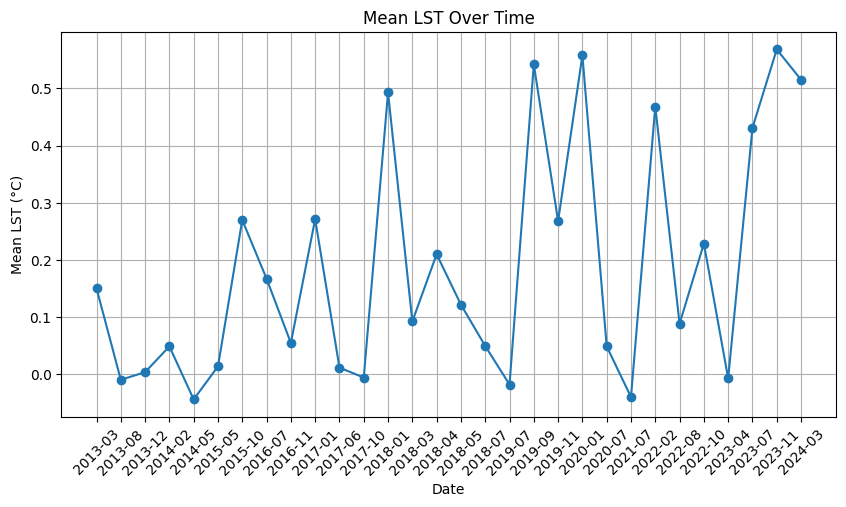

['2013-09', '2016-07', '2017-11', '2018-01', '2019-05', '2019-09', '2020-06', '2021-05', '2023-06']


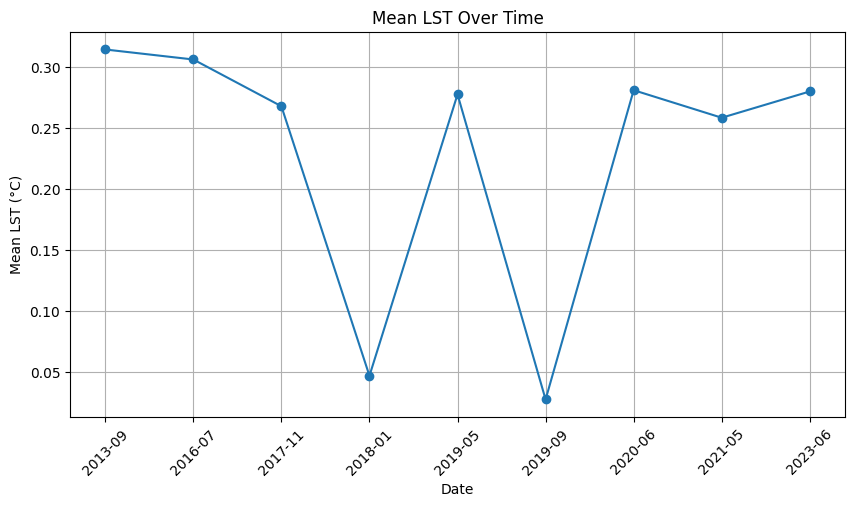

['2013-08', '2014-05', '2014-09', '2014-11', '2015-07', '2015-10', '2016-01', '2016-02', '2016-04', '2016-06', '2016-08', '2016-10', '2016-11', '2017-02', '2017-06', '2017-09', '2017-10', '2017-12', '2018-02', '2018-09', '2020-01', '2020-02', '2020-07', '2020-10', '2020-11', '2021-03', '2021-04', '2021-10', '2021-12', '2022-01', '2022-02', '2022-05', '2022-06', '2022-07', '2022-09', '2023-01', '2023-07', '2023-09', '2024-04', '2024-06', '2024-07']


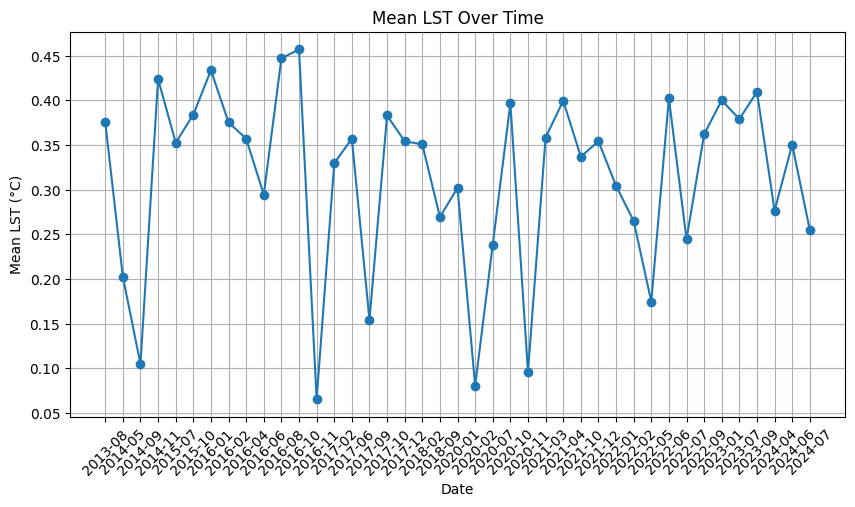

['2014-03', '2014-08', '2015-10', '2016-06', '2016-12', '2017-05', '2017-12', '2018-07', '2019-01', '2019-06', '2019-11', '2020-03', '2021-02', '2021-08', '2022-09', '2022-10', '2023-01', '2024-07', '2024-08']


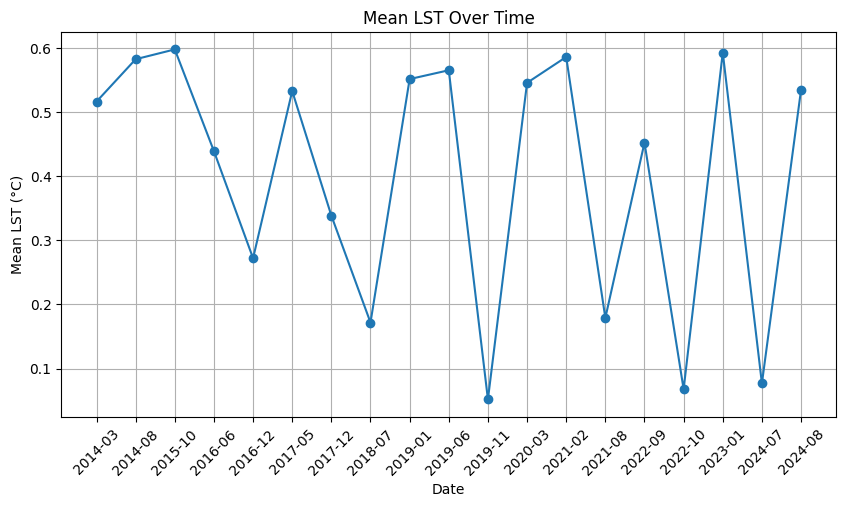

['2013-04', '2013-09', '2015-02', '2015-04', '2015-05', '2015-06', '2016-01', '2016-04', '2017-01', '2017-02', '2017-04', '2017-10', '2020-02', '2020-12', '2021-01', '2021-12', '2022-05', '2022-08', '2022-09', '2023-09', '2024-08']


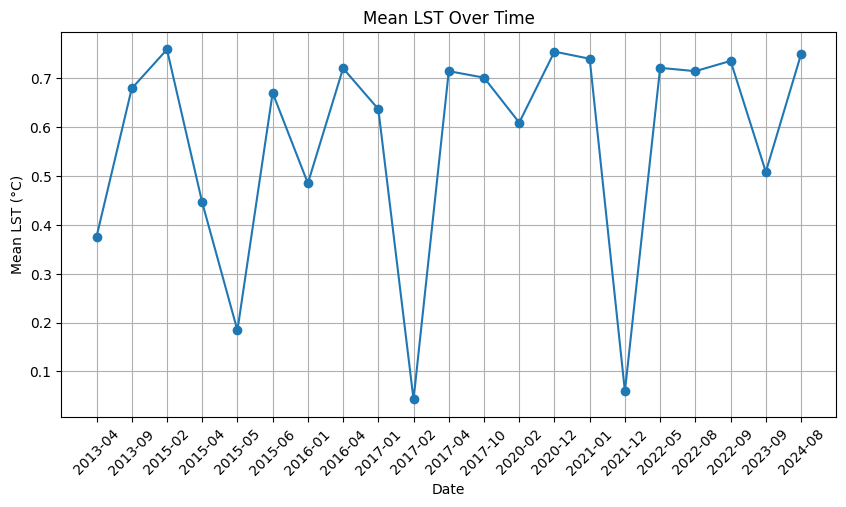

['2013-09', '2013-12', '2017-05', '2019-10', '2021-09', '2022-07', '2023-05']


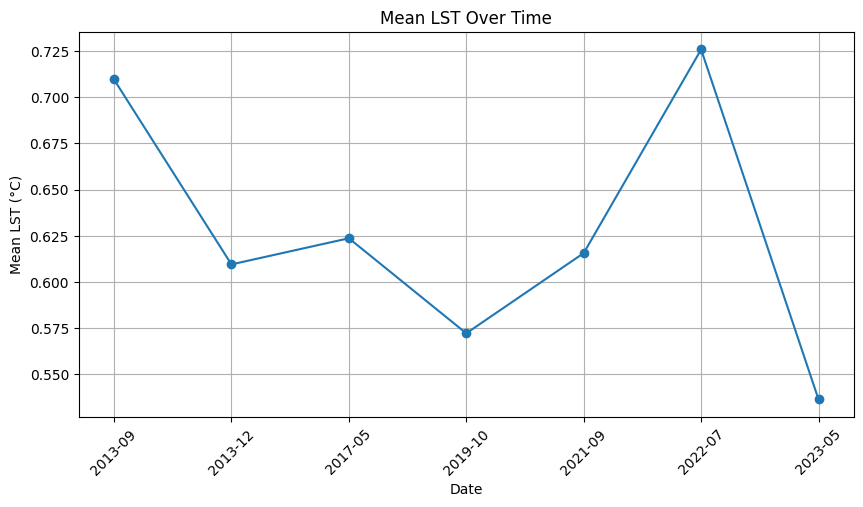

['2013-04', '2014-06', '2014-10', '2015-04', '2015-05', '2016-02', '2016-05', '2016-06', '2019-02', '2019-06', '2019-09', '2022-10', '2022-12']


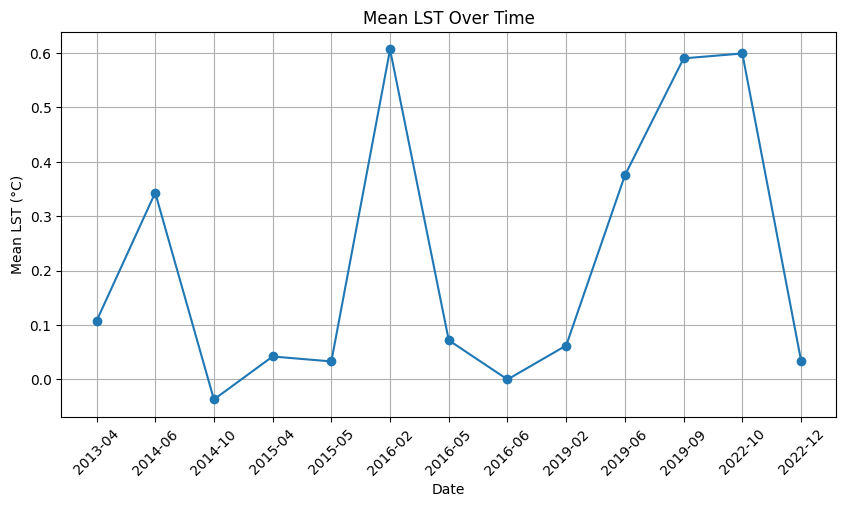

['2013-07', '2014-10', '2015-04', '2015-05', '2015-07', '2015-08', '2016-08', '2017-01', '2017-04', '2017-09', '2017-11', '2018-02', '2018-03', '2019-07', '2019-10', '2019-12', '2021-11', '2022-08', '2022-09', '2023-03', '2023-07', '2023-10', '2023-12', '2024-01', '2024-04', '2024-07']


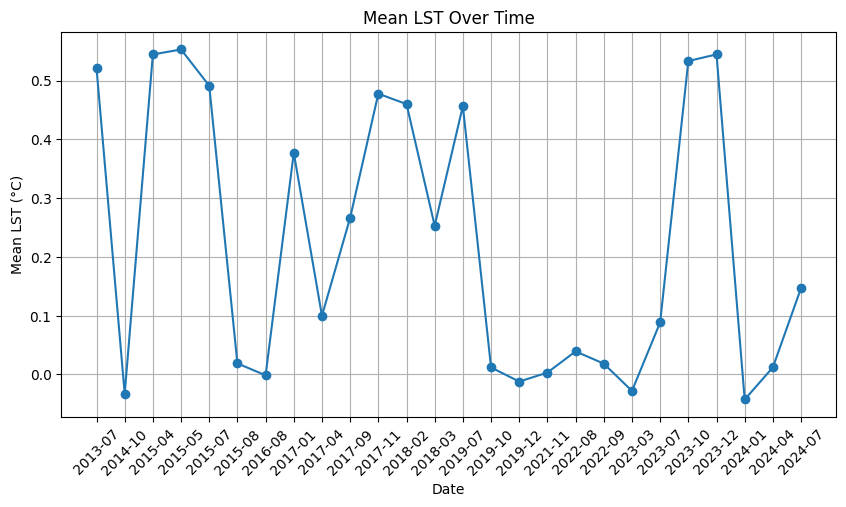

['2013-03', '2013-05', '2013-09', '2014-01', '2014-03', '2016-06', '2016-10', '2017-02', '2017-10', '2018-03', '2018-04', '2018-05', '2018-06', '2018-11', '2019-02', '2019-05', '2019-09', '2019-10', '2020-01', '2020-03', '2020-10', '2020-12', '2021-06', '2021-09', '2022-01', '2022-05', '2022-06', '2023-04', '2023-05', '2023-07', '2023-08', '2024-02', '2024-03', '2024-06', '2024-08']


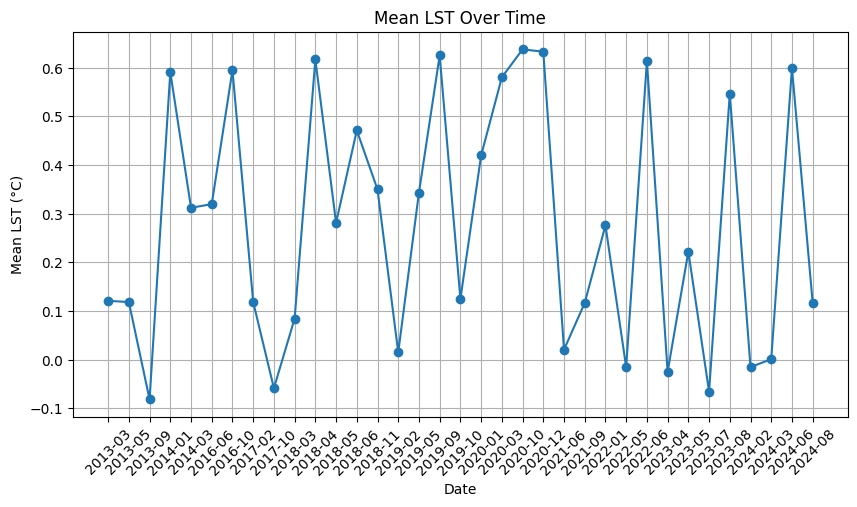

['2014-12', '2015-02', '2015-04', '2015-06', '2015-10', '2018-11', '2019-11', '2020-09', '2020-12', '2021-02', '2021-12', '2022-04', '2022-06', '2022-08', '2022-09', '2023-02', '2024-02', '2024-07']


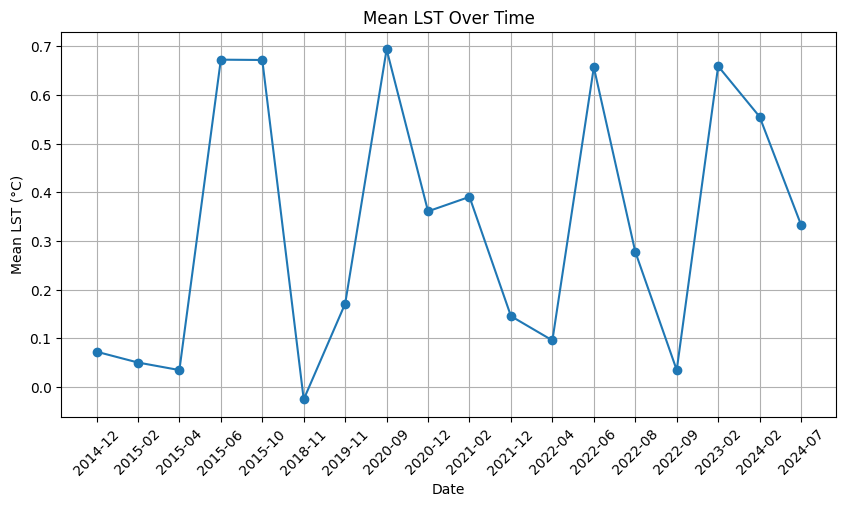

['2014-12', '2015-05', '2015-11', '2017-06', '2021-04', '2021-05', '2021-12', '2024-09']


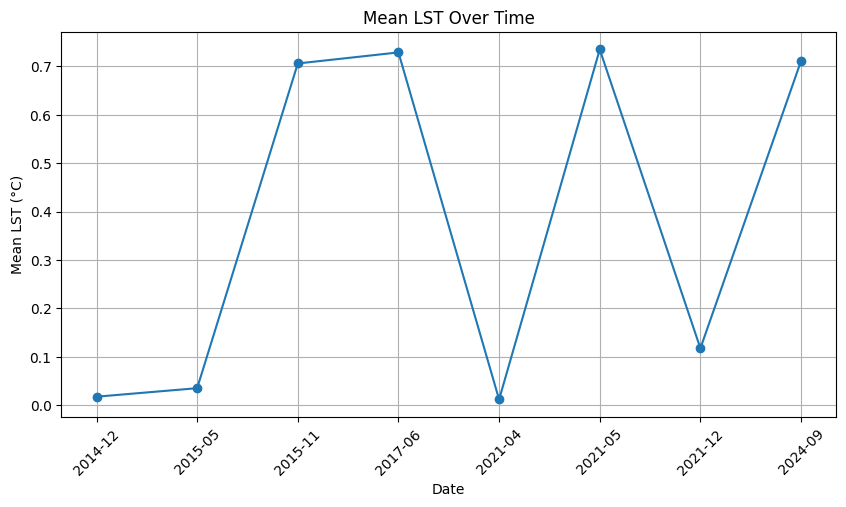

In [44]:


for i,(k, imgs) in enumerate(data.items()):
    dates = []
    mean_lst_values = []
    if len(imgs)>0:
        for j,img in enumerate(imgs):
            date = times[i][j]
            dates.append(date)
            
            mean_lst = np.mean(img)
            mean_lst_values.append(mean_lst)

        
        print(dates)
        sorted_dates, sorted_means = zip(*sorted(zip(dates, mean_lst_values)))
    
        # Plot the mean LST over time
        plt.figure(figsize=(10, 5))
        plt.plot(sorted_dates, sorted_means, marker='o')
        plt.xlabel("Date")
        plt.ylabel("Mean LST (°C)")
        plt.title("Mean LST Over Time")
        plt.xticks(rotation=45)
        plt.grid()
        plt.show()
    

## Clustering

In [7]:
lat, lon = get_lat_lon(labels)

In [8]:
rivers_folder = '../data/external/shp/river_cells_oficial'
rivs, x_coords, y_coords, z_coords = get_rivers_altitude(rivers_folder,filt=filter_alt)

In [9]:
data = pd.DataFrame({
    'river_name': rivs,
    'x_mean': [np.mean(coords) for coords in x_coords],
    'y_mean': [np.mean(coords) for coords in y_coords],
    'z_mean': [np.mean(coords) for coords in z_coords],
    'z_std': [np.std(coords) for coords in z_coords]
})

In [10]:
scaler = StandardScaler()
features = ['x_mean', 'y_mean', 'z_mean', 'z_std']
data_scaled = scaler.fit_transform(data[features])

In [11]:
kmeans = KMeans(n_clusters=3, random_state=42)
data['cluster'] = kmeans.fit_predict(data_scaled)

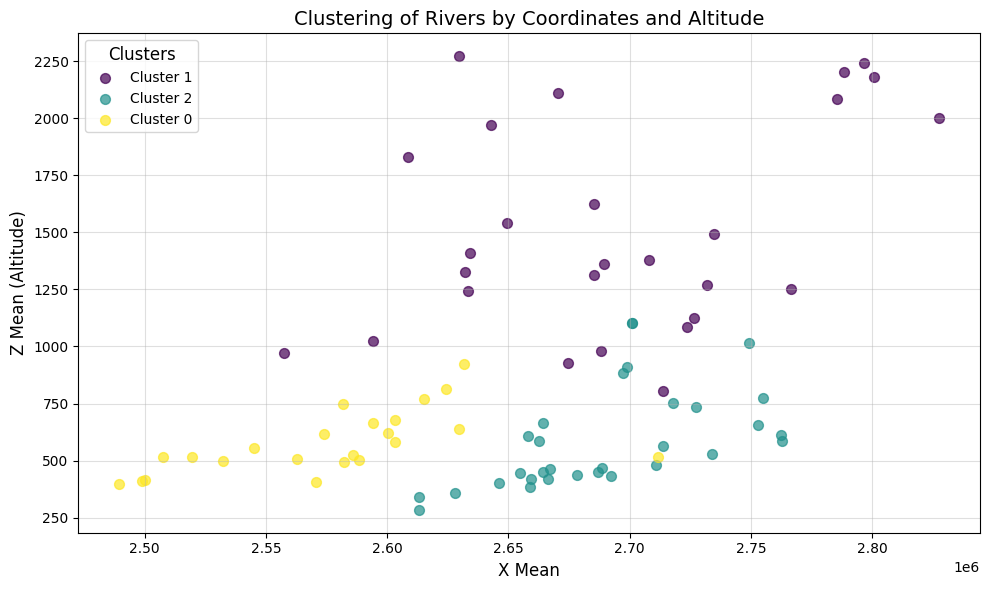

In [12]:

# Get unique clusters
clusters = data['cluster'].unique()
colors = plt.cm.viridis(np.linspace(0, 1, len(clusters)))

# Create the scatter plot
plt.figure(figsize=(10, 6))
for cluster, color in zip(clusters, colors):
    cluster_data = data[data['cluster'] == cluster]
    plt.scatter(
        cluster_data['x_mean'],
        cluster_data['z_mean'],
        label=f'Cluster {cluster}',
        color=color,
        s=50,
        alpha=0.7
    )

# Add labels and title
plt.xlabel('X Mean', fontsize=12)
plt.ylabel('Z Mean (Altitude)', fontsize=12)
plt.title('Clustering of Rivers by Coordinates and Altitude', fontsize=14)

# Add legend
plt.legend(title='Clusters', fontsize=10, title_fontsize=12, loc='best')

# Add grid and show plot
plt.grid(alpha=0.4)
plt.tight_layout()
plt.savefig("../plots/clusters.png")
plt.show()


In [13]:
data

,river_name,x_mean,y_mean,z_mean,z_std,cluster
0,cell_37,2.634302e+06,1.126087e+06,1407.912820,475.428692,1
1,cell_8,2.754987e+06,1.235254e+06,775.058834,329.676656,2
2,cell_33,2.594237e+06,1.191394e+06,665.478815,90.379434,0
3,cell_9,2.489617e+06,1.115771e+06,396.220703,30.800577,0
4,cell_42,2.796671e+06,1.166087e+06,2243.596100,303.644251,1
...,...,...,...,...,...,...
76,cell_29,2.670296e+06,1.153902e+06,2110.260424,343.443958,1
77,cell_47,2.581592e+06,1.228223e+06,747.247681,138.208816,0
78,cell_4,2.734580e+06,1.181946e+06,1493.389214,449.083702,1
79,cell_22,2.582045e+06,1.211575e+06,493.489637,76.743138,0


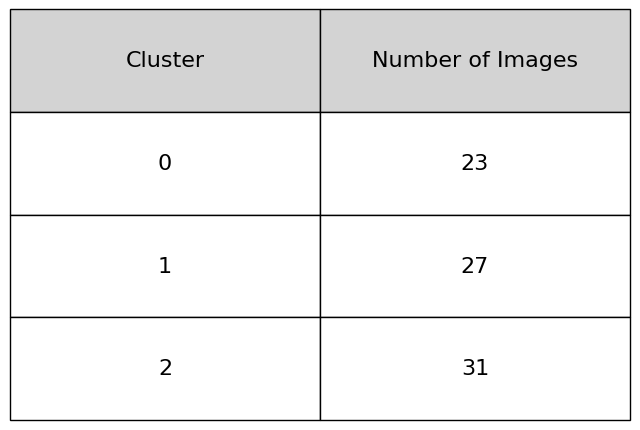

In [14]:
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.table import Table

# Count the number of data points per cluster
cluster_counts = data['cluster'].value_counts().sort_index()

# Create a DataFrame for the table
table_data = pd.DataFrame({
    'Cluster': cluster_counts.index,
    'Number of Images': cluster_counts.values
})

# Create a figure
fig, ax = plt.subplots(figsize=(8, 4))
ax.set_axis_off()

# Create the table
tbl = Table(ax, bbox=[0, 0, 1, 1])

# Add the header row
col_labels = list(table_data.columns)
for i, label in enumerate(col_labels):
    tbl.add_cell(-1, i, 1, 0.4, text=label, loc='center', facecolor='lightgray', edgecolor='black')# fontsize=12)
    tbl._cells[(-1, i)].get_text().set_fontsize(16)

# Add the data rows
for row_idx, (index, row) in enumerate(table_data.iterrows()):
    for col_idx, value in enumerate(row):
        tbl.add_cell(row_idx, col_idx, 1, 0.4, text=value, loc='center', edgecolor='black')#, fontsize=10)
        tbl._cells[(row_idx, col_idx)].get_text().set_fontsize(16)

# Auto-adjust cell dimensions
tbl.auto_set_font_size(False)
tbl.set_fontsize(16)
tbl.scale(1.2, 1.5)

# Add the table to the plot
ax.add_table(tbl)

# Set a title
#plt.title("Number of Images per Cluster", fontsize=14, fontweight='bold', pad=20)

# Save and show the table
plt.savefig("../plots/cluster_table.png", bbox_inches='tight')
plt.show()


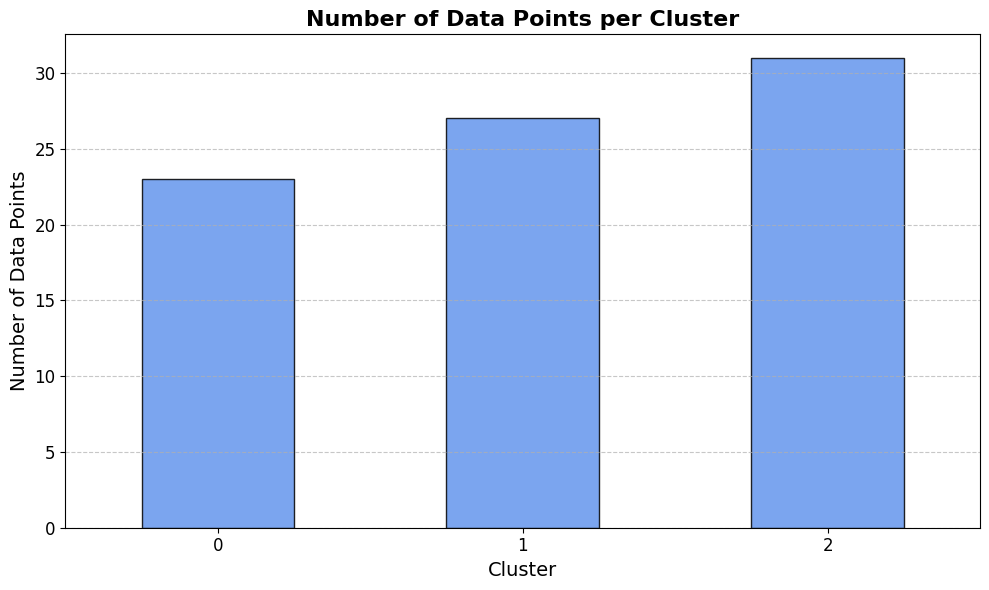

In [15]:
# Count the number of data points per cluster
cluster_counts = data['cluster'].value_counts().sort_index()

# Create the bar chart
plt.figure(figsize=(10, 6))
cluster_counts.plot(
    kind='bar',
    color='cornflowerblue',
    edgecolor='black',
    alpha=0.85
)

# Add labels and title
plt.xlabel('Cluster', fontsize=14)
plt.ylabel('Number of Data Points', fontsize=14)
plt.title('Number of Data Points per Cluster', fontsize=16, fontweight='bold')

# Customize ticks
plt.xticks(fontsize=12, rotation=0)
plt.yticks(fontsize=12)

# Add grid lines for better readability
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Show the plot
plt.tight_layout()
plt.show()


## Balanced split

In [16]:
ordered_clusters=[]
for lab in labels:
    cl=data[data.river_name==lab].cluster.values[0]
    ordered_clusters.append(cl)


In [17]:
len(ordered_clusters)

1378

In [18]:
split_df = pd.DataFrame({
    'label': labels,
    'date': total_times['lst'],
    'cluster': ordered_clusters
})
split_df['index'] = split_df.index

In [24]:
import pandas as pd
import numpy as np
import math
import json
import os

# Directory to save the splits
output_dir = "../data/external/splits/"
os.makedirs(output_dir, exist_ok=True)

# Function to map dates to seasons
def map_season(date):
    month = pd.to_datetime(date).month
    if month in [12, 1, 2]:
        return 'Winter'
    elif month in [3, 4, 5]:
        return 'Spring'
    elif month in [6, 7, 8]:
        return 'Summer'
    elif month in [9, 10, 11]:
        return 'Autumn'

# Add a season column to split_df
split_df['season'] = split_df['date'].apply(map_season)
split_df['year'] = pd.to_datetime(split_df['date']).dt.year

# Number of splits to generate
n_splits = 5

for split_id in range(n_splits):
    train_indices, val_indices, test_indices = [], [], []

    # Change the seed for reproducibility
    seed = split_id + 42

    # Group by cluster, season, and year
    grouped = split_df.groupby(['cluster', 'season', 'year'])

    # Calculate global proportions
    total_rows = len(split_df)
    target_train = int(0.6 * total_rows)
    target_val = int(0.2 * total_rows)
    target_test = total_rows - target_train - target_val

    # Initial split by group
    for _, group in grouped:
        group = group.sample(frac=1, random_state=seed).reset_index(drop=True)

        # Calculate sizes for train, val, and test
        n = len(group)
        n_train = math.floor(0.6 * n)
        n_val = math.floor(0.2 * n)
        n_test = n - n_train - n_val

        train_indices.extend(group['index'][:n_train])
        val_indices.extend(group['index'][n_train:n_train + n_val])
        test_indices.extend(group['index'][n_train + n_val:])

    # Adjust splits to match exact global proportions
    def redistribute(indices, target_size, source1, source2):
        while len(indices) < target_size:
            if source1:
                indices.append(source1.pop())
            elif source2:
                indices.append(source2.pop())

    # Adjust train
    redistribute(train_indices, target_train, val_indices, test_indices)
    # Adjust validation
    redistribute(val_indices, target_val, test_indices, train_indices)
    # Adjust test
    redistribute(test_indices, target_test, train_indices, val_indices)

    # Validate final split sizes
    total_assigned = len(train_indices) + len(val_indices) + len(test_indices)
    assert total_assigned == total_rows, f"Mismatch in total rows: {total_assigned} != {total_rows}"
    # Validate representation
    train_clusters = split_df.loc[train_indices, 'cluster'].unique()
    val_clusters = split_df.loc[val_indices, 'cluster'].unique()
    test_clusters = split_df.loc[test_indices, 'cluster'].unique()

    train_seasons = split_df.loc[train_indices, 'season'].unique()
    val_seasons = split_df.loc[val_indices, 'season'].unique()
    test_seasons = split_df.loc[test_indices, 'season'].unique()

    train_years = split_df.loc[train_indices, 'year'].unique()
    val_years = split_df.loc[val_indices, 'year'].unique()
    test_years = split_df.loc[test_indices, 'year'].unique()

    print(f"Split {split_id + 1}:")
    print(f"  Train Clusters={train_clusters}, Seasons={train_seasons}, Years={train_years}")
    print(f"  Val Clusters={val_clusters}, Seasons={val_seasons}, Years={val_years}")
    print(f"  Test Clusters={test_clusters}, Seasons={test_seasons}, Years={test_years}")

    print(f"Split {split_id + 1}: Train={len(train_indices)}, Val={len(val_indices)}, Test={len(test_indices)}")

    # Save the indices for each split
    indices = {
        'train': train_indices,
        'val': val_indices,
        'test': test_indices
    }

    with open(os.path.join(output_dir, f"split_{split_id + 1}_indices.json"), 'w') as f:
        json.dump(indices, f)

    print(f"Saved split {split_id + 1} with Train={len(train_indices)}, Val={len(val_indices)}, Test={len(test_indices)}")


The history saving thread hit an unexpected error (OperationalError('attempt to write a readonly database')).History will not be written to the database.
Split 1:
  Train Clusters=[0 1 2], Seasons=['Autumn' 'Spring' 'Summer' 'Winter'], Years=[2013 2014 2015 2016 2017 2018 2019 2020 2021 2022 2023 2024]
  Val Clusters=[0 1 2], Seasons=['Autumn' 'Spring' 'Summer' 'Winter'], Years=[2013 2014 2015 2016 2017 2018 2019 2020 2021 2022 2023 2024]
  Test Clusters=[0 1 2], Seasons=['Autumn' 'Spring' 'Summer' 'Winter'], Years=[2013 2014 2015 2016 2017 2018 2019 2020 2021 2022 2023 2024]
Split 1: Train=826, Val=275, Test=277
Saved split 1 with Train=826, Val=275, Test=277
Split 2:
  Train Clusters=[0 1 2], Seasons=['Autumn' 'Spring' 'Summer' 'Winter'], Years=[2013 2014 2015 2016 2017 2018 2019 2020 2021 2022 2023 2024]
  Val Clusters=[0 1 2], Seasons=['Autumn' 'Spring' 'Summer' 'Winter'], Years=[2013 2014 2015 2016 2017 2018 2019 2020 2021 2022 2023 2024]
  Test Clusters=[0 1 2], Seasons=['Autumn'

### Check splits

In [25]:
# Adapt input shapes
inputs_d = [total_data[inp] for inp in inputs]
expanded_images = []
for img in inputs_d:
    if img.ndim == 3:  # Case where image is (n, 256, 256) (single-channel)
        expanded_images.append(np.expand_dims(img, axis=-1))  # Expand to add an extra channel
    elif img.ndim == 4:  # Case where image already has multiple channels (n, 256, 256, c)
        expanded_images.append(img)  # Leave the image as it is
combined_input = np.concatenate(expanded_images, axis=-1) # Concatenate all images along the last axis (channels)
input_data = combined_input # The final combined input is stored in input_data
print('Final shape', input_data.shape)

Final shape (1378, 128, 128, 7)


In [26]:
# Seleccionar el split a cargar
split_num = 1  
split='stratified'
filt_alt = False
train_index, validation_index, test_index = get_split_index(split, input_data, data_targets, labels, split_num, filt_alt)
    
validation_input = input_data[validation_index, :] / 255.0  # Normalize inputs
validation_target = data_targets[validation_index]
test_input = input_data[test_index, :] / 255.0  # Normalize inputs
test_target = data_targets[test_index]
train_input = input_data[train_index, :] / 255.0  # Normalize inputs
train_target = data_targets[train_index]
# Comprobar las formas
print("Val data shape:", validation_input.shape)
print("Train data shape:", train_input.shape)
print("Test data shape:", test_input.shape)


yes !!!!!!!!!!
Val data shape: (275, 128, 128, 7)
Train data shape: (826, 128, 128, 7)
Test data shape: (277, 128, 128, 7)


In [28]:
import json
from collections import defaultdict
from datetime import datetime

# Example: List of all dates and indices
dates = total_times['lst']
indices = list(range(len(dates)))  # Indices corresponding to dates

# Directory where split indices are stored
input_dir = "../data/external/splits/"
split_indices_files = ["split_1_indices.json", "split_2_indices.json", "split_3_indices.json", "split_4_indices.json", "split_5_indices.json"]  # Example split files

# Dictionary to store the summary
split_season_year_summary = defaultdict(dict)
last_t=None
last_v=None
# Process each split
for split_file in split_indices_files:
    split_name = split_file.split('_indices')[0]

    # Load indices for the split
    with open(f"{input_dir}/{split_file}", 'r') as f:
        split_indices = json.load(f)

    # Extract train, validation, and test indices
    train_indices = split_indices['train']
    val_indices = split_indices['val']
    test_indices = split_indices['test']
    if last_t == train_indices and last_v == train_indices :
        print('iguals')
        
    last_t=train_indices
    last_v=val_indices
    

    # Map indices to dates
    train_dates = [dates[i] for i in train_indices]
    val_dates = [dates[i] for i in val_indices]
    test_dates = [dates[i] for i in test_indices]

    # Analyze each set (Train, Validation, Test)
    for subset_name, subset_dates in [('Train', train_dates), ('Validation', val_dates), ('Test', test_dates)]:
        # Map dates to seasons and years
        seasons = [map_season(date) for date in subset_dates]
        years = [datetime.strptime(date, "%Y-%m").year for date in subset_dates]

        # Count occurrences
        season_counts = {season: seasons.count(season) for season in set(seasons)}
        year_counts = {year: years.count(year) for year in set(years)}

        # Store the summary
        split_season_year_summary[split_name][subset_name] = {
            'season_counts': season_counts,
            'year_counts': year_counts
        }

# Display the summary
for split_name, summary in split_season_year_summary.items():
    print(f"\n--- {split_name} ---")
    for subset_name, counts in summary.items():
        print(f"\n{subset_name}:")
        print(f"  Seasons: {counts['season_counts']}")
        print(f"  Years: {counts['year_counts']}")



--- split_1 ---

Train:
  Seasons: {'Spring': 226, 'Summer': 213, 'Autumn': 192, 'Winter': 195}
  Years: {2016: 73, 2017: 72, 2018: 80, 2019: 80, 2020: 69, 2021: 62, 2022: 67, 2023: 73, 2024: 55, 2013: 50, 2014: 65, 2015: 80}

Validation:
  Seasons: {'Spring': 72, 'Summer': 72, 'Autumn': 66, 'Winter': 65}
  Years: {2016: 24, 2017: 22, 2018: 28, 2019: 24, 2020: 21, 2021: 24, 2022: 25, 2023: 26, 2024: 21, 2013: 14, 2014: 20, 2015: 26}

Test:
  Seasons: {'Spring': 62, 'Summer': 72, 'Autumn': 79, 'Winter': 64}
  Years: {2016: 25, 2017: 21, 2018: 24, 2019: 29, 2020: 24, 2021: 19, 2022: 22, 2023: 20, 2024: 22, 2013: 22, 2014: 23, 2015: 26}

--- split_2 ---

Train:
  Seasons: {'Spring': 226, 'Summer': 213, 'Autumn': 192, 'Winter': 195}
  Years: {2016: 73, 2017: 72, 2018: 80, 2019: 80, 2020: 69, 2021: 62, 2022: 67, 2023: 73, 2024: 55, 2013: 50, 2014: 65, 2015: 80}

Validation:
  Seasons: {'Spring': 72, 'Summer': 72, 'Autumn': 66, 'Winter': 65}
  Years: {2016: 24, 2017: 22, 2018: 28, 2019: 24,


--- split_1 ---


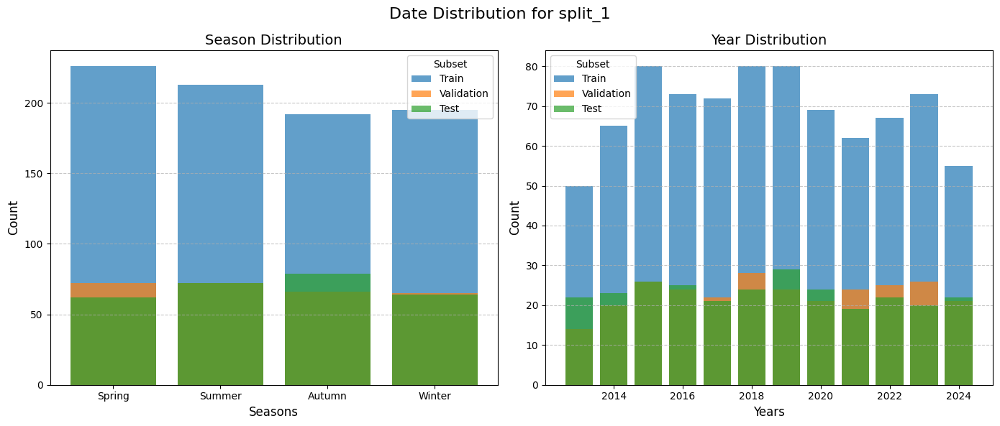


--- split_2 ---


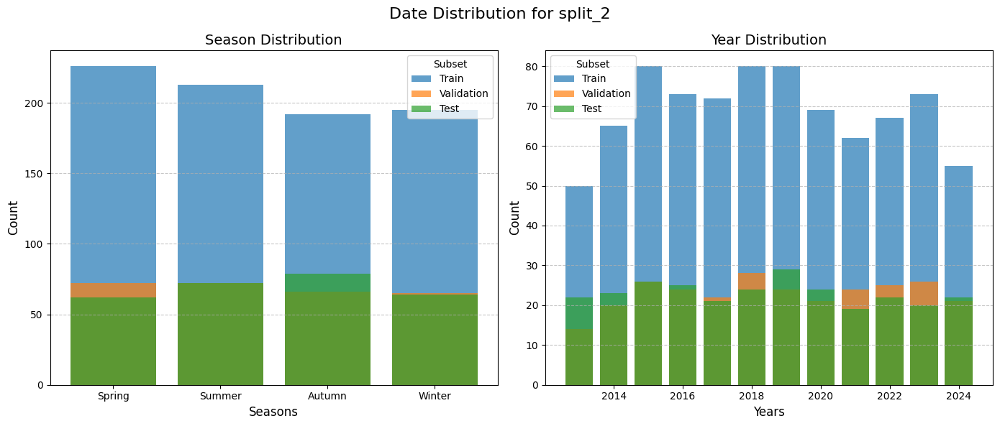


--- split_3 ---


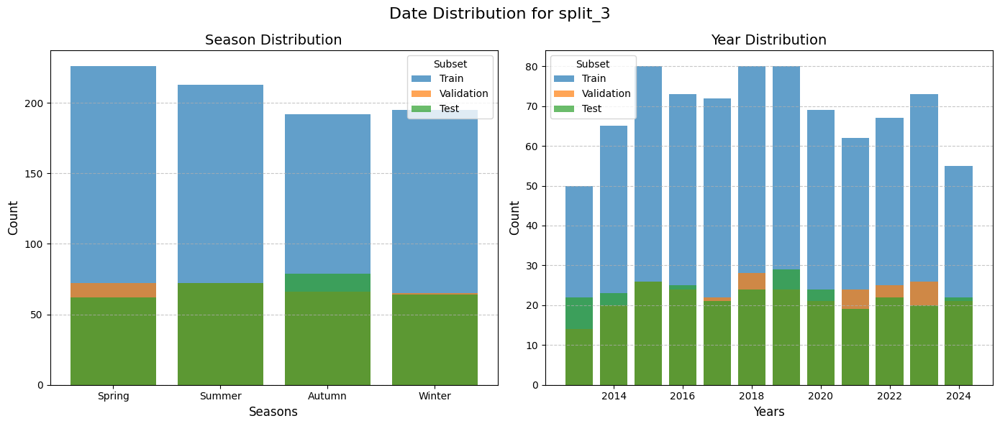


--- split_4 ---


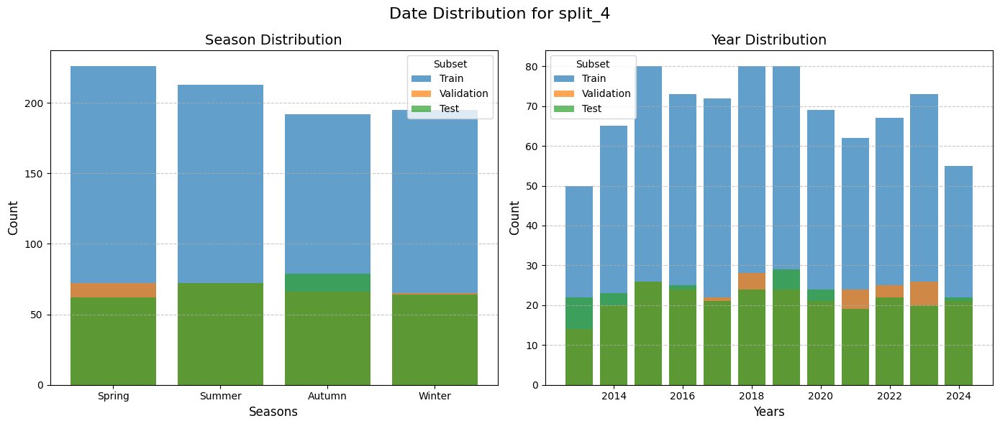


--- split_5 ---


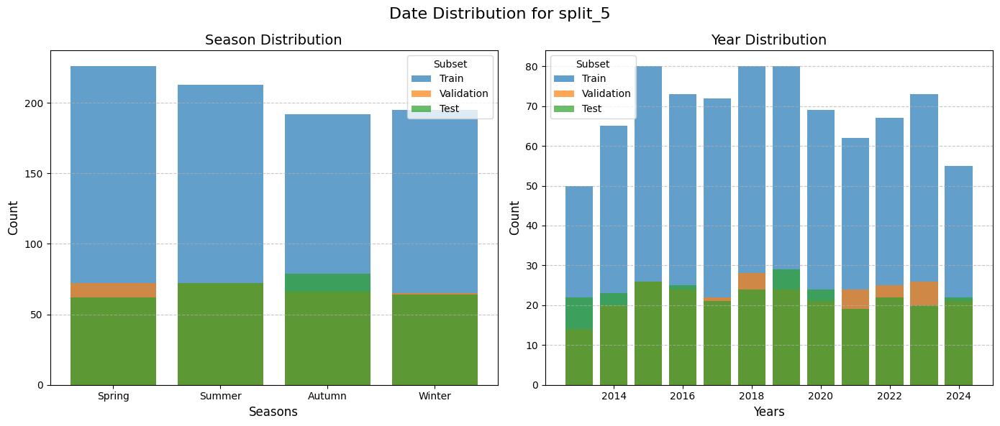

In [29]:
import matplotlib.pyplot as plt

# Visualize season and year distributions for each split
for split_name, summary in split_season_year_summary.items():
    print(f"\n--- {split_name} ---")
    
    # Create subplots for seasons and years
    fig, axes = plt.subplots(1, 2, figsize=(14, 6))
    fig.suptitle(f"Date Distribution for {split_name}", fontsize=16)

    # Plot for seasons
    for subset_name, counts in summary.items():
        season_counts = counts['season_counts']
        seasons = list(season_counts.keys())
        values = list(season_counts.values())
        
        axes[0].bar(seasons, values, label=subset_name, alpha=0.7)

    axes[0].set_title("Season Distribution", fontsize=14)
    axes[0].set_xlabel("Seasons", fontsize=12)
    axes[0].set_ylabel("Count", fontsize=12)
    axes[0].legend(title="Subset", fontsize=10)
    axes[0].grid(axis='y', linestyle='--', alpha=0.7)

    # Plot for years
    for subset_name, counts in summary.items():
        year_counts = counts['year_counts']
        years = list(year_counts.keys())
        values = list(year_counts.values())
        
        axes[1].bar(years, values, label=subset_name, alpha=0.7)

    axes[1].set_title("Year Distribution", fontsize=14)
    axes[1].set_xlabel("Years", fontsize=12)
    axes[1].set_ylabel("Count", fontsize=12)
    axes[1].legend(title="Subset", fontsize=10)
    axes[1].grid(axis='y', linestyle='--', alpha=0.7)

    # Adjust layout and show plots
    plt.tight_layout()
    plt.subplots_adjust(top=0.88)
    plt.savefig(f"../plots/date_distribution_{split_name}.png")
    plt.show()


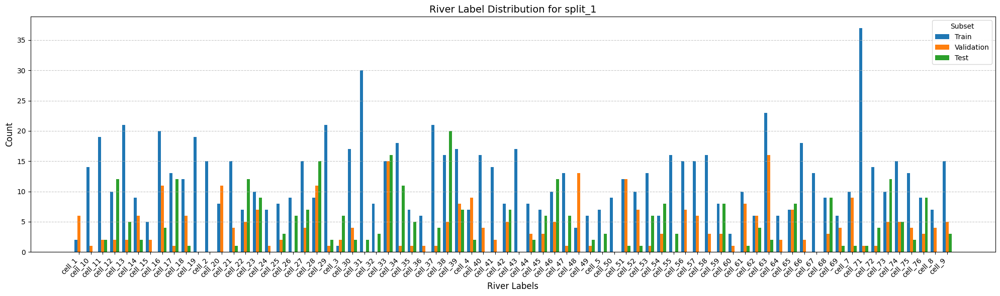

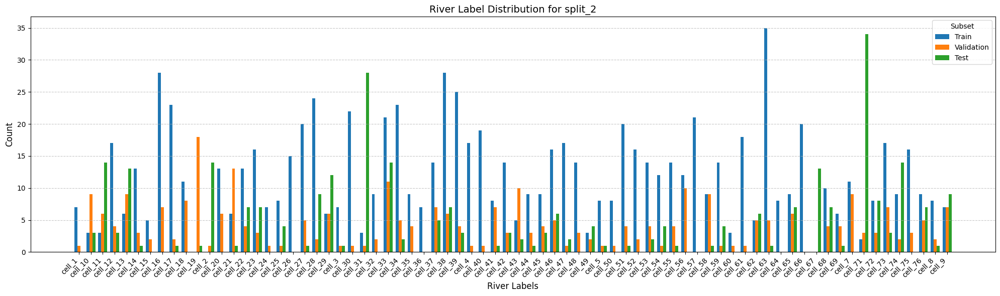

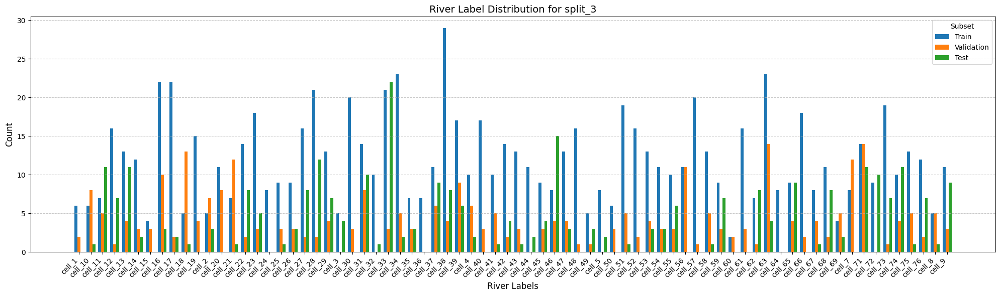

In [27]:
river_labels = labels
for split_file in split_indices_files:
    split_name = split_file.split('_indices')[0]

    # Load indices for the split
    with open(f"{input_dir}/{split_file}", 'r') as f:
        split_indices = json.load(f)

    # Extract train, validation, and test indices
    train_indices = split_indices['train']
    val_indices = split_indices['val']
    test_indices = split_indices['test']

    # Get the river labels for each subset
    train_labels = [river_labels[i] for i in train_indices]
    val_labels = [river_labels[i] for i in val_indices]
    test_labels = [river_labels[i] for i in test_indices]

    # Count occurrences of each river label in each subset
    train_counts = Counter(train_labels)
    val_counts = Counter(val_labels)
    test_counts = Counter(test_labels)

    # Get all unique river labels
    all_labels = sorted(set(river_labels))

    # Prepare data for plotting
    train_values = [train_counts[label] for label in all_labels]
    val_values = [val_counts[label] for label in all_labels]
    test_values = [test_counts[label] for label in all_labels]

    # Plot the distribution
    fig, ax = plt.subplots(figsize=(20, 6))
    x = range(len(all_labels))

    ax.bar(x, train_values, width=0.25, label="Train", align="center")
    ax.bar([p + 0.25 for p in x], val_values, width=0.25, label="Validation", align="center")
    ax.bar([p + 0.5 for p in x], test_values, width=0.25, label="Test", align="center")

    # Customize the plot
    ax.set_title(f"River Label Distribution for {split_name}", fontsize=14)
    ax.set_xlabel("River Labels", fontsize=12)
    ax.set_ylabel("Count", fontsize=12)
    ax.set_xticks([p + 0.25 for p in x])
    ax.set_xticklabels(all_labels, rotation=45, ha="right")
    ax.legend(title="Subset", fontsize=10)
    ax.grid(axis='y', linestyle='--', alpha=0.7)

    plt.tight_layout()
    plt.show()
    

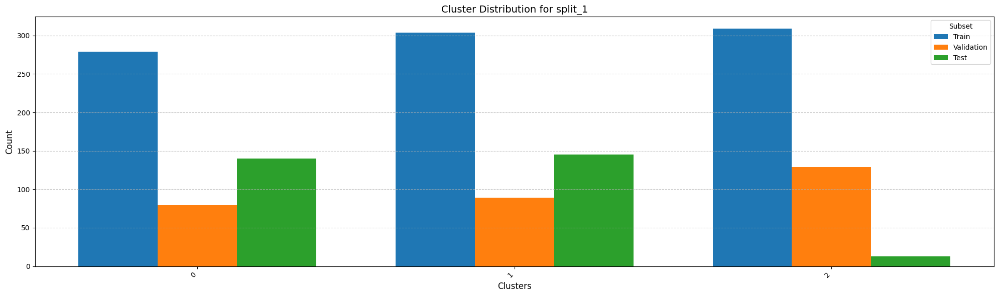

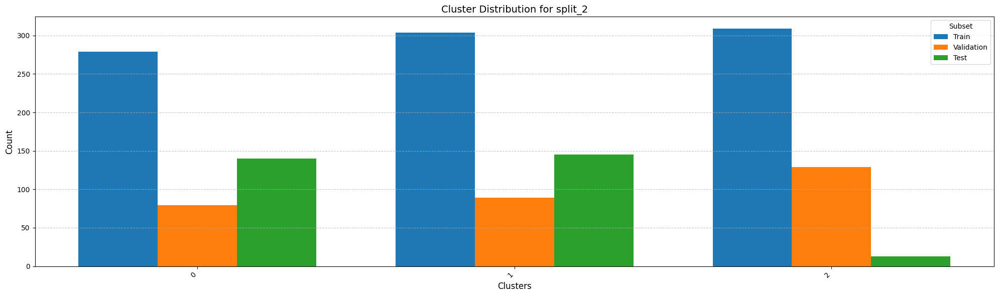

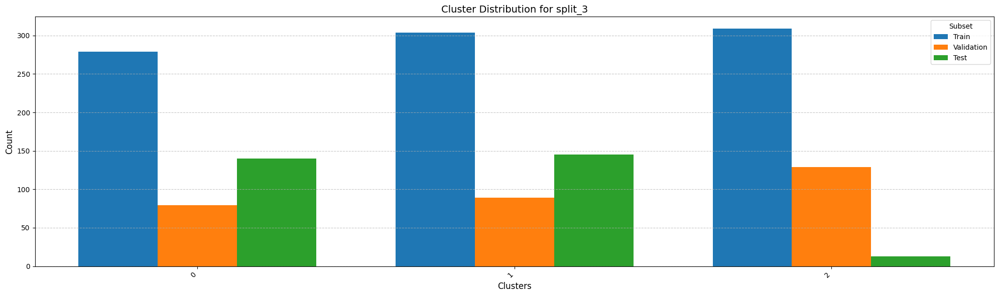

In [25]:
for split_file in split_indices_files:
    split_name = split_file.split('_indices')[0]

    # Load indices for the split
    with open(f"{input_dir}/{split_file}", 'r') as f:
        split_indices = json.load(f)

    # Extract train, validation, and test indices
    train_indices = split_indices['train']
    val_indices = split_indices['val']
    test_indices = split_indices['test']

    # Get the river labels for each subset
    train_labels = [ordered_clusters[i] for i in train_indices]
    val_labels = [ordered_clusters[i] for i in val_indices]
    test_labels = [ordered_clusters[i] for i in test_indices]

    # Count occurrences of each river label in each subset
    train_counts = Counter(train_labels)
    val_counts = Counter(val_labels)
    test_counts = Counter(test_labels)

    # Get all unique river labels
    all_labels = sorted(set(ordered_clusters))

    # Prepare data for plotting
    train_values = [train_counts[label] for label in all_labels]
    val_values = [val_counts[label] for label in all_labels]
    test_values = [test_counts[label] for label in all_labels]

    # Plot the distribution
    fig, ax = plt.subplots(figsize=(20, 6))
    x = range(len(all_labels))

    ax.bar(x, train_values, width=0.25, label="Train", align="center")
    ax.bar([p + 0.25 for p in x], val_values, width=0.25, label="Validation", align="center")
    ax.bar([p + 0.5 for p in x], test_values, width=0.25, label="Test", align="center")

    # Customize the plot
    ax.set_title(f"Cluster Distribution for {split_name}", fontsize=14)
    ax.set_xlabel("Clusters", fontsize=12)
    ax.set_ylabel("Count", fontsize=12)
    ax.set_xticks([p + 0.25 for p in x])
    ax.set_xticklabels(all_labels, rotation=45, ha="right")
    ax.legend(title="Subset", fontsize=10)
    ax.grid(axis='y', linestyle='--', alpha=0.7)

    plt.tight_layout()
    plt.savefig(f"../plots/cluster_dist_{split_name}.png")
    plt.show()
    

## Visualisation of all variables

Index: 1, Label: cell_67
lst range: Min = 0.0, Max = 255.0
ndvi range: Min = -0.16596537828445435, Max = 0.6878848671913147
altitude range: Min = 370.1573408931404, Max = 429.5892841020953
slope range: Min = 0.614682773042196, Max = 6.6440832185796665
direction range: Min = 1.0, Max = 139.4152080758121


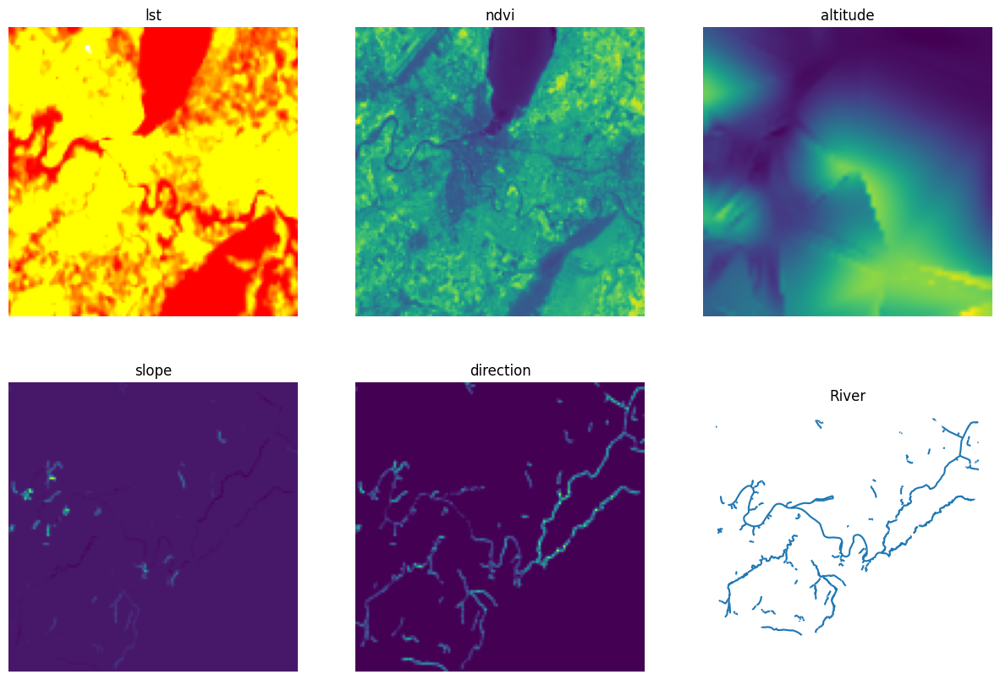



Index: 2, Label: cell_67
lst range: Min = 0.0, Max = 238.73931884765625
ndvi range: Min = -0.28999173641204834, Max = 0.8533776998519897
altitude range: Min = 370.1573408931404, Max = 429.5892841020953
slope range: Min = 0.614682773042196, Max = 6.6440832185796665
direction range: Min = 1.0, Max = 139.4152080758121


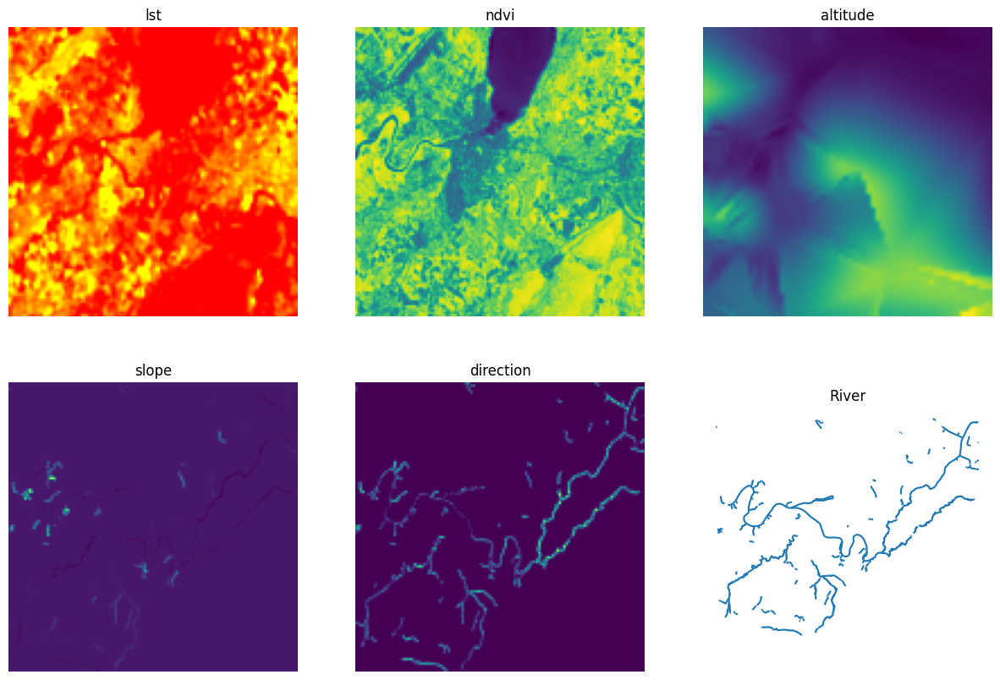



Index: 3, Label: cell_67
lst range: Min = 0.0, Max = 239.36520385742188
ndvi range: Min = -0.5054354667663574, Max = 0.860775351524353
altitude range: Min = 370.1573408931404, Max = 429.5892841020953
slope range: Min = 0.614682773042196, Max = 6.6440832185796665
direction range: Min = 1.0, Max = 139.4152080758121


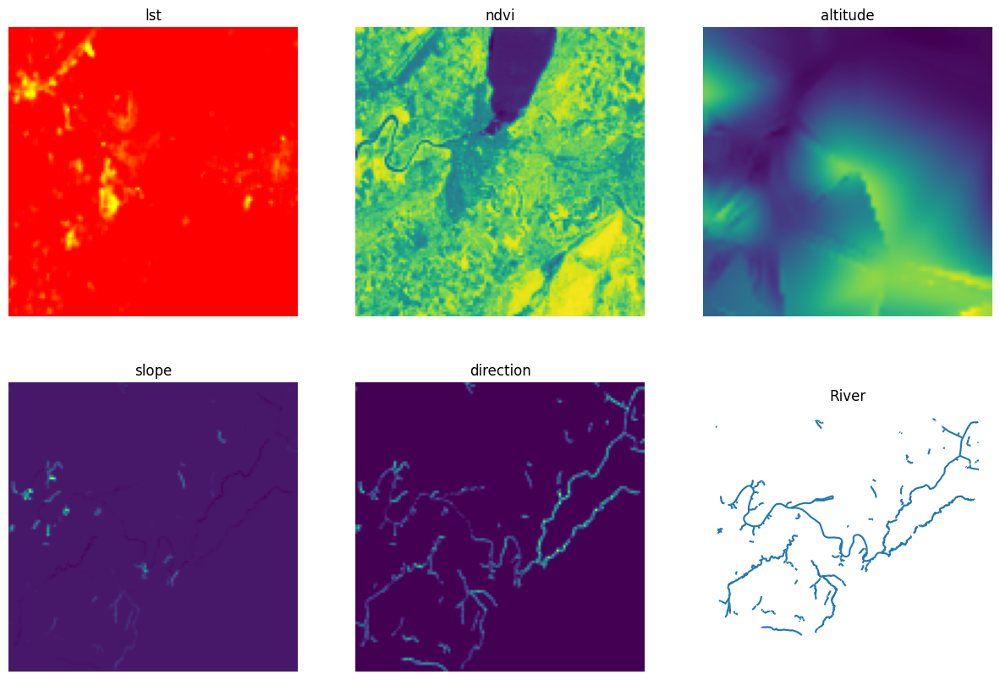



Index: 4, Label: cell_67
lst range: Min = 0.0, Max = 208.47280883789062
ndvi range: Min = -0.08036193996667862, Max = 0.7933273315429688
altitude range: Min = 370.1573408931404, Max = 429.5892841020953
slope range: Min = 0.614682773042196, Max = 6.6440832185796665
direction range: Min = 1.0, Max = 139.4152080758121


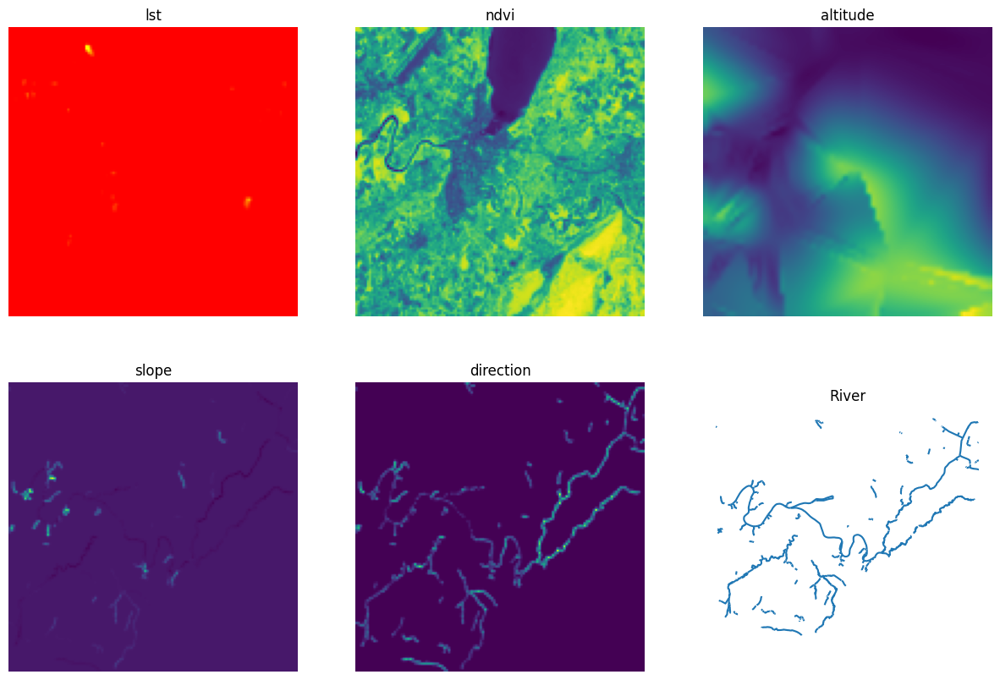

In [7]:
import matplotlib.pyplot as plt
import numpy as np

# Loop through the first 5 elements
for i in range(1, 5):
    # Print label and check spatial bounds and CRS
    print(f"Index: {i}, Label: {labels[i]}")
    riu = labels[i]
    
    # Gather data for visualization and print ranges
    data = [total_data[k][i] for k in inputs]
    for k, var_data in zip(inputs, data):
        var_min, var_max = np.min(var_data), np.max(var_data)
        print(f"{k} range: Min = {var_min}, Max = {var_max}")

    # Set up the figure and axes for a 2x3 grid
    fig, axs = plt.subplots(2, 3, figsize=(15, 10))  # Adjust figsize as needed
    
    # Loop through each subplot and display the data
    for j, ax in enumerate(axs.flat):
        if j == 5:
            # Plot river cell for the last subplot
            river_cells[riu].plot(ax=ax)
        elif inputs[j] == 'lst':
            # Plot LST data with clipping
            ax.imshow(np.clip(data[j] * (6 / 255), 0, 1), cmap='viridis')
        else:
            # Plot other data without clipping
            ax.imshow(data[j], cmap='viridis')
        
        # Set title and turn off axis for a cleaner look
        ax.set_title(f"{inputs[j]}" if j != 5 else 'River')
        ax.axis("off")

    # Show the plot
    plt.show()
    
    # Print a separator for clarity between iterations
    print("\n" + "="*40 + "\n")


## Correlation analysis

In [7]:
source_dir = '../data/preprocessed'
data = ['lst','wt','ndvi']
all_ds = {k: [] for k in data}
for d in data:
    dicc={}
    source_path = os.path.join(source_dir,d)
    for subdir, dirs, files in os.walk(source_path):
        for file in files:
            if file.endswith('.csv'):
                print('entro', d, file.split('.')[0])
                if d != 'wt' and file.split('.')[0] in labels:
                    dicc[subdir.split('/')[-1]] = pd.read_csv(f'{subdir}/{file}',index_col=0)
                elif d == 'wt':
                    df = pd.read_csv(f'{subdir}/{file}',index_col=0)
                    for i,r in df.iterrows():
                        if r.Cell not in dicc and r.Cell in labels:  
                            dicc[r.Cell] = [r.WaterTemp]
                        elif r.Cell in dicc :
                            dicc[r.Cell].append(r.WaterTemp)
                        
    all_ds[d]=dicc

entro lst cell_67
entro lst cell_2
entro lst cell_70
entro lst cell_31
entro lst cell_19
entro lst cell_29
entro lst cell_71
entro lst cell_49
entro lst cell_43
entro lst cell_10
entro lst cell_13
entro lst cell_41
entro lst cell_21
entro lst cell_11
entro lst cell_58
entro lst cell_56
entro lst cell_74
entro lst cell_37
entro lst cell_62
entro lst cell_72
entro lst cell_65
entro lst cell_8
entro lst cell_80
entro lst cell_68
entro lst cell_9
entro lst cell_18
entro lst cell_69
entro lst cell_3
entro lst cell_46
entro lst cell_23
entro lst cell_28
entro lst cell_33
entro lst cell_54
entro lst cell_76
entro lst cell_20
entro lst cell_22
entro lst cell_59
entro lst cell_38
entro lst cell_7
entro lst cell_75
entro lst cell_12
entro lst cell_48
entro lst cell_42
entro lst cell_14
entro lst cell_77
entro lst cell_73
entro lst cell_51
entro lst cell_81
entro lst cell_17
entro lst cell_6
entro lst cell_45
entro lst cell_1
entro lst cell_30
entro lst cell_60
entro lst cell_79
entro lst cell_15

### River zones

In [8]:
from scipy.stats import pearsonr
import numpy as np
results = []
# Iterar sobre los ríos
for a, river in enumerate(np.unique(labels)): 
    # Inicializar listas para guardar las medias y correlaciones
    lst_means = []
    ndvi_means = []
    water_temps = []
    
    # Iterar sobre las fechas (filas)
    for n, (i, row) in enumerate(all_ds['lst'][river].iterrows()):
        # Calcular la media de LST y NDVI para la fecha (asumiendo valores espaciales en cada fila)
        lst_mean = all_ds['lst'][river].loc[i].mean()
        ndvi_mean = all_ds['ndvi'][river].loc[i].mean()
        water_temp = all_ds['wt'][river][n]  # Obtener el único valor de WT para esta fecha
        
        # Guardar las medias para esta fecha
        lst_means.append(lst_mean)
        ndvi_means.append(ndvi_mean)
        water_temps.append(water_temp)
    
    # Calcular las correlaciones finales entre las medias de las fechas
    if len(lst_means) > 1 and len(ndvi_means) > 1:  # Evitar errores si hay pocas fechas
        corr_temp_ndvi, _ = pearsonr(lst_means, ndvi_means)
        corr_temp_water, _ = pearsonr(lst_means, water_temps)
        corr_ndvi_water, _ = pearsonr(ndvi_means, water_temps)
        results.append({
            'River': river,
            'Correlation_LST_NDVI': corr_temp_ndvi,
            'Correlation_LST_WT': corr_temp_water,
            'Correlation_NDVI_WT': corr_ndvi_water
        })
        
    else:
        print(f'River {river} has insufficient data for correlation analysis.')
    results_df = pd.DataFrame(results)

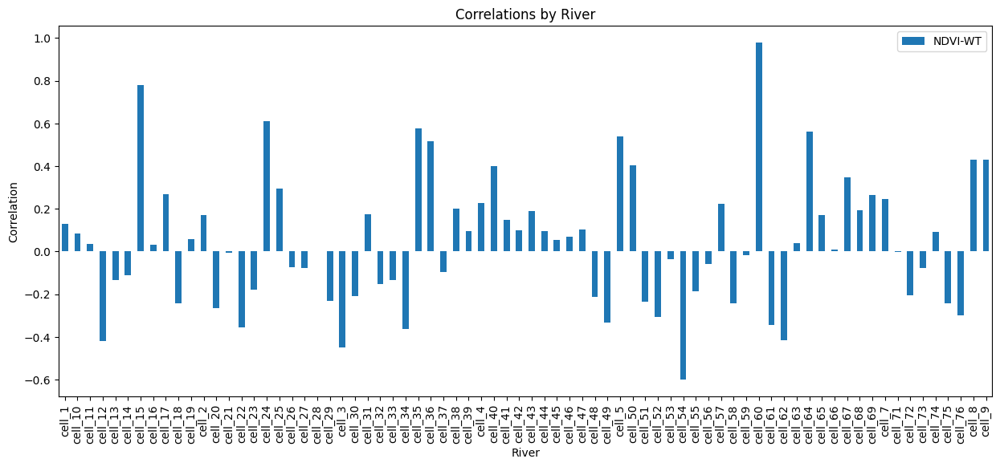

In [9]:
import matplotlib.pyplot as plt

# Gráfico de barras para cada correlación
results_df.plot(
    x='River', 
    y=['Correlation_NDVI_WT'], #'Correlation_LST_NDVI', 'Correlation_LST_WT',
    kind='bar', 
    figsize=(15, 6)
)
plt.title('Correlations by River')
plt.ylabel('Correlation')
plt.xlabel('River')
plt.legend(['NDVI-WT']) # 'LST-NDVI', 'LST-WT',
plt.show()


### Image mean

In [10]:
from collections import Counter
imgs_per_river = Counter(labels)
imgs_per_river

Counter({'cell_33': 46,
         'cell_38': 41,
         'cell_63': 41,
         'cell_71': 39,
         'cell_28': 35,
         'cell_16': 35,
         'cell_31': 32,
         'cell_39': 32,
         'cell_34': 30,
         'cell_13': 28,
         'cell_46': 27,
         'cell_73': 27,
         'cell_37': 26,
         'cell_23': 26,
         'cell_17': 26,
         'cell_27': 26,
         'cell_74': 25,
         'cell_51': 25,
         'cell_29': 24,
         'cell_22': 24,
         'cell_12': 24,
         'cell_11': 23,
         'cell_9': 23,
         'cell_30': 23,
         'cell_56': 22,
         'cell_65': 22,
         'cell_68': 21,
         'cell_76': 21,
         'cell_57': 21,
         'cell_21': 20,
         'cell_7': 20,
         'cell_42': 20,
         'cell_53': 20,
         'cell_40': 20,
         'cell_66': 20,
         'cell_47': 20,
         'cell_19': 19,
         'cell_58': 19,
         'cell_72': 19,
         'cell_18': 19,
         'cell_20': 19,
         'cell_59'

In [11]:
from scipy.stats import pearsonr
import numpy as np
results = []

start=0
for riv, num in imgs_per_river.items():
    lst_means = []
    ndvi_means = []
    water_temps = []
    for n in range(num):
        lst_mean = np.mean(total_data['lst'][start+n])
        ndvi_mean = np.mean(total_data['ndvi'][start+n])
        water_temp_mean = all_ds['wt'][riv][n]
        print(lst_mean, water_temp_mean)

        lst_means.append(lst_mean)
        ndvi_means.append(ndvi_mean)
        water_temps.append(water_temp_mean)

    start += num
    
    corr_temp_ndvi, _ = pearsonr(lst_means, ndvi_means)
    corr_temp_water, _ = pearsonr(lst_means, water_temps)
    corr_ndvi_water, _ = pearsonr(ndvi_means, water_temps)
    results.append({
        'River': riv,
        'Correlation_LST_NDVI': corr_temp_ndvi,
        'Correlation_LST_WT': corr_temp_water,
        'Correlation_NDVI_WT': corr_ndvi_water
    })
    
results_df = pd.DataFrame(results)

80.46502697219451 12.22
77.94749748582642 5.91
63.59219693702956 10.48
49.77043035129706 11.84
43.84676552563906 7.41
3.2239162096132836 11.78
36.45554864530762 12.02
31.870052829384804 7.56
55.46405052393675 12.43
59.9804412368685 5.73
12.395043367519975 5.24
65.45770875178277 10.74
70.89131831936538 6.34
25.24763515094916 12.63
17.739525347948074 1.44
38.45752109090487 14.46
25.938928872346878 2.44
30.585458238919575 12.43
18.28076335787773 4.0
10.863459597031275 0.86
3.9332338124513626 10.91
50.451298673947655 1.57
9.983496606349945 3.8
43.39498154819012 8.56
7.6371166457732516 5.02
52.04560869932175 1.32
13.63982224961122 2.79
28.593598569432896 9.45
150.0013521015644 2.61
99.4087603588899 10.7
82.26522673169772 8.07
116.7126109401385 10.37
11.091938902934393 9.76
56.7308954000473 1.28
58.19188732902209 12.98
145.88726541399956 9.24
24.603420446316402 4.21
39.28708694378535 2.05
123.5294270614783 2.85
26.80273860692978 13.76
102.37916179498036 3.15
38.404724369446434 1.63
142.21493

In [12]:
results_df

,River,Correlation_LST_NDVI,Correlation_LST_WT,Correlation_NDVI_WT
0,cell_67,0.095744,-0.006481,0.342173
1,cell_2,0.224004,0.067925,0.201264
2,cell_31,-0.110951,-0.008352,0.201296
3,cell_19,0.517877,0.066702,0.053497
4,cell_29,-0.211317,0.391791,-0.234000
...,...,...,...,...
69,cell_25,0.147178,-0.231484,0.304072
70,cell_27,-0.020284,0.068008,-0.071273
71,cell_16,-0.172398,-0.176524,0.025608
72,cell_4,-0.080304,-0.189400,0.223429


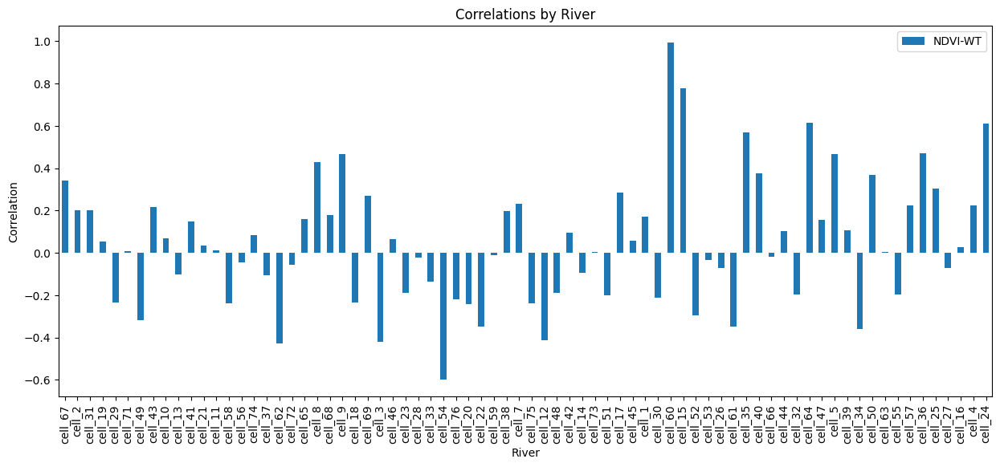

In [13]:
import matplotlib.pyplot as plt

# Gráfico de barras para cada correlación
results_df.plot(
    x='River', 
    y=['Correlation_NDVI_WT'], #'Correlation_LST_NDVI', 'Correlation_LST_WT',
    kind='bar', 
    figsize=(15, 6)
)
plt.title('Correlations by River')
plt.ylabel('Correlation')
plt.xlabel('River')
plt.legend(['NDVI-WT']) # 'LST-NDVI', 'LST-WT',
plt.show()


### Area around river

In [14]:
def plot_neighbors(neighbors_around_river,cell_gdf):
    # Paso 1: Convertir índices lineales a coordenadas (x, y)
    neighbor_coords = []
    for neighbor_index in neighbors_around_river:
        row, col = np.unravel_index(neighbor_index, array.shape)  # Índices 2D
        x, y = transform * (col + 0.5, row + 0.5)  # Transformar índices a coordenadas espaciales
        neighbor_coords.append((x, y))
    
    # Paso 2: Crear un GeoDataFrame para los vecinos
    neighbors_gdf = gpd.GeoDataFrame(
        geometry=[Point(coord) for coord in neighbor_coords],
        crs=cell_gdf.crs  # Asegúrate de usar el mismo CRS que cell_gdf
    )
    
    # Paso 3: Crear el plot
    fig, ax = plt.subplots(figsize=(10, 10))
    
    # Plotear geometrías del río
    cell_gdf.plot(ax=ax, color='blue', label='River Geometry')
    
    # Plotear vecinos
    neighbors_gdf.plot(ax=ax, color='red', marker='o', markersize=10, label='Neighboring Pixels')
    
    # Configurar el gráfico
    plt.legend()
    plt.title("River Geometry and Neighboring Pixels")
    plt.xlabel("Longitude")
    plt.ylabel("Latitude")
    plt.grid()
    plt.show()


Number of adjacent neighbors: 5091
neighbors


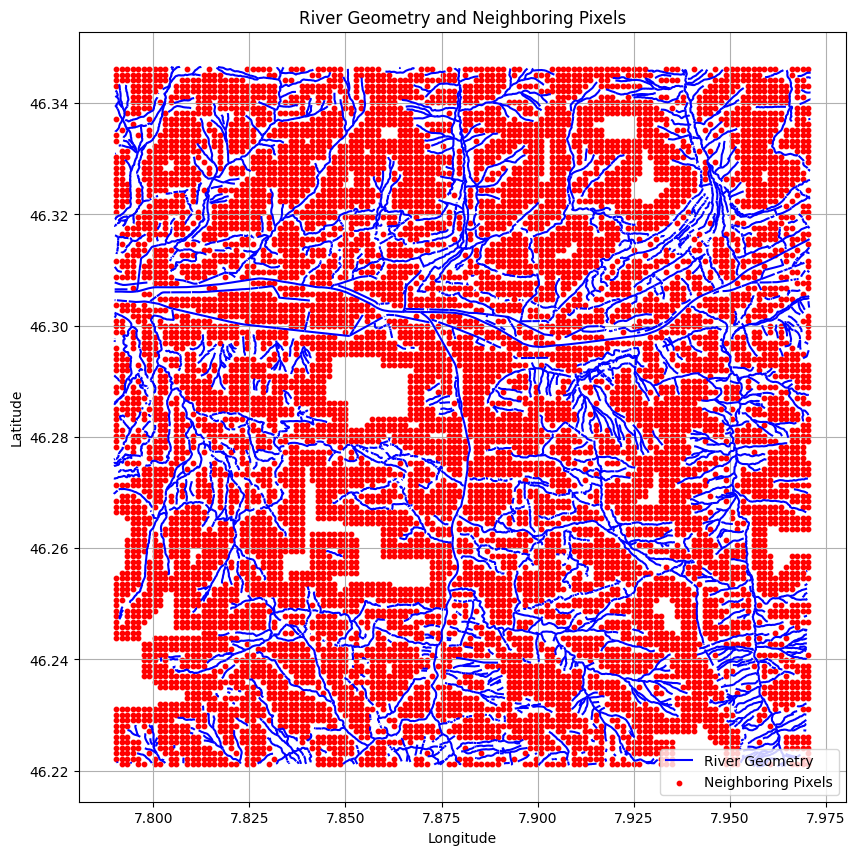


Adjacent Neighbors


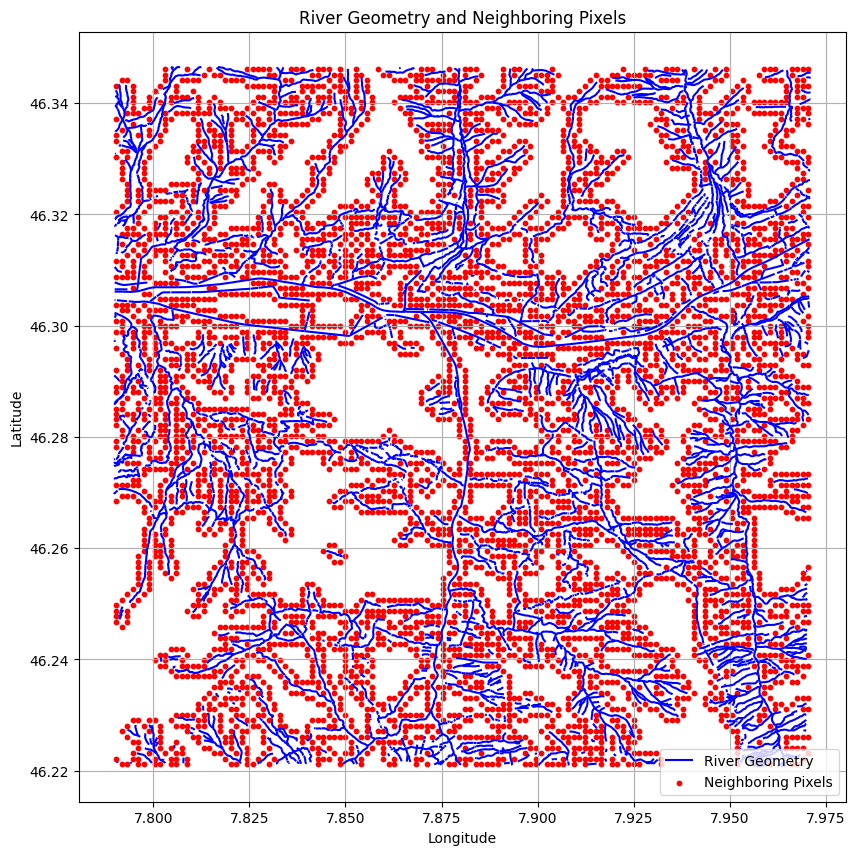

Number of adjacent neighbors: 4387
neighbors


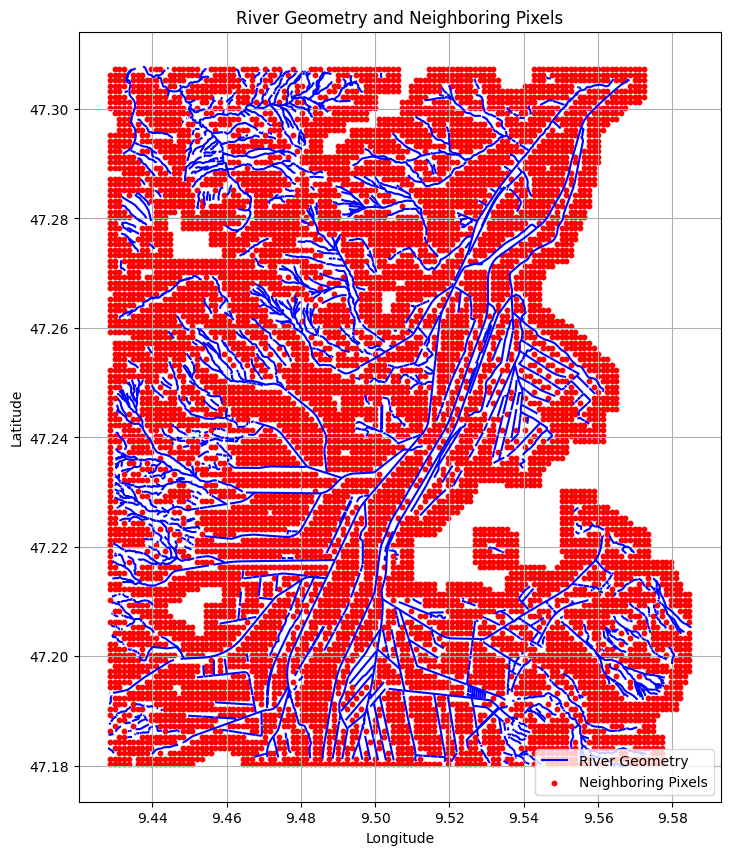


Adjacent Neighbors


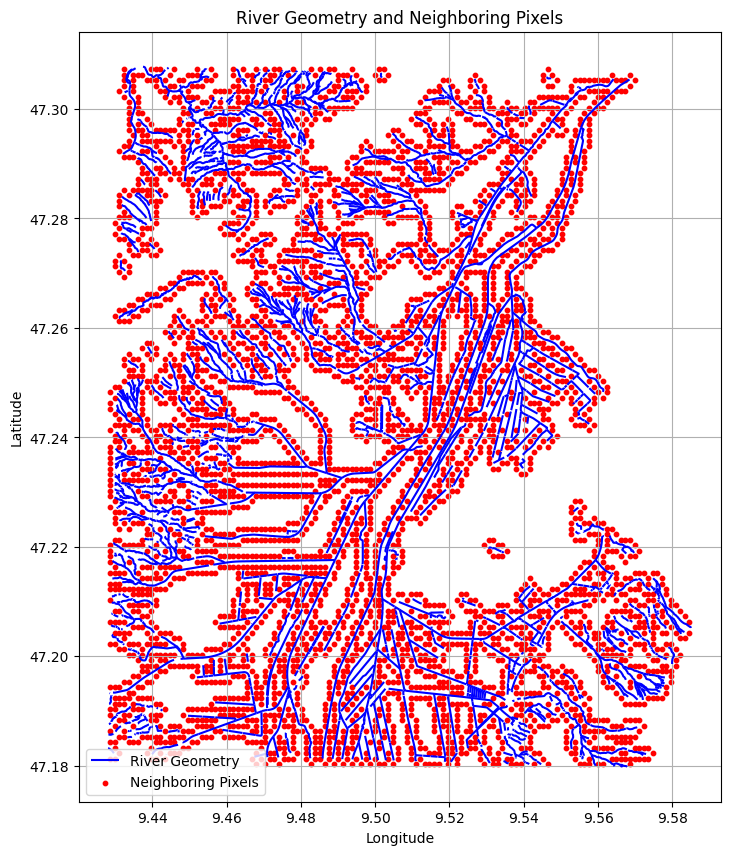

Number of adjacent neighbors: 3483
neighbors


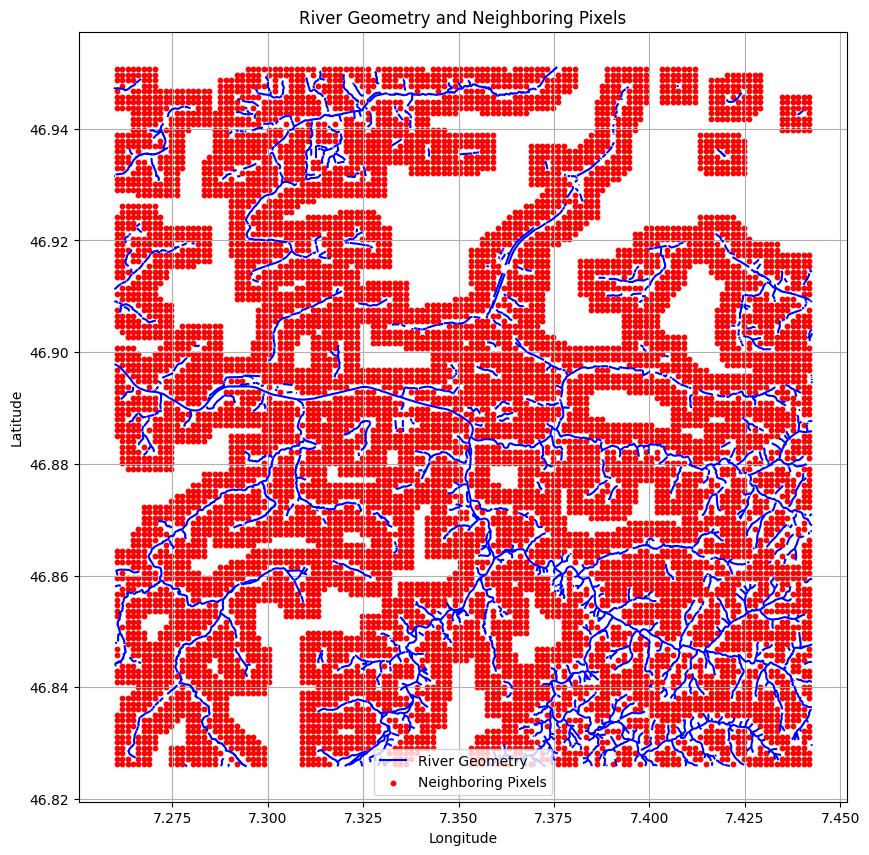


Adjacent Neighbors


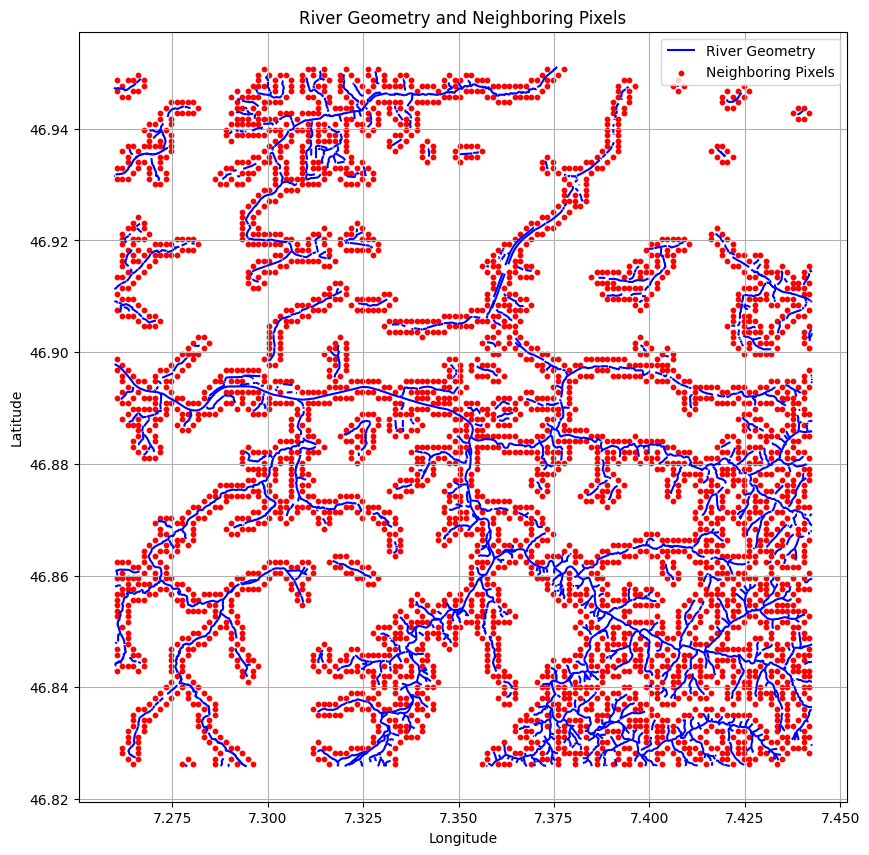

Number of adjacent neighbors: 1818
neighbors


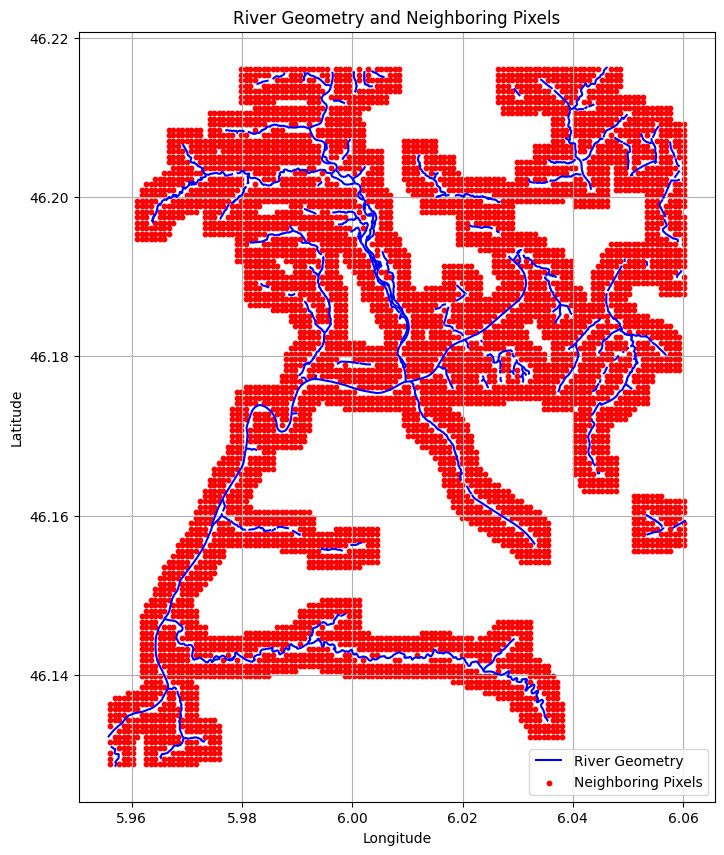


Adjacent Neighbors


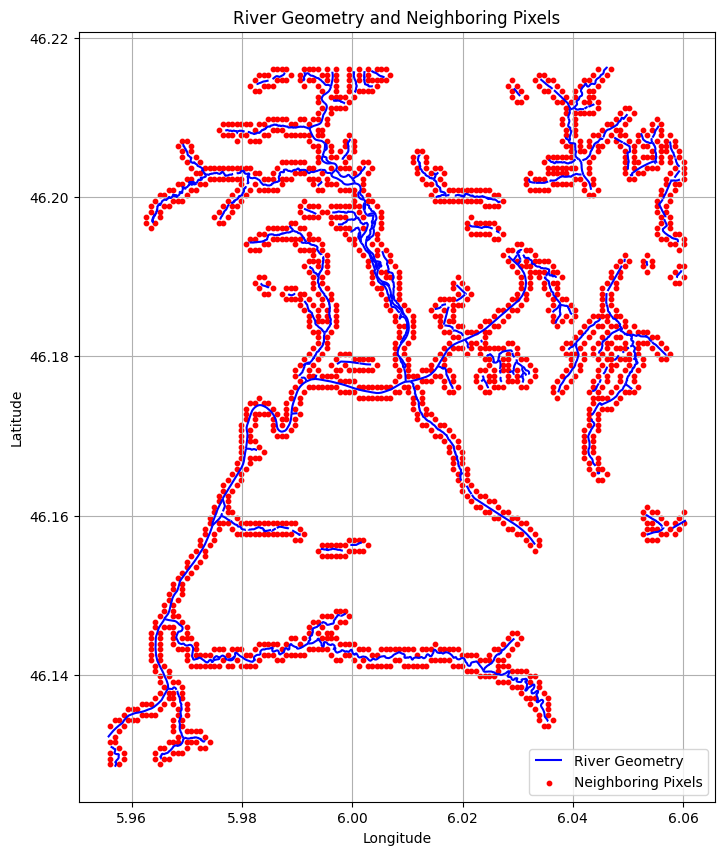

Number of adjacent neighbors: 4529
neighbors


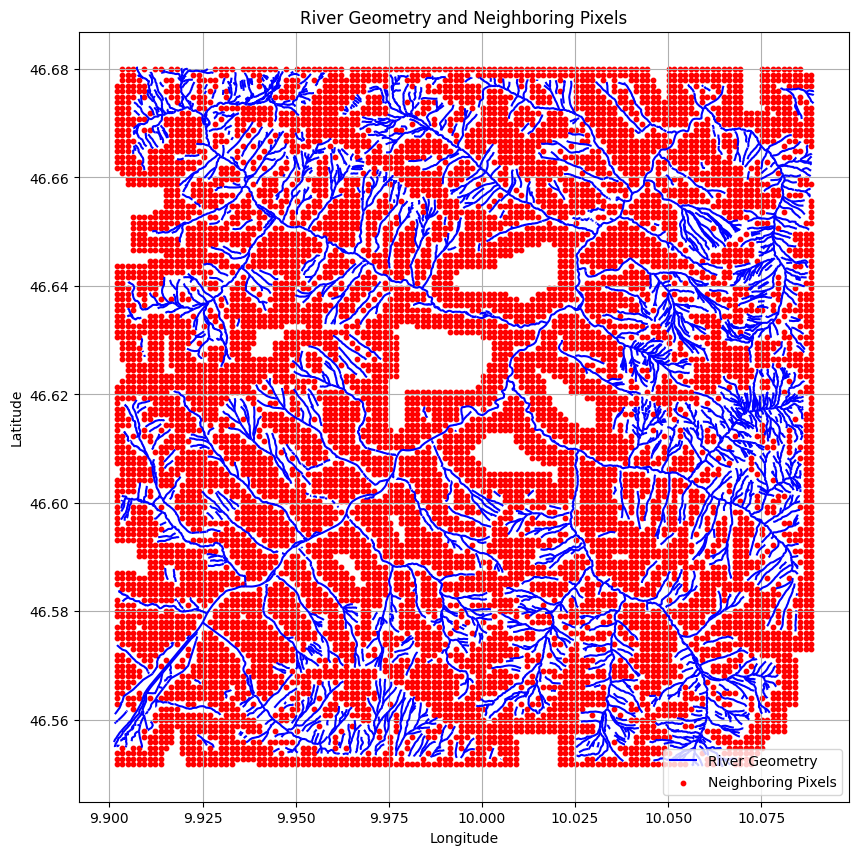


Adjacent Neighbors


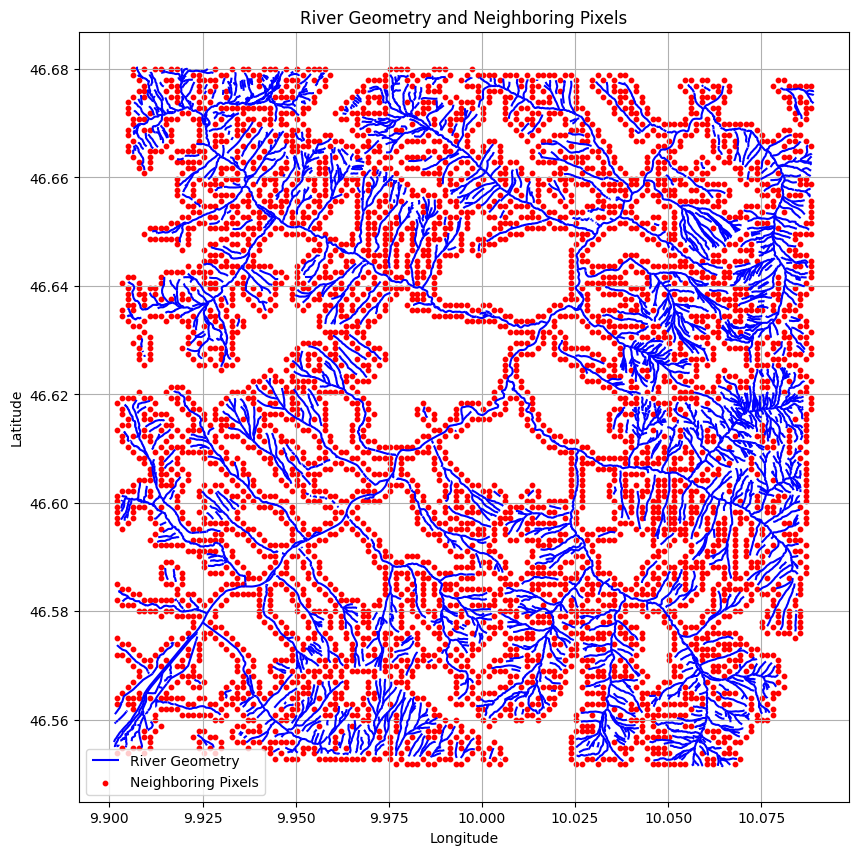

Number of adjacent neighbors: 3256
neighbors


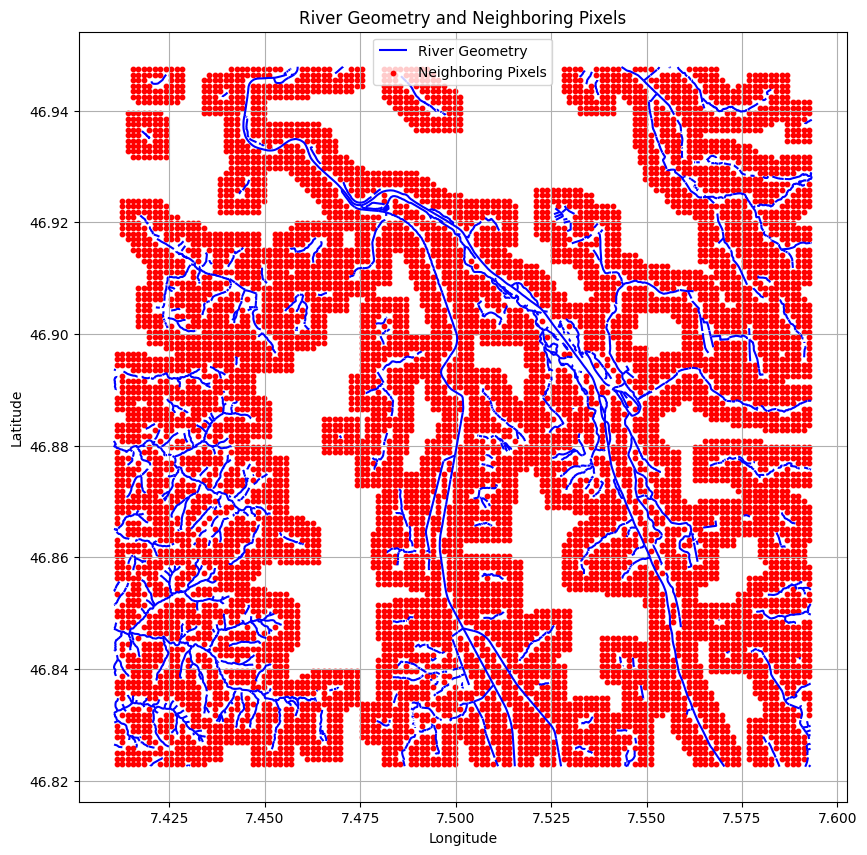


Adjacent Neighbors


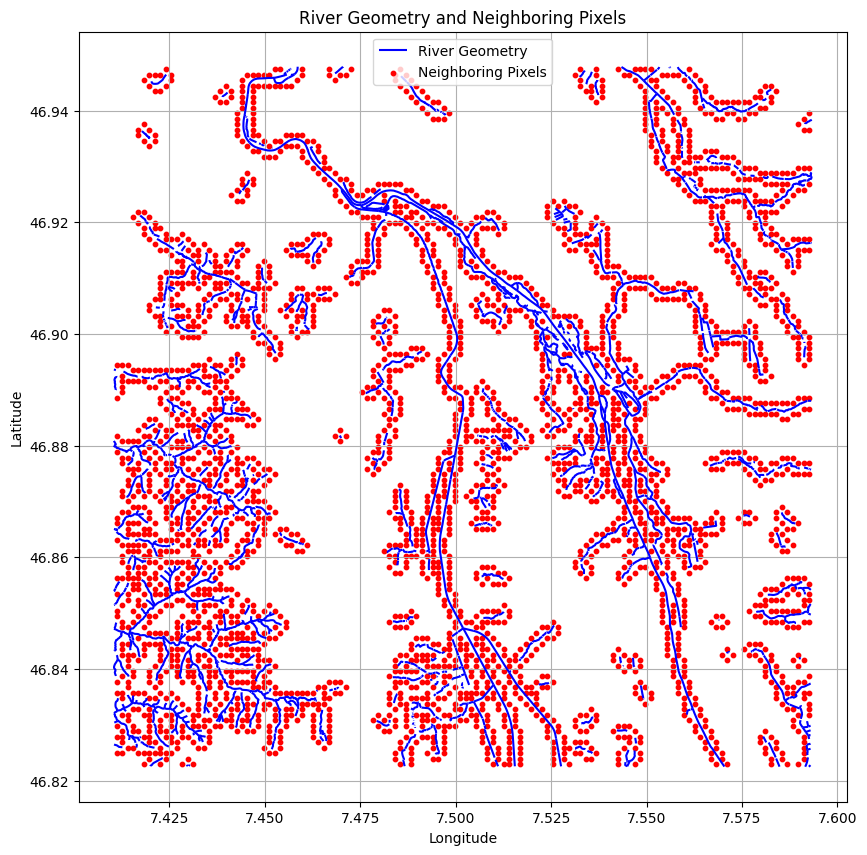

Number of adjacent neighbors: 2403
neighbors


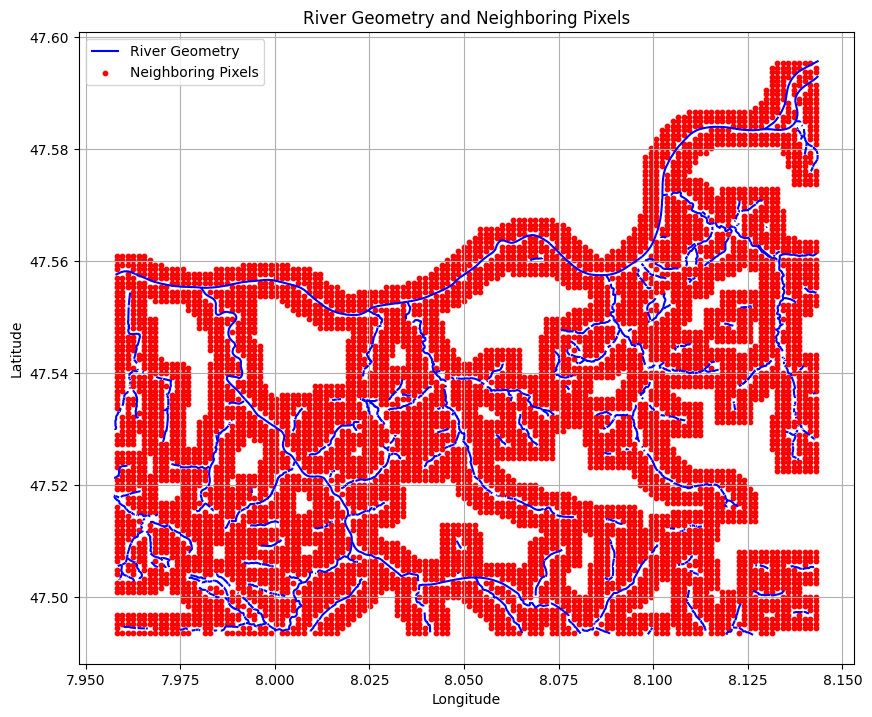


Adjacent Neighbors


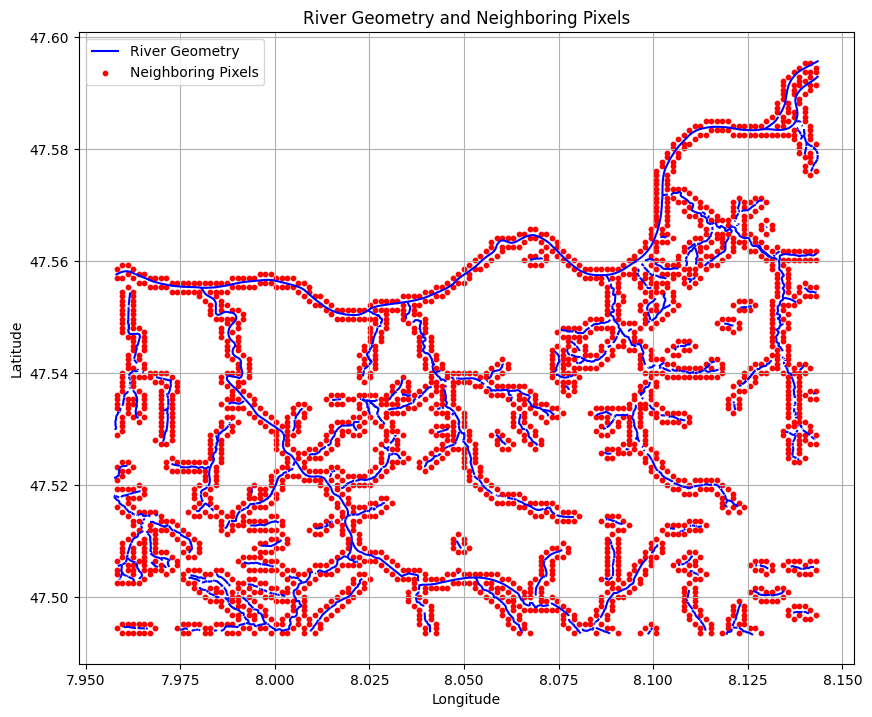

Number of adjacent neighbors: 2045
neighbors


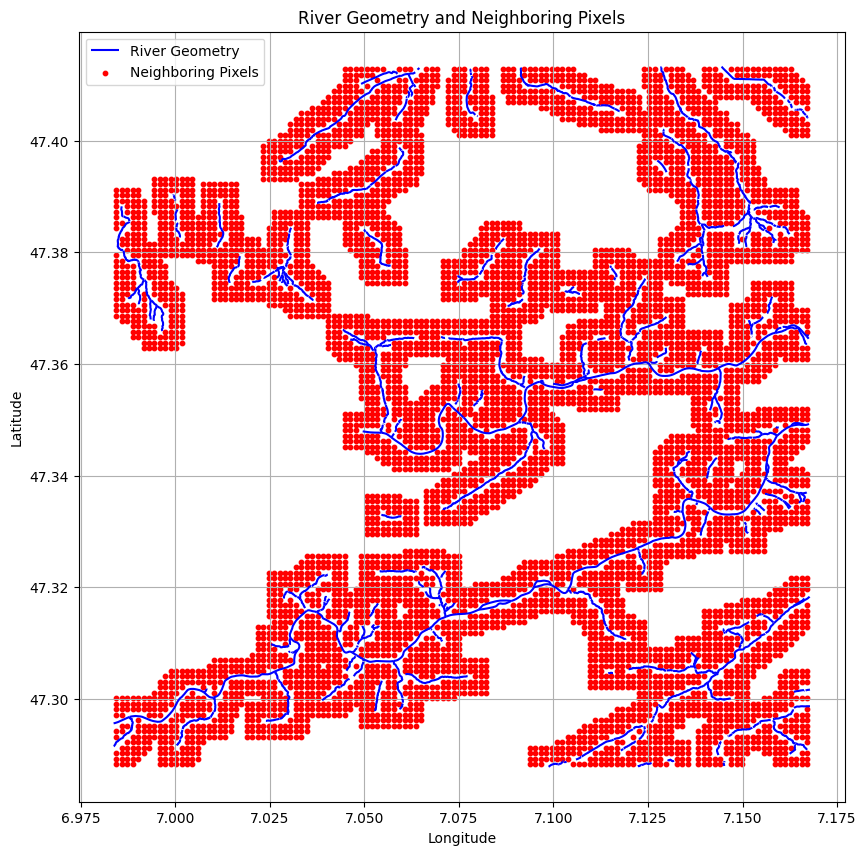


Adjacent Neighbors


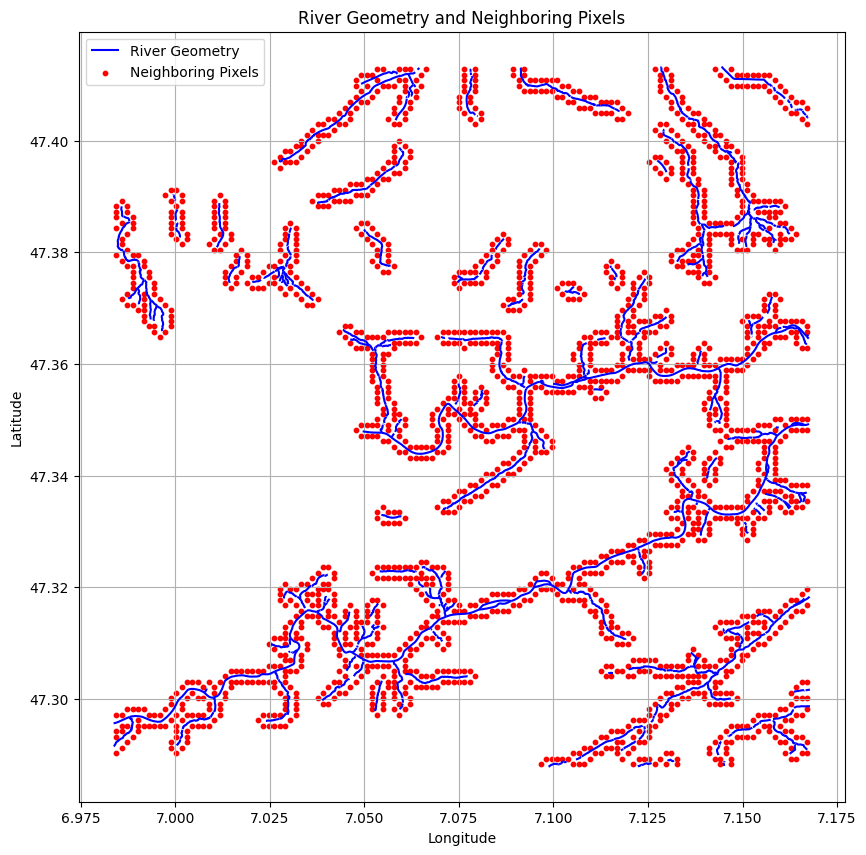

Number of adjacent neighbors: 4608
neighbors


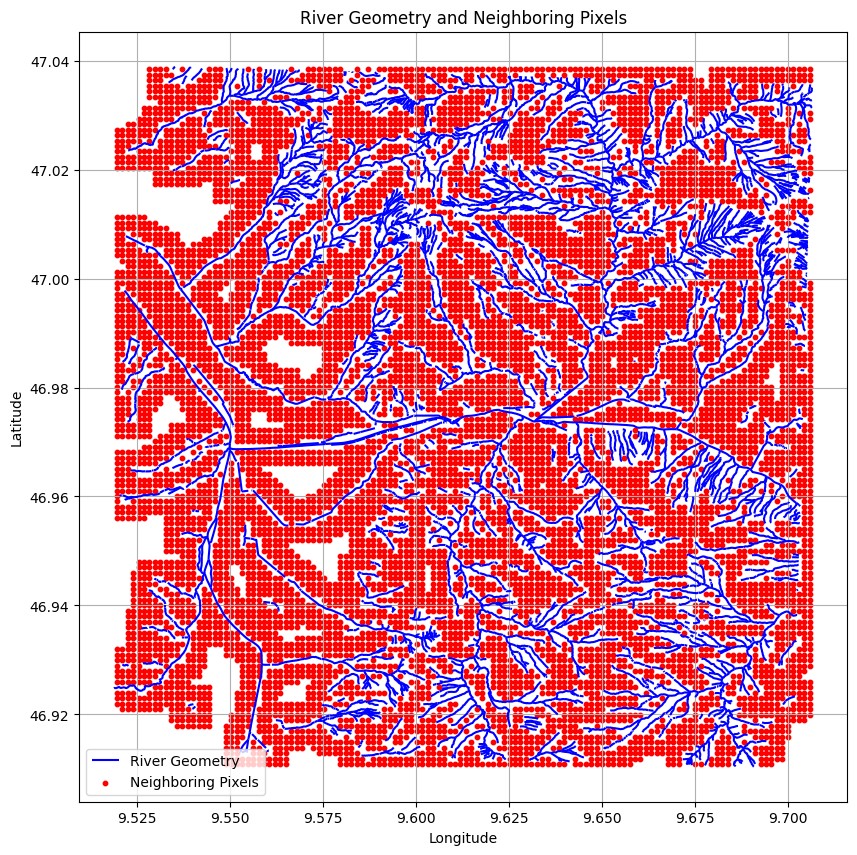


Adjacent Neighbors


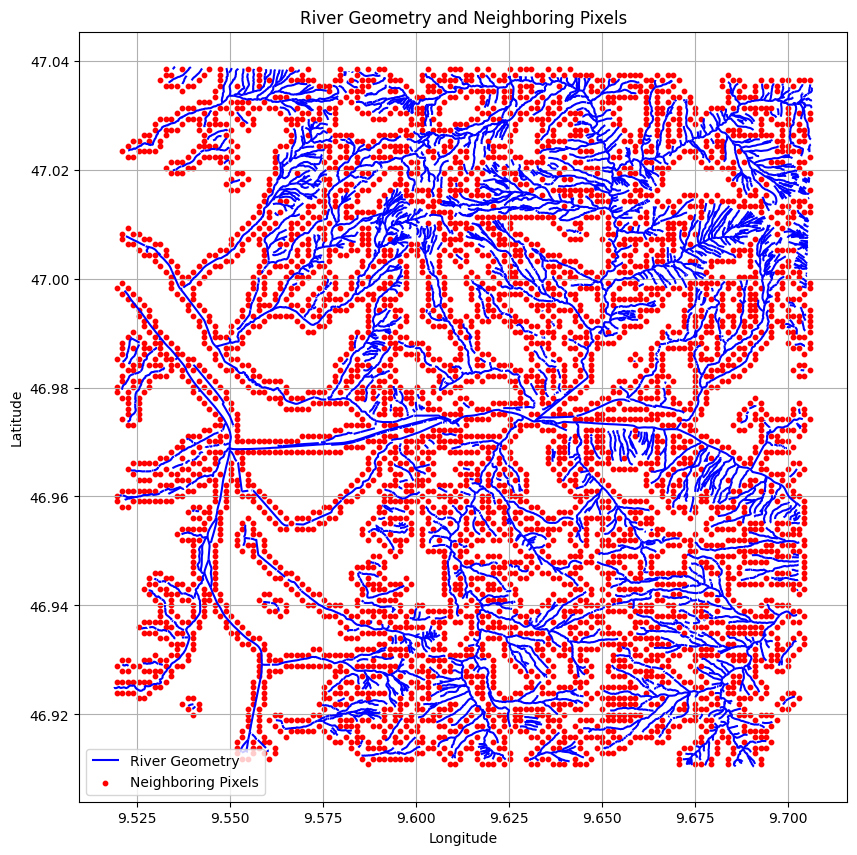

Number of adjacent neighbors: 2462
neighbors


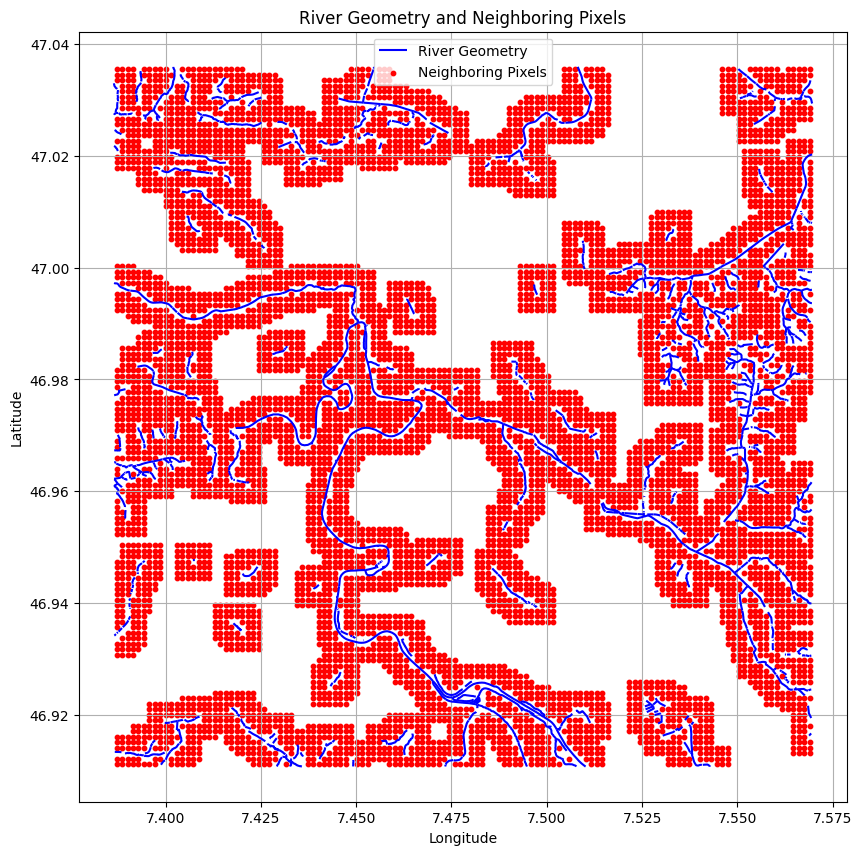


Adjacent Neighbors


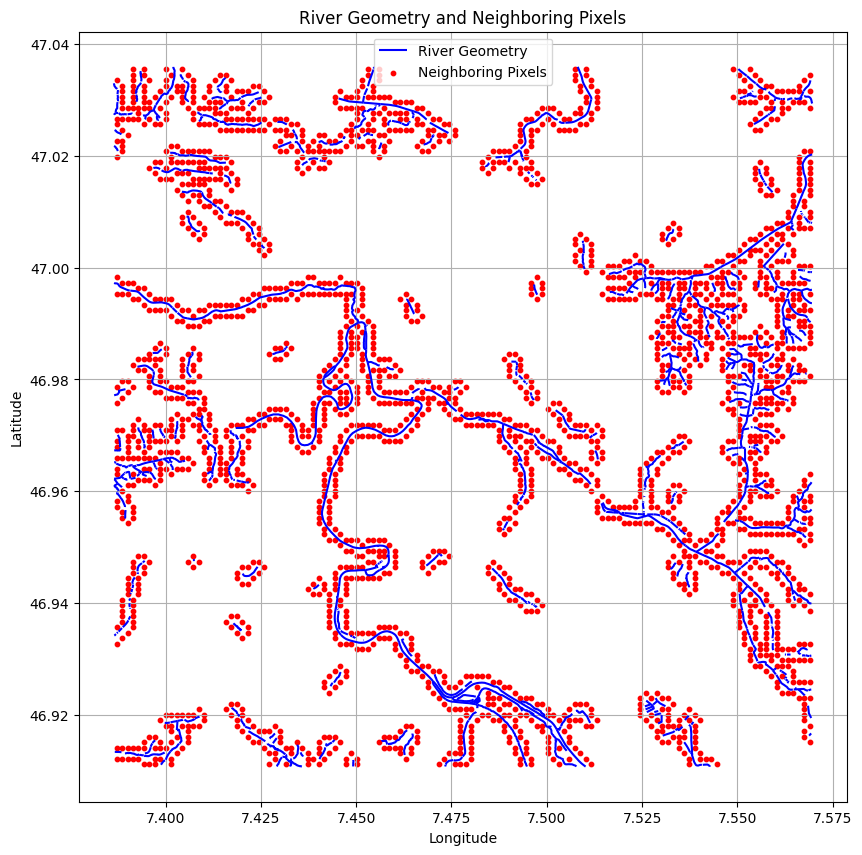

Number of adjacent neighbors: 2019
Number of adjacent neighbors: 2490
Number of adjacent neighbors: 6119
Number of adjacent neighbors: 4508
Number of adjacent neighbors: 2057
Number of adjacent neighbors: 3876
Number of adjacent neighbors: 1949
Number of adjacent neighbors: 5472
Number of adjacent neighbors: 2588
Number of adjacent neighbors: 2952
Number of adjacent neighbors: 4384
Number of adjacent neighbors: 3014
Number of adjacent neighbors: 4361
Number of adjacent neighbors: 3736
Number of adjacent neighbors: 3059
Number of adjacent neighbors: 4193
Number of adjacent neighbors: 2741
Number of adjacent neighbors: 2777
Number of adjacent neighbors: 2145
Number of adjacent neighbors: 3190
Number of adjacent neighbors: 3412
Number of adjacent neighbors: 4479
Number of adjacent neighbors: 4115
Number of adjacent neighbors: 4163
Number of adjacent neighbors: 2955
Number of adjacent neighbors: 5244
Number of adjacent neighbors: 3214
Number of adjacent neighbors: 5239
Number of adjacent n

In [15]:
river_inds = {}
adjacent_neighbors = {}
c=0
for cell, riv in river_cells.items():
    cell_gdf = riv
    x_min, y_min, x_max, y_max = cell_gdf.total_bounds
    target_width, target_height = 128, 128
    transform = from_bounds(x_min, y_min, x_max, y_max, target_width, target_height)
    
    array = rasterize(
    [(geom, 1) for geom in cell_gdf.geometry],
    out_shape=(target_height, target_width),
    transform=transform,
    fill=0,  # Valor para áreas fuera de las geometrías
    dtype="float32"
    )
    river_indices = np.nonzero(array.reshape(-1))[0]
    buffer_size = 3
    height, width = array.shape

    rows, cols = np.unravel_index(river_indices, (height, width)) 

    neighbor_indices = set()
    for row, col in zip(rows, cols):
        for i in range(-buffer_size, buffer_size + 1):
            for j in range(-buffer_size, buffer_size + 1):
                neighbor_row, neighbor_col = row + i, col + j
                
                if 0 <= neighbor_row < height and 0 <= neighbor_col < width:
                    neighbor_index = np.ravel_multi_index((neighbor_row, neighbor_col), (height, width))
                    neighbor_indices.add(neighbor_index)
    
    neighbor_indices = list(neighbor_indices)

    neighbors_around_river = [idx for idx in neighbor_indices if idx not in river_indices]
    
    river_inds[cell] = neighbors_around_river
    
    # Adjacent neighbors
    height, width = array.shape
    
    # Convertir los índices del río (1D) a coordenadas (2D)
    river_rows, river_cols = np.unravel_index(river_indices, (height, width))
    
    # Inicializar un conjunto para guardar vecinos únicos
    adjacent_neighbors = set()
    
    # Direcciones posibles (adyacentes): arriba, abajo, izquierda, derecha
    directions = [(-1, 0), (1, 0), (0, -1), (0, 1)]
    
    # Encontrar vecinos adyacentes
    for row, col in zip(river_rows, river_cols):
        for d_row, d_col in directions:
            neighbor_row, neighbor_col = row + d_row, col + d_col
            
            # Verificar que el vecino esté dentro de los límites del raster
            if 0 <= neighbor_row < height and 0 <= neighbor_col < width:
                # Convertir a índice 1D
                neighbor_index = np.ravel_multi_index((neighbor_row, neighbor_col), (height, width))
                
                # Asegurarse de que no es parte del río
                if neighbor_index not in river_indices:
                    adjacent_neighbors.add(neighbor_index)
    
    # Convertir el conjunto a una lista o array
    adjacent_neighbors = list(adjacent_neighbors)
    
    print(f"Number of adjacent neighbors: {len(adjacent_neighbors)}")

    if c<10:
        print('neighbors')
        plot_neighbors(neighbors_around_river,cell_gdf)
        print('\nAdjacent Neighbors')
        plot_neighbors(adjacent_neighbors,cell_gdf)
    
    c+=1

In [16]:
from scipy.stats import pearsonr
import numpy as np
results = []

start=0
for riv, num in imgs_per_river.items():
    lst_means = []
    ndvi_means = []
    water_temps = []
    for n in range(num):
        lst_mean = np.mean(total_data['lst'][start+n])
        ndvi_mean = np.mean(total_data['ndvi'][start+n])
        water_temp_mean = all_ds['wt'][riv][n]
        print(lst_mean, water_temp_mean)

        lst_means.append(lst_mean)
        ndvi_means.append(ndvi_mean)
        water_temps.append(water_temp_mean)

    start += num
    
    corr_temp_ndvi, _ = pearsonr(lst_means, ndvi_means)
    corr_temp_water, _ = pearsonr(lst_means, water_temps)
    corr_ndvi_water, _ = pearsonr(ndvi_means, water_temps)
    results.append({
        'River': riv,
        'Correlation_LST_NDVI': corr_temp_ndvi,
        'Correlation_LST_WT': corr_temp_water,
        'Correlation_NDVI_WT': corr_ndvi_water
    })
    
results_df = pd.DataFrame(results)

80.46502697219451 12.22
77.94749748582642 5.91
63.59219693702956 10.48
49.77043035129706 11.84
43.84676552563906 7.41
3.2239162096132836 11.78
36.45554864530762 12.02
31.870052829384804 7.56
55.46405052393675 12.43
59.9804412368685 5.73
12.395043367519975 5.24
65.45770875178277 10.74
70.89131831936538 6.34
25.24763515094916 12.63
17.739525347948074 1.44
38.45752109090487 14.46
25.938928872346878 2.44
30.585458238919575 12.43
18.28076335787773 4.0
10.863459597031275 0.86
3.9332338124513626 10.91
50.451298673947655 1.57
9.983496606349945 3.8
43.39498154819012 8.56
7.6371166457732516 5.02
52.04560869932175 1.32
13.63982224961122 2.79
28.593598569432896 9.45
150.0013521015644 2.61
99.4087603588899 10.7
82.26522673169772 8.07
116.7126109401385 10.37
11.091938902934393 9.76
56.7308954000473 1.28
58.19188732902209 12.98
145.88726541399956 9.24
24.603420446316402 4.21
39.28708694378535 2.05
123.5294270614783 2.85
26.80273860692978 13.76
102.37916179498036 3.15
38.404724369446434 1.63
142.21493

In [17]:
from scipy.stats import pearsonr
import numpy as np
results = []
# Iterar sobre los ríos
for a, river in enumerate(np.unique(labels)): 
    # Inicializar listas para guardar las medias y correlaciones
    lst_means = []
    ndvi_means = []
    water_temps = []
    
    # Iterar sobre las fechas (filas)
    for n, (i, row) in enumerate(all_ds['lst'][river].iterrows()):
        # Calcular la media de LST y NDVI para la fecha (asumiendo valores espaciales en cada fila)
        lst_mean = all_ds['lst'][river].loc[i].mean()
        ndvi_mean = all_ds['ndvi'][river].loc[i].mean()
        water_temp = all_ds['wt'][river][n]  # Obtener el único valor de WT para esta fecha
        
        # Guardar las medias para esta fecha
        lst_means.append(lst_mean)
        ndvi_means.append(ndvi_mean)
        water_temps.append(water_temp)
    
    # Calcular las correlaciones finales entre las medias de las fechas
    if len(lst_means) > 1 and len(ndvi_means) > 1:  # Evitar errores si hay pocas fechas
        corr_temp_ndvi, _ = pearsonr(lst_means, ndvi_means)
        corr_temp_water, _ = pearsonr(lst_means, water_temps)
        corr_ndvi_water, _ = pearsonr(ndvi_means, water_temps)
        results.append({
            'River': river,
            'Correlation_LST_NDVI': corr_temp_ndvi,
            'Correlation_LST_WT': corr_temp_water,
            'Correlation_NDVI_WT': corr_ndvi_water
        })
        
    else:
        print(f'River {river} has insufficient data for correlation analysis.')
    results_df = pd.DataFrame(results)

In [18]:
results_df

,River,Correlation_LST_NDVI,Correlation_LST_WT,Correlation_NDVI_WT
0,cell_1,-0.373638,0.172011,0.131082
1,cell_10,-0.047549,0.135617,0.084020
2,cell_11,0.068738,-0.023107,0.036908
3,cell_12,0.223234,-0.194898,-0.418214
4,cell_13,-0.032607,-0.208216,-0.135213
...,...,...,...,...
69,cell_74,0.110866,0.123556,0.091137
70,cell_75,-0.490511,0.352725,-0.241252
71,cell_76,-0.070639,0.318410,-0.299339
72,cell_8,0.223837,-0.354046,0.428680


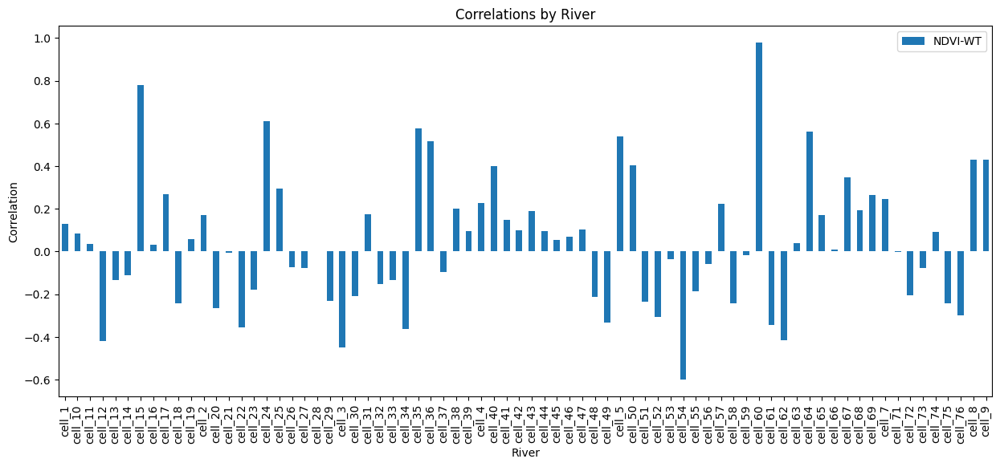

In [19]:
import matplotlib.pyplot as plt

# Gráfico de barras para cada correlación
results_df.plot(
    x='River', 
    y=['Correlation_NDVI_WT'], #'Correlation_LST_NDVI', 'Correlation_LST_WT',
    kind='bar', 
    figsize=(15, 6)
)
plt.title('Correlations by River')
plt.ylabel('Correlation')
plt.xlabel('River')
plt.legend(['NDVI-WT']) # 'LST-NDVI', 'LST-WT',
plt.show()
